In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import copy

In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
print(len(train),len(test))

1460 1459


---

# 使用データの確認

In [3]:
train.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [4]:
test.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64


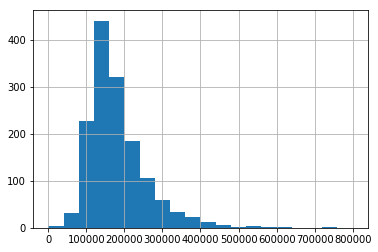

In [5]:
print(train['SalePrice'].describe())
train['SalePrice'].hist(bins=20, range=(0, 800000))

# ログ変換

In [6]:
train["SalePrice"] = np.log1p(train["SalePrice"])

# 欠陥データの確認

In [7]:
df_null_rate_train = pd.DataFrame(train.isnull().sum()/len(train))
df_null_rate_test = pd.DataFrame(test.isnull().sum()/len(test))
df_null_rate = pd.concat([df_null_rate_test[df_null_rate_test.values>0], df_null_rate_train[df_null_rate_train.values>0]], axis=1, sort=False).fillna(0)
df_null_rate.columns = ['test null rate', 'train null rate']
print(df_null_rate.sort_values('test null rate', ascending=False))

              test null rate  train null rate
PoolQC              0.997944         0.995205
MiscFeature         0.965045         0.963014
Alley               0.926662         0.937671
Fence               0.801234         0.807534
FireplaceQu         0.500343         0.472603
LotFrontage         0.155586         0.177397
GarageCond          0.053461         0.055479
GarageYrBlt         0.053461         0.055479
GarageFinish        0.053461         0.055479
GarageQual          0.053461         0.055479
GarageType          0.052090         0.055479
BsmtCond            0.030843         0.025342
BsmtExposure        0.030158         0.026027
BsmtQual            0.030158         0.025342
BsmtFinType2        0.028787         0.026027
BsmtFinType1        0.028787         0.025342
MasVnrType          0.010966         0.005479
MasVnrArea          0.010281         0.005479
MSZoning            0.002742         0.000000
Functional          0.001371         0.000000
BsmtFullBath        0.001371      

0.000685は欠損値1個

PoolQC:プールあるなし、MiscFeature:エレベーター、テニスコート等の施設、Alley: 路地のあるなし?、Fence:フェンスのあるなし、FireplaceQu:暖炉のあるなし、LotFrontage:間口の広さ

---

# 欠陥値の補間

1. ## PoolQC、Alley、MiscFeature 削除

In [8]:
# 最初だし、欠陥値90%以上のPoolQC、Alley、MiscFeatureは使わない
train_new0 = copy.deepcopy(train)
test_new0 = copy.deepcopy(test)

train_new0 = train_new0.drop("PoolQC", axis=1)
train_new0 = train_new0.drop("Alley", axis=1)
train_new0 = train_new0.drop("MiscFeature", axis=1)

test_new0 = test_new0.drop("PoolQC", axis=1)
test_new0 = test_new0.drop("Alley", axis=1)
test_new0 = test_new0.drop("MiscFeature", axis=1)

## Fenceデータ 数値化および欠損値は0

         SalePrice   SalePrice
count  1179.000000  281.000000
mean     12.058605   11.879106
std       0.406170    0.333526
min      10.471978   10.460271
25%      11.796229   11.719948
50%      12.061053   11.860062
75%      12.322526   12.019749
max      13.534474   13.521141 

MnPrv    157
GdPrv     59
GdWo      54
MnWw      11
Name: Fence, dtype: int64 

MnPrv    172
GdPrv     59
GdWo      58
MnWw       1
Name: Fence, dtype: int64


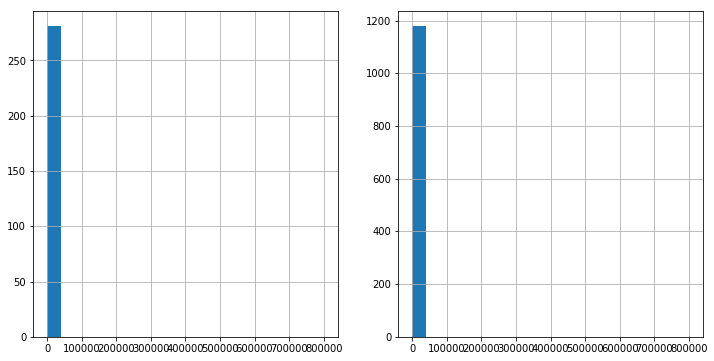

In [9]:
# Fenceのデータチェック
df_fence_yes = train[train['Fence'].isnull()==False]
df_fence_no = train[train['Fence'].isnull()==True]
print(pd.concat([df_fence_no['SalePrice'].describe(),df_fence_yes['SalePrice'].describe()], axis=1, sort=False),"\n")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6),  squeeze=False)
df_fence_no['SalePrice'].hist(bins=20,ax=axes[0, 1],range=(0, 800000))
df_fence_yes['SalePrice'].hist(bins=20,ax=axes[0, 0],range=(0, 800000))
print(train_new0['Fence'].value_counts(),"\n")
print(test_new0['Fence'].value_counts())

In [10]:
# Fenceを五段階評価で置き換え
train_new1 = copy.deepcopy(train_new0)
test_new1 = copy.deepcopy(test_new0)

train_new1['Fence'] = train_new1['Fence'].replace({"GdPrv":4,"MnPrv":3,"GdWo":2,"MnWw":1})
train_new1['Fence'] = train_new1['Fence'].fillna(0)
print(train_new1['Fence'].value_counts(),"\n")

test_new1['Fence'] = test_new1['Fence'].replace({"GdPrv":4,"MnPrv":3,"GdWo":2,"MnWw":1})
test_new1['Fence'] = test_new1['Fence'].fillna(0)
print(test_new1['Fence'].value_counts())


0.0    1179
3.0     157
4.0      59
2.0      54
1.0      11
Name: Fence, dtype: int64 

0.0    1169
3.0     172
4.0      59
2.0      58
1.0       1
Name: Fence, dtype: int64


---

## FireplaceQu 数値化および欠損値は0

        SalePrice   SalePrice
count  690.000000  770.000000
mean    11.808915   12.216847
std      0.323420    0.360918
min     10.460271   11.002117
25%     11.626263   11.976666
50%     11.813037   12.160034
75%     12.009911   12.458293
max     12.744447   13.534474 

Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: FireplaceQu, dtype: int64
Gd    364
TA    279
Fa     41
Po     26
Ex     19
Name: FireplaceQu, dtype: int64


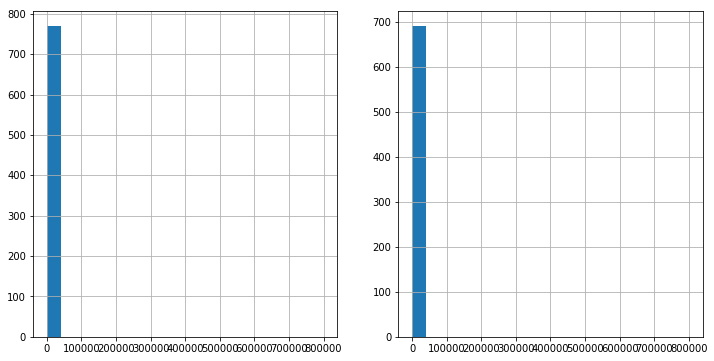

In [11]:
# FireplaceQuのデータチェック
df_FireplaceQu_yes = train[train['FireplaceQu'].isnull()==False]
df_FireplaceQu_no = train[train['FireplaceQu'].isnull()==True]
print(pd.concat([df_FireplaceQu_no['SalePrice'].describe(),df_FireplaceQu_yes['SalePrice'].describe()], axis=1, sort=False),"\n")

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6),  squeeze=False)
df_FireplaceQu_no['SalePrice'].hist(bins=20,ax=axes[0, 1],range=(0, 800000))
df_FireplaceQu_yes['SalePrice'].hist(bins=20,ax=axes[0, 0],range=(0, 800000))
print(train['FireplaceQu'].value_counts())
print(test['FireplaceQu'].value_counts())

In [12]:
# FireplaceQuを6段階評価で置き換え
train_new2 = copy.deepcopy(train_new1)
test_new2 = copy.deepcopy(test_new1)

train_new2['FireplaceQu'] = train_new2['FireplaceQu'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new2['FireplaceQu'] = train_new2['FireplaceQu'].fillna(0)
print(train_new2['FireplaceQu'].value_counts(),"\n")

test_new2['FireplaceQu'] = test_new2['FireplaceQu'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new2['FireplaceQu'] = test_new2['FireplaceQu'].fillna(0)
print(test_new2['FireplaceQu'].value_counts(),"\n")

0.0    690
4.0    380
3.0    313
2.0     33
5.0     24
1.0     20
Name: FireplaceQu, dtype: int64 

0.0    730
4.0    364
3.0    279
2.0     41
1.0     26
5.0     19
Name: FireplaceQu, dtype: int64 



---

## LotFrontage 回帰を使った補間

        SalePrice    SalePrice
count  259.000000  1201.000000
mean    12.062222    12.015827
std      0.308972     0.416042
min     11.018646    10.460271
25%     11.873225    11.755879
50%     12.057578    11.979805
75%     12.278398    12.271397
max     13.053015    13.534474


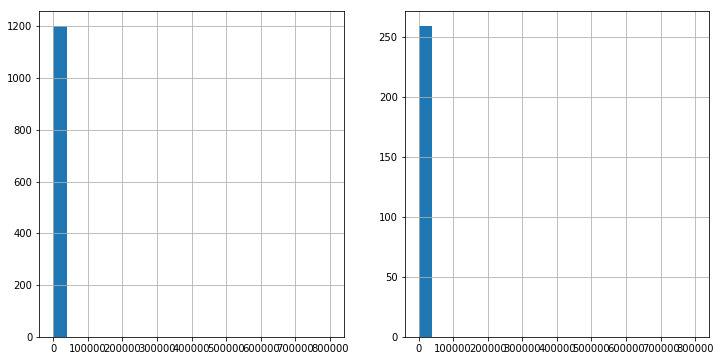

In [13]:
# LotFrontageのデータチェック
df_LotFrontage_yes = train_new2[train_new2['LotFrontage'].isnull()==False]
df_LotFrontage_no = train_new2[train_new2['LotFrontage'].isnull()==True]
print(pd.concat([df_LotFrontage_no['SalePrice'].describe(),df_LotFrontage_yes['SalePrice'].describe()], axis=1, sort=False))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6),  squeeze=False)
df_LotFrontage_no['SalePrice'].hist(bins=20,ax=axes[0, 1],range=(0, 800000))
df_LotFrontage_yes['SalePrice'].hist(bins=20,ax=axes[0, 0],range=(0, 800000))

In [14]:
train_new2.corr()['LotFrontage']

# 相関の高いLotArea、1stFlrSFで穴埋め

Id              -0.010601
MSSubClass      -0.386347
LotFrontage      1.000000
LotArea          0.426095
OverallQual      0.251646
OverallCond     -0.059213
YearBuilt        0.123349
YearRemodAdd     0.088866
MasVnrArea       0.193458
BsmtFinSF1       0.233633
BsmtFinSF2       0.049900
BsmtUnfSF        0.132644
TotalBsmtSF      0.392075
1stFlrSF         0.457181
2ndFlrSF         0.080177
LowQualFinSF     0.038469
GrLivArea        0.402797
BsmtFullBath     0.100949
BsmtHalfBath    -0.007234
FullBath         0.198769
HalfBath         0.053532
BedroomAbvGr     0.263170
KitchenAbvGr    -0.006069
TotRmsAbvGrd     0.352096
Fireplaces       0.266639
FireplaceQu      0.245531
GarageYrBlt      0.070250
GarageCars       0.285691
GarageArea       0.344997
WoodDeckSF       0.088521
OpenPorchSF      0.151972
EnclosedPorch    0.010700
3SsnPorch        0.070029
ScreenPorch      0.041383
PoolArea         0.206167
Fence            0.034139
MiscVal          0.003368
MoSold           0.011200
YrSold      

In [15]:
# 相関の高いLotArea、1stFlrSFで穴埋め
from sklearn import linear_model

train_new3 = copy.deepcopy(train_new2)
test_new3 = copy.deepcopy(test_new2)

train_LotFrontage_x = df_LotFrontage_yes[['LotArea', '1stFlrSF']]
train_LotFrontage_y = df_LotFrontage_yes['LotFrontage']

clf_LotFrontage = linear_model.LinearRegression()
clf_LotFrontage.fit(train_LotFrontage_x,train_LotFrontage_y)

pd.options.mode.chained_assignment = None
for i in range(len(train_new3['LotFrontage'])):
    if train_new3.isnull().iloc[i]['LotFrontage']==True:
        train_new3['LotFrontage'][i] = int(clf_LotFrontage.predict([train_new3.iloc[i][['LotArea', '1stFlrSF']].values]))

for i in range(len(test_new3['LotFrontage'])):
    if test_new3.isnull().iloc[i]['LotFrontage']==True:
        test_new3['LotFrontage'][i] = int(clf_LotFrontage.predict([test_new3.iloc[i][['LotArea', '1stFlrSF']].values]))

---

## GarageQual、GarageCond 数値化および欠損値は0

GGarageYrBlt、GarageFinish、GarageQual、GarageCondのNAはガレージがないことを意味するので0とする 

In [16]:
print(train_new3['GarageCond'].value_counts(),"\n")
print(test_new3['GarageCond'].value_counts(),"\n")
print(train_new3['GarageQual'].value_counts(),"\n")
print(test_new3['GarageQual'].value_counts(),"\n")

TA    1326
Fa      35
Gd       9
Po       7
Ex       2
Name: GarageCond, dtype: int64 

TA    1328
Fa      39
Po       7
Gd       6
Ex       1
Name: GarageCond, dtype: int64 

TA    1311
Fa      48
Gd      14
Po       3
Ex       3
Name: GarageQual, dtype: int64 

TA    1293
Fa      76
Gd      10
Po       2
Name: GarageQual, dtype: int64 



In [17]:
# GarageQual、GarageCondは6段階評価に直す
train_new4 = copy.deepcopy(train_new3)
test_new4 = copy.deepcopy(test_new3)

train_new4['GarageCond'] = train_new4['GarageCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new4['GarageCond'] = train_new4['GarageCond'].fillna(0)
print(train_new4['GarageCond'].value_counts(),"\n")

test_new4['GarageCond'] = test_new4['GarageCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new4['GarageCond'] = test_new4['GarageCond'].fillna(0)
print(test_new4['GarageCond'].value_counts(),"\n")

train_new4['GarageQual'] = train_new4['GarageQual'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new4['GarageQual'] = train_new4['GarageQual'].fillna(0)
print(train_new4['GarageQual'].value_counts(),"\n")

test_new4['GarageQual'] = test_new4['GarageQual'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new4['GarageQual'] = test_new4['GarageQual'].fillna(0)
print(test_new4['GarageQual'].value_counts(),"\n")

3.0    1326
0.0      81
2.0      35
4.0       9
1.0       7
5.0       2
Name: GarageCond, dtype: int64 

3.0    1328
0.0      78
2.0      39
1.0       7
4.0       6
5.0       1
Name: GarageCond, dtype: int64 

3.0    1311
0.0      81
2.0      48
4.0      14
1.0       3
5.0       3
Name: GarageQual, dtype: int64 

3.0    1293
0.0      78
2.0      76
4.0      10
1.0       2
Name: GarageQual, dtype: int64 



---

## GarageFinish 数値化および欠損値は0

In [18]:
print(train_new4['GarageFinish'].value_counts(),"\n")
print(test_new4['GarageFinish'].value_counts(),"\n")

Unf    605
RFn    422
Fin    352
Name: GarageFinish, dtype: int64 

Unf    625
RFn    389
Fin    367
Name: GarageFinish, dtype: int64 



In [19]:
# GarageFinishは4段階評価に直す
train_new5 = copy.deepcopy(train_new4)
test_new5 = copy.deepcopy(test_new4)

train_new5['GarageFinish'] = train_new5['GarageFinish'].replace({"Fin":3,"RFn":2,"Unf":1})
train_new5['GarageFinish'] = train_new5['GarageFinish'].fillna(0)
print(train_new5['GarageFinish'].value_counts(),"\n")

test_new5['GarageFinish'] = test_new5['GarageFinish'].replace({"Fin":3,"RFn":2,"Unf":1})
test_new5['GarageFinish'] = test_new5['GarageFinish'].fillna(0)
print(test_new5['GarageFinish'].value_counts(),"\n")


1.0    605
2.0    422
3.0    352
0.0     81
Name: GarageFinish, dtype: int64 

1.0    625
2.0    389
3.0    367
0.0     78
Name: GarageFinish, dtype: int64 



## GarageYrBlt わからないし、他と相関高いのあるし削除

In [20]:
print(train_new5.corr()['GarageYrBlt'])

# YearBuilt、YearRemodAddと相関高いし削除     
train_new6 = copy.deepcopy(train_new5)
test_new6 = copy.deepcopy(test_new5)

train_new6 = train_new6.drop("GarageYrBlt", axis=1)
test_new6 = test_new6.drop("GarageYrBlt", axis=1)

Id               0.000072
MSSubClass       0.085072
LotFrontage      0.046213
LotArea         -0.024947
OverallQual      0.547766
OverallCond     -0.324297
YearBuilt        0.825667
YearRemodAdd     0.642277
MasVnrArea       0.252691
BsmtFinSF1       0.153484
BsmtFinSF2      -0.088011
BsmtUnfSF        0.190708
TotalBsmtSF      0.322445
1stFlrSF         0.233449
2ndFlrSF         0.070832
LowQualFinSF    -0.036363
GrLivArea        0.231197
BsmtFullBath     0.124553
BsmtHalfBath    -0.077464
FullBath         0.484557
HalfBath         0.196785
BedroomAbvGr    -0.064518
KitchenAbvGr    -0.124411
TotRmsAbvGrd     0.148112
Fireplaces       0.046822
FireplaceQu      0.141497
GarageYrBlt      1.000000
GarageFinish     0.525408
GarageCars       0.588920
GarageArea       0.564567
GarageQual       0.308257
GarageCond       0.262504
WoodDeckSF       0.224577
OpenPorchSF      0.228425
EnclosedPorch   -0.297003
3SsnPorch        0.023544
ScreenPorch     -0.075418
PoolArea        -0.014501
Fence       

---

## GarageArea、GarageCars 欠損値は0

* GarageArea、GarageCarsデータの欠陥は1か所のみ(id:2577)で、他のGarage関連の値もNAとなっているので0とする

In [21]:
train_new7 = copy.deepcopy(train_new6)
test_new7 = copy.deepcopy(test_new6)

train_new7['GarageArea'] = train_new7['GarageArea'].fillna(0)
test_new7['GarageArea'] = test_new7['GarageArea'].fillna(0)
train_new7['GarageCars'] = train_new7['GarageCars'].fillna(0)
test_new7['GarageCars'] = test_new7['GarageCars'].fillna(0)

---

## GarageType　わからないのでとりあえず、最頻値で

In [22]:
train_new8 = copy.deepcopy(train_new7)
test_new8 = copy.deepcopy(test_new7)

train_new8['GarageType'] = train_new8['GarageType'].fillna(train_new8['GarageType'].mode()[0])
test_new8['GarageType'] = test_new8['GarageType'].fillna(train_new8['GarageType'].mode()[0])

---

## BsmQual、BsmCond データの数値化および補間

In [23]:
print(train_new8['BsmtCond'].value_counts(),"\n")
print(test_new8['BsmtCond'].value_counts(),"\n")
print(train_new8['BsmtQual'].value_counts(),"\n")
print(test_new8['BsmtQual'].value_counts(),"\n")

TA    1311
Gd      65
Fa      45
Po       2
Name: BsmtCond, dtype: int64 

TA    1295
Fa      59
Gd      57
Po       3
Name: BsmtCond, dtype: int64 

TA    649
Gd    618
Ex    121
Fa     35
Name: BsmtQual, dtype: int64 

TA    634
Gd    591
Ex    137
Fa     53
Name: BsmtQual, dtype: int64 



In [24]:
# GarageQual、GarageCondは6段階評価に直す
train_new9 = copy.deepcopy(train_new8)
test_new9 = copy.deepcopy(test_new8)

train_new9['BsmtCond'] = train_new9['BsmtCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new9['BsmtCond'] = train_new9['BsmtCond'].fillna(0)
print(train_new9['BsmtCond'].value_counts(),"\n")

test_new9['BsmtCond'] = test_new9['BsmtCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new9['BsmtCond'] = test_new9['BsmtCond'].fillna(0)
print(test_new9['BsmtCond'].value_counts(),"\n")

train_new9['BsmtQual'] = train_new9['BsmtQual'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new9['BsmtQual'] = train_new9['BsmtQual'].fillna(0)
print(train_new9['BsmtQual'].value_counts(),"\n")

test_new9['BsmtQual'] = test_new9['BsmtQual'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new9['BsmtQual'] = test_new9['BsmtQual'].fillna(0)
print(test_new9['BsmtQual'].value_counts(),"\n")

3.0    1311
4.0      65
2.0      45
0.0      37
1.0       2
Name: BsmtCond, dtype: int64 

3.0    1295
2.0      59
4.0      57
0.0      45
1.0       3
Name: BsmtCond, dtype: int64 

3.0    649
4.0    618
5.0    121
0.0     37
2.0     35
Name: BsmtQual, dtype: int64 

3.0    634
4.0    591
5.0    137
2.0     53
0.0     44
Name: BsmtQual, dtype: int64 



---

## BsmtExposure、BsmtFinType1、BsmtFinType2 数値化および補間

In [25]:
print(train_new9['BsmtExposure'].value_counts(),"\n")
print(test_new9['BsmtExposure'].value_counts(),"\n")
print(train_new9['BsmtFinType1'].value_counts(),"\n")
print(test_new9['BsmtFinType1'].value_counts(),"\n")
print(train_new9['BsmtFinType2'].value_counts(),"\n")
print(test_new9['BsmtFinType2'].value_counts(),"\n")

No    953
Av    221
Gd    134
Mn    114
Name: BsmtExposure, dtype: int64 

No    951
Av    197
Gd    142
Mn    125
Name: BsmtExposure, dtype: int64 

Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
Name: BsmtFinType1, dtype: int64 

GLQ    431
Unf    421
ALQ    209
Rec    155
BLQ    121
LwQ     80
Name: BsmtFinType1, dtype: int64 

Unf    1256
Rec      54
LwQ      46
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64 

Unf    1237
Rec      51
LwQ      41
BLQ      35
ALQ      33
GLQ      20
Name: BsmtFinType2, dtype: int64 



In [26]:
# BsmtExposureは5段階評価、BsmtFinType1、BsmtFinType2は7段階評価
train_new10 = copy.deepcopy(train_new9)
test_new10 = copy.deepcopy(test_new9)

train_new10['BsmtExposure'] = train_new10['BsmtExposure'].replace({"Gd":4,"Av":3,"Mn":2,"No":1})
train_new10['BsmtExposure'] = train_new10['BsmtExposure'].fillna(0)
print(train_new10['BsmtExposure'].value_counts(),"\n")

test_new10['BsmtExposure'] = test_new10['BsmtExposure'].replace({"Gd":4,"Av":3,"Mn":2,"No":1})
test_new10['BsmtExposure'] = test_new10['BsmtExposure'].fillna(0)
print(test_new10['BsmtExposure'].value_counts(),"\n")

train_new10['BsmtFinType1'] = train_new10['BsmtFinType1'].replace({"GLQ":6,"ALQ":5,"BLQ":4,"Rec":3,"LwQ":2, "Unf":1})
train_new10['BsmtFinType1'] = train_new10['BsmtFinType1'].fillna(0)
print(train_new10['BsmtFinType1'].value_counts(),"\n")

test_new10['BsmtFinType1'] = test_new10['BsmtFinType1'].replace({"GLQ":6,"ALQ":5,"BLQ":4,"Rec":3,"LwQ":2, "Unf":1})
test_new10['BsmtFinType1'] = test_new10['BsmtFinType1'].fillna(0)
print(test_new10['BsmtFinType1'].value_counts(),"\n")

train_new10['BsmtFinType2'] = train_new10['BsmtFinType2'].replace({"GLQ":6,"ALQ":5,"BLQ":4,"Rec":3,"LwQ":2, "Unf":1})
train_new10['BsmtFinType2'] = train_new10['BsmtFinType2'].fillna(0)
print(train_new10['BsmtFinType2'].value_counts(),"\n")

test_new10['BsmtFinType2'] = test_new10['BsmtFinType2'].replace({"GLQ":6,"ALQ":5,"BLQ":4,"Rec":3,"LwQ":2, "Unf":1})
test_new10['BsmtFinType2'] = test_new10['BsmtFinType2'].fillna(0)
print(test_new10['BsmtFinType2'].value_counts(),"\n")

1.0    953
3.0    221
4.0    134
2.0    114
0.0     38
Name: BsmtExposure, dtype: int64 

1.0    951
3.0    197
4.0    142
2.0    125
0.0     44
Name: BsmtExposure, dtype: int64 

1.0    430
6.0    418
5.0    220
4.0    148
3.0    133
2.0     74
0.0     37
Name: BsmtFinType1, dtype: int64 

6.0    431
1.0    421
5.0    209
3.0    155
4.0    121
2.0     80
0.0     42
Name: BsmtFinType1, dtype: int64 

1.0    1256
3.0      54
2.0      46
0.0      38
4.0      33
5.0      19
6.0      14
Name: BsmtFinType2, dtype: int64 

1.0    1237
3.0      51
0.0      42
2.0      41
4.0      35
5.0      33
6.0      20
Name: BsmtFinType2, dtype: int64 



---

# BsmtFullBath、BsmtHalfBath、BsmtFinSF1、BsmtFinSF2、BsmtUnfSF、TotalBsmtSF 欠陥値は0

地下がないんでしょう

In [27]:
train_new11 = copy.deepcopy(train_new10)
test_new11 = copy.deepcopy(test_new10)

train_new11['BsmtFullBath'] = train_new11['BsmtFullBath'].fillna(0)
test_new11['BsmtFullBath'] = test_new11['BsmtFullBath'].fillna(0)
train_new11['BsmtHalfBath'] = train_new11['BsmtHalfBath'].fillna(0)
test_new11['BsmtHalfBath'] = test_new11['BsmtHalfBath'].fillna(0)
train_new11['BsmtFinSF1'] = train_new11['BsmtFinSF1'].fillna(0)
test_new11['BsmtFinSF1'] = test_new11['BsmtFinSF1'].fillna(0)
train_new11['BsmtFinSF2'] = train_new11['BsmtFinSF2'].fillna(0)
test_new11['BsmtFinSF2'] = test_new11['BsmtFinSF2'].fillna(0)
train_new11['BsmtUnfSF'] = train_new11['BsmtUnfSF'].fillna(0)
test_new11['BsmtUnfSF'] = test_new11['BsmtUnfSF'].fillna(0)
train_new11['TotalBsmtSF'] = train_new11['TotalBsmtSF'].fillna(0)
test_new11['TotalBsmtSF'] = test_new11['TotalBsmtSF'].fillna(0)

---

# MasVnrType、MasVnrArea  

In [28]:
# MasVnrTypeの欠損値はNone、、MasVnrAreaの欠損値は0
train_new12 = copy.deepcopy(train_new11)
test_new12 = copy.deepcopy(test_new11)

train_new12['MasVnrType'] = train_new12['MasVnrType'].fillna("None")
test_new12['MasVnrType'] = test_new12['MasVnrType'].fillna("None")
train_new12['MasVnrArea'] = train_new12['MasVnrArea'].fillna(0)
test_new12['MasVnrArea'] = test_new12['MasVnrArea'].fillna(0)


---

# MSZoning わからないのでとりあえず、最頻値で(欠損1個しかないし)

In [29]:
# BsmtExposureは5段階評価、BsmtFinType1、BsmtFinType2は7段階評価
train_new13 = copy.deepcopy(train_new12)
test_new13 = copy.deepcopy(test_new12)

print(train_new13['MSZoning'].value_counts(),"\n")
print(test_new13['MSZoning'].value_counts(),"\n")

train_new13['MSZoning'] = train_new13['MSZoning'].fillna("RL")
test_new13['MSZoning'] = test_new13['MSZoning'].fillna("RL")

print(train_new13['MSZoning'].value_counts(),"\n")
print(test_new13['MSZoning'].value_counts(),"\n")

RL         1151
RM          218
FV           65
RH           16
C (all)      10
Name: MSZoning, dtype: int64 

RL         1114
RM          242
FV           74
C (all)      15
RH           10
Name: MSZoning, dtype: int64 

RL         1151
RM          218
FV           65
RH           16
C (all)      10
Name: MSZoning, dtype: int64 

RL         1118
RM          242
FV           74
C (all)      15
RH           10
Name: MSZoning, dtype: int64 



---

# Utilities データが偏りすぎているので使わない

In [30]:
train_new14 = copy.deepcopy(train_new13)
test_new14 = copy.deepcopy(test_new13)

print(train_new14['Utilities'].value_counts(),"\n")
print(test_new14['Utilities'].value_counts(),"\n")

train_new14 = train_new14.drop("Utilities", axis=1)
test_new14 = test_new14.drop("Utilities", axis=1)

AllPub    1459
NoSeWa       1
Name: Utilities, dtype: int64 

AllPub    1457
Name: Utilities, dtype: int64 



---

# Functional 最頻値で問題なさそう(欠損1個しかないし)

In [31]:
train_new15 = copy.deepcopy(train_new14)
test_new15 = copy.deepcopy(test_new14)

print(train_new15['Functional'].value_counts(),"\n")
print(test_new15['Functional'].value_counts(),"\n")

train_new15['Functional'] = train_new15['Functional'].fillna("Typ")
test_new15['Functional'] = test_new15['Functional'].fillna("Typ")

print(train_new15['Functional'].value_counts(),"\n")
print(test_new15['Functional'].value_counts(),"\n")

Typ     1360
Min2      34
Min1      31
Mod       15
Maj1      14
Maj2       5
Sev        1
Name: Functional, dtype: int64 

Typ     1357
Min2      36
Min1      34
Mod       20
Maj1       5
Maj2       4
Sev        1
Name: Functional, dtype: int64 

Typ     1360
Min2      34
Min1      31
Mod       15
Maj1      14
Maj2       5
Sev        1
Name: Functional, dtype: int64 

Typ     1359
Min2      36
Min1      34
Mod       20
Maj1       5
Maj2       4
Sev        1
Name: Functional, dtype: int64 



---

# Exterior1st、Exterior2nd わからないのでとりあえず、最頻値で(欠損1個しかないし) 

In [32]:
train_new16 = copy.deepcopy(train_new15)
test_new16 = copy.deepcopy(test_new15)

print(train_new16['Exterior1st'].value_counts(),"\n")
print(test_new16['Exterior1st'].value_counts(),"\n")

train_new16['Exterior1st'] = train_new16['Exterior1st'].fillna("VinylSd")
test_new16['Exterior1st'] = test_new16['Exterior1st'].fillna("VinylSd")

print(train_new16['Exterior1st'].value_counts(),"\n")
print(test_new16['Exterior1st'].value_counts(),"\n")

print(train_new16['Exterior2nd'].value_counts(),"\n")
print(test_new16['Exterior2nd'].value_counts(),"\n")

train_new16['Exterior2nd'] = train_new16['Exterior2nd'].fillna("VinylSd")
test_new16['Exterior2nd'] = test_new16['Exterior2nd'].fillna("VinylSd")

print(train_new16['Exterior2nd'].value_counts(),"\n")
print(test_new16['Exterior2nd'].value_counts(),"\n")


VinylSd    515
HdBoard    222
MetalSd    220
Wd Sdng    206
Plywood    108
CemntBd     61
BrkFace     50
WdShing     26
Stucco      25
AsbShng     20
Stone        2
BrkComm      2
CBlock       1
AsphShn      1
ImStucc      1
Name: Exterior1st, dtype: int64 

VinylSd    510
MetalSd    230
HdBoard    220
Wd Sdng    205
Plywood    113
CemntBd     65
BrkFace     37
WdShing     30
AsbShng     24
Stucco      18
BrkComm      4
CBlock       1
AsphShn      1
Name: Exterior1st, dtype: int64 

VinylSd    515
HdBoard    222
MetalSd    220
Wd Sdng    206
Plywood    108
CemntBd     61
BrkFace     50
WdShing     26
Stucco      25
AsbShng     20
Stone        2
BrkComm      2
CBlock       1
AsphShn      1
ImStucc      1
Name: Exterior1st, dtype: int64 

VinylSd    511
MetalSd    230
HdBoard    220
Wd Sdng    205
Plywood    113
CemntBd     65
BrkFace     37
WdShing     30
AsbShng     24
Stucco      18
BrkComm      4
CBlock       1
AsphShn      1
Name: Exterior1st, dtype: int64 

VinylSd    504
MetalSd  

---

# KitchenQual 最頻値で(欠損1個しかないし)

In [33]:
# kitchenの項目はNAがないので、kitchenがないわけではないので0ではない

train_new17 = copy.deepcopy(train_new16)
test_new17 = copy.deepcopy(test_new16)

print(train_new17['KitchenQual'].value_counts(),"\n")
print(test_new17['KitchenQual'].value_counts(),"\n")

# Poはない
train_new17['KitchenQual'] = train_new17['KitchenQual'].replace({"Ex":4,"Gd":3,"TA":2,"Fa":1})
train_new17['KitchenQual'] = train_new17['KitchenQual'].fillna(2)
test_new17['KitchenQual'] = test_new17['KitchenQual'].replace({"Ex":4,"Gd":3,"TA":2,"Fa":1})
test_new17['KitchenQual'] = test_new17['KitchenQual'].fillna(2)
print(train_new17['KitchenQual'].value_counts(),"\n")
print(test_new17['KitchenQual'].value_counts(),"\n")

TA    735
Gd    586
Ex    100
Fa     39
Name: KitchenQual, dtype: int64 

TA    757
Gd    565
Ex    105
Fa     31
Name: KitchenQual, dtype: int64 

2    735
3    586
4    100
1     39
Name: KitchenQual, dtype: int64 

2.0    758
3.0    565
4.0    105
1.0     31
Name: KitchenQual, dtype: int64 



---

# SaleType 最頻値で(欠損1個しかないし)

In [34]:
train_new18 = copy.deepcopy(train_new17)
test_new18 = copy.deepcopy(test_new17)

print(train_new18['SaleType'].value_counts(),"\n")
print(test_new18['SaleType'].value_counts(),"\n")

train_new18['SaleType'] = train_new16['SaleType'].fillna("WD")
test_new18['SaleType'] = test_new16['SaleType'].fillna("WD")

print(train_new18['SaleType'].value_counts(),"\n")
print(test_new18['SaleType'].value_counts(),"\n")

WD       1267
New       122
COD        43
ConLD       9
ConLw       5
ConLI       5
CWD         4
Oth         3
Con         2
Name: SaleType, dtype: int64 

WD       1258
New       117
COD        44
ConLD      17
CWD         8
Oth         4
ConLI       4
Con         3
ConLw       3
Name: SaleType, dtype: int64 

WD       1267
New       122
COD        43
ConLD       9
ConLw       5
ConLI       5
CWD         4
Oth         3
Con         2
Name: SaleType, dtype: int64 

WD       1259
New       117
COD        44
ConLD      17
CWD         8
Oth         4
ConLI       4
Con         3
ConLw       3
Name: SaleType, dtype: int64 



---

# Electrical 

In [35]:
train_new19 = copy.deepcopy(train_new18)
test_new19 = copy.deepcopy(test_new18)

print(train_new19['Electrical'].value_counts(),"\n")
print(test_new19['Electrical'].value_counts(),"\n")

train_new19['Electrical'] = train_new19['Electrical'].fillna("SBrkr")
test_new19['Electrical'] = test_new19['Electrical'].fillna("SBrkr")

print(train_new19['Electrical'].value_counts(),"\n")
print(test_new19['Electrical'].value_counts(),"\n")

SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64 

SBrkr    1337
FuseA      94
FuseF      23
FuseP       5
Name: Electrical, dtype: int64 

SBrkr    1335
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64 

SBrkr    1337
FuseA      94
FuseF      23
FuseP       5
Name: Electrical, dtype: int64 



---
ここまでの確認

In [36]:
df_null_rate_train2 = pd.DataFrame(train_new19.isnull().sum()/len(train))
df_null_rate_test2 = pd.DataFrame(test_new19.isnull().sum()/len(test))
df_null_rate2 = pd.concat([df_null_rate_test2[df_null_rate_test2.values>0], df_null_rate_train2[df_null_rate_train2.values>0]], axis=1, sort=False).fillna(0)
df_null_rate2.columns = ['test null rate', 'train null rate']
print(df_null_rate2.sort_values('test null rate', ascending=False))

Empty DataFrame
Columns: [test null rate, train null rate]
Index: []


# 欠陥値なし

---

# その他の欠陥なしデータについて

In [37]:
chcek_train = df_null_rate_train[df_null_rate_train[[0]][0]==0].T.columns.tolist()
chcek_test = df_null_rate_train[df_null_rate_train[[0]][0]==0].T.columns.tolist()
check_list = chcek_train + chcek_test
non_NA = [x for x in set(check_list) if check_list.count(x) > 1]
print(sorted(non_NA))

['1stFlrSF', '2ndFlrSF', '3SsnPorch', 'BedroomAbvGr', 'BldgType', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtFullBath', 'BsmtHalfBath', 'BsmtUnfSF', 'CentralAir', 'Condition1', 'Condition2', 'EnclosedPorch', 'ExterCond', 'ExterQual', 'Exterior1st', 'Exterior2nd', 'Fireplaces', 'Foundation', 'FullBath', 'Functional', 'GarageArea', 'GarageCars', 'GrLivArea', 'HalfBath', 'Heating', 'HeatingQC', 'HouseStyle', 'Id', 'KitchenAbvGr', 'KitchenQual', 'LandContour', 'LandSlope', 'LotArea', 'LotConfig', 'LotShape', 'LowQualFinSF', 'MSSubClass', 'MSZoning', 'MiscVal', 'MoSold', 'Neighborhood', 'OpenPorchSF', 'OverallCond', 'OverallQual', 'PavedDrive', 'PoolArea', 'RoofMatl', 'RoofStyle', 'SaleCondition', 'SalePrice', 'SaleType', 'ScreenPorch', 'Street', 'TotRmsAbvGrd', 'TotalBsmtSF', 'Utilities', 'WoodDeckSF', 'YearBuilt', 'YearRemodAdd', 'YrSold']


In [38]:
# print(train_new19['Utilities'].value_counts(),"\n")
print(test_new19['BldgType'].value_counts(),"\n")

1Fam      1205
TwnhsE     113
Duplex      57
Twnhs       53
2fmCon      31
Name: BldgType, dtype: int64 



In [39]:
# そのまま　
# 1stFlrSF、2ndFlrSF、3SsnPorch、BedroomAbvGr、BsmtFinSF1、BsmtFinSF2、BsmtFullBath、BsmtHalfBath、BsmtUnfSF、EnclosedPorch、Exterior1st,FullBath、
# Exterior2nd、Fireplaces、GarageArea、GarageCars、GrLivArea、HalfBath、KitchenAbvGr、KitchenQual、LotArea、LowQualFinSF、MiscVal、MoSold、OpenPorchSF、OverallCond,
# OverallQual、PoolArea、TotRmsAbvGrd、TotalBsmtSF、WoodDeckSF、

In [40]:
# 年度 
# YearBuilt、YearRemodAdd、YrSold

train_new20 = copy.deepcopy(train_new19)
test_new20 = copy.deepcopy(test_new19)

train_new20['YearBuilt'] = train_new20['YearBuilt']- int(train_new20['YearBuilt'].mean())
test_new20['YearBuilt'] = test_new20['YearBuilt']- int(test_new20['YearBuilt'].mean())
train_new20['YearRemodAdd'] = train_new20['YearRemodAdd']- int(train_new20['YearRemodAdd'].mean())
test_new20['YearRemodAdd'] = test_new20['YearRemodAdd']- int(test_new20['YearRemodAdd'].mean())
train_new20['YrSold'] = train_new20['YrSold']- int(train_new20['YrSold'].mean())
test_new20['YrSold'] = test_new20['YrSold']- int(test_new20['YrSold'].mean())


In [41]:
# 文字列(ダミー変数)に変更　BldgType、CentralAir、Condition1、Condition2、Foundation、Functional、Heating、HouseStyle、LandContour、LandSlope、Neighborhood
# LotConfig、LotShape、MSZoning、PavedDrive、RoofMatl、RoofStyle、SaleCondition、SaleType、Street、
# なぜか数値　MSSubClass

train_new21 = copy.deepcopy(train_new20)
test_new21 = copy.deepcopy(test_new20)

dummies_list = ["BldgType","CentralAir","Condition1","Condition2","Foundation","Functional","Heating","HouseStyle","LandContour","LandSlope",
                "Neighborhood","LotConfig","LotShape","MSZoning","PavedDrive","RoofMatl","RoofStyle","SaleCondition","SaleType","Street",
                "Exterior1st", "Exterior2nd", "MasVnrType","Electrical", "GarageType" ]

for name in dummies_list:
    train_new21 = pd.concat([train_new21, pd.get_dummies(train_new21[[name]])], axis=1)
    test_new21 = pd.concat([test_new21, pd.get_dummies(test_new21[[name]])], axis=1)
    train_new21 = train_new21.drop(name, axis=1)
    

train_new21 = pd.concat([train_new21,pd.get_dummies(train_new2[['MSSubClass']].astype(str))], axis=1)
test_new21 = pd.concat([test_new21,pd.get_dummies(test_new2[['MSSubClass']].astype(str))], axis=1)
train_new21 = train_new21.drop('MSSubClass', axis=1)



In [42]:
# 数値に変更ExterCond、ExterQual、HeatingQC、、、
train_new22 = copy.deepcopy(train_new21)
test_new22 = copy.deepcopy(test_new21)

train_new22['ExterCond'] = train_new22['ExterCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new22['ExterCond'] = test_new22['ExterCond'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
train_new22['ExterQual'] = train_new22['ExterQual'].replace({"Ex":4,"Gd":3,"TA":2,"Fa":1})
test_new22['ExterQual'] = test_new22['ExterQual'].replace({"Ex":4,"Gd":3,"TA":2,"Fa":1})
train_new22['HeatingQC'] = train_new22['HeatingQC'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})
test_new22['HeatingQC'] = test_new22['HeatingQC'].replace({"Ex":5,"Gd":4,"TA":3,"Fa":2,"Po":1})

In [43]:
# 削除する　ID
train_new23 = copy.deepcopy(train_new22)
test_new23 = copy.deepcopy(test_new22)

train_new23 = train_new23.drop("Id", axis = 1)
test_new23 = test_new23.drop("Id", axis = 1)

---

In [44]:
train_new24 = copy.deepcopy(train_new23)
test_new24 = copy.deepcopy(test_new23)

y_train = train_new24.SalePrice.values
x_train = train_new24.drop(['SalePrice'], axis=1)

print(len(y_train), x_train.shape)

1460 (1460, 240)


# 前処理終了

---

In [45]:
from sklearn.linear_model import ElasticNet, Lasso,  BayesianRidge, LassoLarsIC
from sklearn.ensemble import RandomForestRegressor,  GradientBoostingRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb
import numpy as np
import optuna

/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d
/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/lightgbm/__init__.py:46: UserWarning: Starting from version 2.2.1, the library file in distribution wheels for macOS is built by the Apple Clang (Xcode_8.3.3) compiler.
This means that in case of installing LightGBM from PyPI via the ``pip install lightgbm`` command, you don't need to install the gcc compiler anymore.
Instead of that, you need to install the OpenMP library, which is required for running LightGBM on the system with the Apple Clang compiler.
You can install the OpenMP library by the following command: ``brew install libomp``.
  "You can install the OpenMP library by the following command: ``bre

In [46]:
def result(model):
    kfold = KFold(n_splits=5, shuffle=True, random_state=0)
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
    
    scores = []
    for score_msq in scores_msq:
        scores.append(np.sqrt(-score_msq))
        
    return scores

---

In [47]:
def objective(trial):
    '''
    trial:set of hyperparameter    
    '''
    # hypyer param
    max_depth = trial.suggest_int('max_depth', 3, 20) # 深すぎると過学習になるかも...
    n_estimators = trial.suggest_int('n_estimators', 50, 10000) # しっかりやるなら100以上
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'auto', 'log2'])
 
    # model
    model = RandomForestRegressor(max_depth=max_depth,
                                  n_estimators=n_estimators,
                                  max_features=max_features,
                                  n_jobs=8,
                                  verbose=1)
 
#     model.fit(X_train_selected.values, Y_train.values)
    scores = result(model)
    score =  np.mean(scores)
    
    return score

In [48]:
study = optuna.create_study()
 
# https://optuna.readthedocs.io/en/stable/reference/study.html#optuna.study.Study.optimize
study.optimize(func=objective, # 実行する関数
               n_trials=5000, # 試行回数
               timeout=None, # 与えられた秒数後に学習を中止します。default=None
               n_jobs=8 # 並列実行するjob数
              )

/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/externals/joblib/parallel.py:547: UserWarning: Multiprocessing-backed parallel loops cannot be nested below threads, setting n_jobs=1
  **self._backend_args)
/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/externals/joblib/parallel.py:547: UserWarning: Multiprocessing-backed parallel loops cannot be nested below threads, setting n_jobs=1
  **self._backend_args)
[W 2019-09-07 13:43:20,574] Setting status of trial#2 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(mode

IndexError: pop from empty list
[W 2019-09-07 13:43:20,685] Setting status of trial#6 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))


IndexError: pop from empty list
[W 2019-09-07 13:43:20,796] Setting status of trial#1 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))


IndexError: pop from empty list
[W 2019-09-07 13:43:21,741] Setting status of trial#10 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:22,331] Setting status of trial#12 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:23,219] Setting status of trial#16 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:23,747] Setting status of trial#18 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:24,474] Setting status of trial#22 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:24,822] Setting status of trial#25 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:25,310] Setting status of trial#28 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:25,930] Setting status of trial#31 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:26,613] Setting status of trial#33 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:27,274] Setting status of trial#35 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:27,980] Setting status of trial#39 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:28,502] Setting status of trial#40 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:29,077] Setting status of trial#45 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:29,725] Setting status of trial#48 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:30,301] Setting status of trial#50 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:31,063] Setting status of trial#54 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:31,736] Setting status of trial#58 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:32,501] Setting status of trial#59 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:33,219] Setting status of trial#64 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:33,977] Setting status of trial#66 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:34,763] Setting status of trial#69 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:35,163] Setting status of trial#73 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:35,928] Setting status of trial#76 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:36,514] Setting status of trial#79 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:37,306] Setting status of trial#81 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:37,876] Setting status of trial#84 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:38,546] Setting status of trial#87 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:39,133] Setting status of trial#91 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:39,842] Setting status of trial#95 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:40,697] Setting status of trial#99 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 13:43:41,314] Setting status of trial#94 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 109 out of 109 | elapsed:    2.8s finished

[W 2019-09-07 13:43:41,735] Setting status of trial#103 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:43:42,172] Setting status of trial#108 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:42,814] Setting status of trial#111 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:43,656] Setting status of trial#112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[W 2019-09-07 13:43:44,335] Setting status of trial#118 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:43:45,110] Setting status of trial#121 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:45,412] Setting status of trial#119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:46,316] Setting status of trial#124 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:43:46,665] Setting status of trial#128 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:43:46,898] Setting status of trial#131 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:47,585] Setting status of trial#134 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:48,706] Setting status of trial#136 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:48,872] Setting status of trial#139 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:49,180] Setting status of trial#142 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:50,221] Setting status of trial#147 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:50,438] Setting status of trial#148 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[W 2019-09-07 13:43:51,050][Parallel(n_jobs=8)]: Done 109 out of 109 | elapsed:    0.4s finished
 Setting status of trial#151 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3

IndexError: pop from empty list
[W 2019-09-07 13:43:51,448] Setting status of trial#152 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:51,949] Setting status of trial#158 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:52,708] Setting status of trial#160 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:53,542] Setting status of trial#163 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s

[W 2019-09-07 13:43:54,029] Setting status of trial#166 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:43:54,463] Setting status of trial#169 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 109 out of 109 | elapsed:    0.5s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:43:55,591] Setting status of trial#176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3

IndexError: pop from empty list
[W 2019-09-07 13:43:55,883] Setting status of trial#177 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:56,411] Setting status of trial#165 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:56,849] Setting status of trial#178 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:57,663] Setting status of trial#184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:58,509] Setting status of trial#181 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:43:59,453] Setting status of trial#190 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.3s
[W 2019-09-07 13:44:00,292] Setting status of trial#193 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:44:00,954] Setting status of trial#196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:01,423] Setting status of trial#197 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:01,965] Setting status of trial#200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:02,828] Setting status of trial#205 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:03,452] Setting status of trial#208 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:04,319] Setting status of trial#211 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:05,025] Setting status of trial#214 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[W 2019-09-07 13:44:05,386] Setting status of trial#217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:44:06,124][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.3s
 Setting status of trial#221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 652 out of 652 | elapsed:    2.0s finished
[W 2019-09-07 13:44:07,030] Setting status of trial#224 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:44:07,728] Setting status of trial#225 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:08,194] Setting status of trial#227 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:08,975] Setting status of trial#232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:09,951] Setting status of trial#237 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:10,387] Setting status of trial#239 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:11,034] Setting status of trial#238 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:11,833] Setting status of trial#244 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:12,588] Setting status of trial#247 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:13,218] Setting status of trial#250 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:13,484] Setting status of trial#254 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:14,300] Setting status of trial#256 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 13:44:15,032] Setting status of trial#262 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  73 out of  73 | elapsed:    0.3s finished

[W 2019-09-07 13:44:15,368] Setting status of trial#264 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 652 out of 652 | elapsed:    1.9s finished
[W 2019-09-07 13:44:16,390] Setting status of trial#267 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:44:16,883] Setting status of trial#269 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:17,533] Setting status of trial#189 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:18,209] Setting status of trial#274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:19,777] Setting status of trial#277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:20,093] Setting status of trial#279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.4s
[W 2019-09-07 13:44:21,275] Setting status of trial#281 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:44:21,470] Setting status of trial#285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:22,364] Setting status of trial#290 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:23,017] Setting status of trial#294 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:23,500] Setting status of trial#295 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:24,686] Setting status of trial#298 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:24,836] Setting status of trial#302 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:25,908] Setting status of trial#305 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:26,516] Setting status of trial#307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:27,142] Setting status of trial#311 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s

[W 2019-09-07 13:44:27,588] Setting status of trial#314 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:44:27,913] Setting status of trial#316 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:29,134] Setting status of trial#319 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:29,943] Setting status of trial#323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:30,394] Setting status of trial#325 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:31,420] Setting status of trial#329 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:31,812] Setting status of trial#331 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:32,762] Setting status of trial#335 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:33,609] Setting status of trial#337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:34,113] Setting status of trial#341 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.4s
[W 2019-09-07 13:44:35,272] Setting status of trial#340 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:44:35,570] Setting status of trial#345 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:36,446] Setting status of trial#349 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:37,151] Setting status of trial#353 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:38,241] Setting status of trial#356 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:38,820] Setting status of trial#358 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:39,535] Setting status of trial#363 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 725 out of 725 | elapsed:   12.2s finished

[W 2019-09-07 13:44:40,204] Setting status of trial#362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 13:44:40,723] Setting status of trial#369 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.4s

[W 2019-09-07 13:44:41,635] Setting status of trial#371 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 725 out of 725 | elapsed:    2.4s finished
[W 2019-09-07 13:44:42,299] Setting status of trial#373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:44:43,242] Setting status of trial#377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:44,197] Setting status of trial#315 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:44,897] Setting status of trial#380 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:45,671] Setting status of trial#384 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:46,390] Setting status of trial#387 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:47,107] Setting status of trial#390 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:48,193] Setting status of trial#391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:48,809] Setting status of trial#397 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:49,327] Setting status of trial#396 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:48,996] Setting status of trial#398 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:50,693] Setting status of trial#405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:51,314] Setting status of trial#409 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:52,113] Setting status of trial#412 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:52,984] Setting status of trial#415 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:53,812] Setting status of trial#417 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:54,875] Setting status of trial#419 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:55,383] Setting status of trial#422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:56,273] Setting status of trial#426 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:57,239] Setting status of trial#431 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:57,890] Setting status of trial#432 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:58,410] Setting status of trial#434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:59,260] Setting status of trial#438 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:44:59,986] Setting status of trial#440 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:00,801] Setting status of trial#442 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:01,511] Setting status of trial#447 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:02,163] Setting status of trial#451 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:02,960] Setting status of trial#453 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:03,477] Setting status of trial#456 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:04,239] Setting status of trial#460 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:05,125] Setting status of trial#462 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:05,894] Setting status of trial#463 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:06,778] Setting status of trial#467 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:07,702] Setting status of trial#471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:08,196] Setting status of trial#474 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:08,658] Setting status of trial#476 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:09,734] Setting status of trial#481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:10,373] Setting status of trial#483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:11,193] Setting status of trial#486 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:11,993] Setting status of trial#490 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:13,356] Setting status of trial#493 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:13,711] Setting status of trial#496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:14,481] Setting status of trial#499 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:15,091] Setting status of trial#502 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:15,837] Setting status of trial#501 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:16,745] Setting status of trial#508 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:17,211] Setting status of trial#510 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:17,814] Setting status of trial#514 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:18,960] Setting status of trial#518 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:19,323] Setting status of trial#519 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:20,221] Setting status of trial#521 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:21,145] Setting status of trial#523 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:21,604] Setting status of trial#528 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:22,515] Setting status of trial#531 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:23,261] Setting status of trial#534 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:24,247] Setting status of trial#539 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:26,001] Setting status of trial#544 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:26,566] Setting status of trial#545 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:28,015] Setting status of trial#549 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:28,242] Setting status of trial#551 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:29,360] Setting status of trial#548 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:30,136] Setting status of trial#555 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:30,648] Setting status of trial#561 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:31,892] Setting status of trial#566 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:32,038] Setting status of trial#565 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:33,347] Setting status of trial#568 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:33,830] Setting status of trial#570 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:35,060] Setting status of trial#574 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:35,457] Setting status of trial#577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:36,524] Setting status of trial#580 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:37,252] Setting status of trial#584 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:37,487] Setting status of trial#587 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:38,621] Setting status of trial#590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:38,826] Setting status of trial#588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:40,085] Setting status of trial#597 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:41,183] Setting status of trial#599 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:41,645] Setting status of trial#601 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:42,306][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.4s
 Setting status of trial#604 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:45:42,764] Setting status of trial#607 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:43,781] Setting status of trial#609 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:44,193] Setting status of trial#614 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:44,945] Setting status of trial#618 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:45,603] Setting status of trial#617 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:46,785] Setting status of trial#623 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:47,654] Setting status of trial#625 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:48,513] Setting status of trial#629 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:49,157] Setting status of trial#633 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:49,840] Setting status of trial#635 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:50,726] Setting status of trial#639 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:51,063] Setting status of trial#641 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:52,206] Setting status of trial#645 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 13:45:52,804] Setting status of trial#647 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:45:53,953] Setting status of trial#652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:54,466] Setting status of trial#653 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:55,652] Setting status of trial#658 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 135 out of 135 | elapsed:    0.5s finished
[W 2019-09-07 13:45:55,895] Setting status of trial#660 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:45:56,884] Setting status of trial#592 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:57,207] Setting status of trial#663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:57,885] Setting status of trial#667 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:58,557] Setting status of trial#670 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:45:59,304] Setting status of trial#673 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:00,164] Setting status of trial#672 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:01,434] Setting status of trial#679 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:02,159] Setting status of trial#682 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:03,164] Setting status of trial#685 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:04,002] Setting status of trial#688 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:05,356] Setting status of trial#691 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:06,300] Setting status of trial#694 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:07,075] Setting status of trial#698 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:08,016] Setting status of trial#700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:08,750] Setting status of trial#703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:09,075] Setting status of trial#706 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:09,952] Setting status of trial#708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 371 out of 371 | elapsed:    6.1s finished
[W 2019-09-07 13:46:11,191] Setting status of trial#711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 371 out of 371 | elapsed:    0.9s finished
[W 2019-09-07 13:46:11,991] Setting status of trial#714 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:46:12,469] Setting status of trial#719 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:13,425] Setting status of trial#721 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:13,972] Setting status of trial#726 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 13:46:15,130] Setting status of trial#728 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:15,709] Setting status of trial#729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 157 out of 157 | elapsed:    3.6s finished

[W 2019-09-07 13:46:16,406] Setting status of trial#707 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 157 out of 157 | elapsed:    0.5s finished
[W 2019-09-07 13:46:16,978] Setting status of trial#736 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 13:46:17,574] Setting status of trial#735 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:18,342] Setting status of trial#742 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:20,206] Setting status of trial#748 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:21,234] Setting status of trial#747 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 195 out of 195 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 195 out of 195 | elapsed:    0.0s finished
[W 2019-09-07 13:46:22,854] Setting status of trial#752 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.3s
[W 2019-09-07 13:46:23,798] Setting status of trial#755 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:24,835] Setting status of trial#759 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:25,509] Setting status of trial#761 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 257 out of 257 | elapsed:    7.4s finished
[W 2019-09-07 13:46:26,867] Setting status of trial#739 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s

[W 2019-09-07 13:46:27,309] Setting status of trial#768 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:27,669] Setting status of trial#770 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:28,469] Setting status of trial#743 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:29,429] Setting status of trial#775 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:30,150] Setting status of trial#778 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:30,973] Setting status of trial#780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:31,638] Setting status of trial#783 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:32,528] Setting status of trial#786 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:33,602] Setting status of trial#789 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:34,300] Setting status of trial#792 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:35,191] Setting status of trial#795 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:35,874] Setting status of trial#796 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:36,226] Setting status of trial#801 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:37,271] Setting status of trial#803 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:38,115] Setting status of trial#805 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:38,746] Setting status of trial#811 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:39,381] Setting status of trial#813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:40,212] Setting status of trial#817 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:41,084] Setting status of trial#819 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:41,844] Setting status of trial#823 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:43,195] Setting status of trial#824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:45,012] Setting status of trial#828 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:45,417] Setting status of trial#829 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:46,819][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.6s
 Setting status of trial#833 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:47,089] Setting status of trial#836 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:48,595] Setting status of trial#843 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:48,932] Setting status of trial#844 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:50,371] Setting status of trial#847 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:51,235] Setting status of trial#852 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:51,636] Setting status of trial#853 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 13:46:52,877] Setting status of trial#858 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:53,856] Setting status of trial#860 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   11.9s
[W 2019-09-07 13:46:54,705] Setting status of trial#864 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 13:46:56,289] Setting status of trial#867 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:46:56,882] Setting status of trial#870 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:58,263] Setting status of trial#874 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:46:59,636] Setting status of trial#877 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:00,351] Setting status of trial#878 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:01,746] Setting status of trial#881 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:03,174][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   20.8s
 Setting status of trial#886 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:04,302] Setting status of trial#889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 362 out of 362 | elapsed:   10.3s finished
[W 2019-09-07 13:47:05,324][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.7s
 Setting status of trial#892 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 13:47:05,729][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.7s
 Setting status of trial#891 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-p

IndexError: pop from empty list
[W 2019-09-07 13:47:06,511] Setting status of trial#897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:07,426] Setting status of trial#821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:07,835] Setting status of trial#862 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:08,732] Setting status of trial#904 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:09,723] Setting status of trial#906 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:11,104] Setting status of trial#911 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:12,462][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
 Setting status of trial#907 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:12,951] Setting status of trial#916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:14,302] Setting status of trial#919 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:14,938] Setting status of trial#921 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:15,629] Setting status of trial#926 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:16,475] Setting status of trial#924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:17,280] Setting status of trial#932 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:18,064] Setting status of trial#936 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:19,191] Setting status of trial#937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:19,833] Setting status of trial#941 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:21,092] Setting status of trial#943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:21,970] Setting status of trial#947 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:23,317] Setting status of trial#950 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 13:47:23,963] Setting status of trial#953 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:25,282] Setting status of trial#958 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:25,831] Setting status of trial#959 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   14.9s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.8s
[W 2019-09-07 13:47:27,350] Setting status of trial#964 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-p

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[W 2019-09-07 13:47:28,377] Setting status of trial#968 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:29,181][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
 Setting status of trial#948 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:30,000] Setting status of trial#970 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:31,435] Setting status of trial#909 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:32,295][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    6.1s
 Setting status of trial#979 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:33,084] Setting status of trial#978 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:34,387] Setting status of trial#984 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:34,476] Setting status of trial#985 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 13:47:36,243] Setting status of trial#991 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 13:47:36,492] Setting status of trial#990 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:37,380] Setting status of trial#960 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:37,920] Setting status of trial#995 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 13:47:38,936] Setting status of trial#1000 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:39,927] Setting status of trial#1003 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:40,750] Setting status of trial#1005 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:42,039] Setting status of trial#1009 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:42,765] Setting status of trial#1012 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:43,603] Setting status of trial#1014 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:44,880] Setting status of trial#1017 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:45,993] Setting status of trial#1021 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:46,559] Setting status of trial#1023 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:47,346] Setting status of trial#1025 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:48,484] Setting status of trial#1029 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:49,216] Setting status of trial#1030 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:50,192] Setting status of trial#1035 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:51,052] Setting status of trial#1039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:52,009] Setting status of trial#1040 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:52,701] Setting status of trial#1044 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:53,831] Setting status of trial#1045 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:54,416] Setting status of trial#1050 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:55,768] Setting status of trial#1053 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:56,609] Setting status of trial#1054 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:57,863] Setting status of trial#1059 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:58,781] Setting status of trial#1062 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:47:59,564] Setting status of trial#1066 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:00,679] Setting status of trial#1063 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:01,173] Setting status of trial#1071 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:02,318] Setting status of trial#1073 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:03,132] Setting status of trial#1075 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:04,418] Setting status of trial#1078 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:05,430] Setting status of trial#1084 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:06,381] Setting status of trial#1086 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:06,894] Setting status of trial#1087 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 13:48:08,349] Setting status of trial#1094 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 102 out of 102 | elapsed:    2.0s finished
[W 2019-09-07 13:48:09,891] Setting status of trial#1096 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:48:10,310] Setting status of trial#1099 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:11,357] Setting status of trial#1103 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:12,306] Setting status of trial#1105 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:14,422] Setting status of trial#1108 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:14,634] Setting status of trial#1092 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:15,652] Setting status of trial#1114 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:17,044] Setting status of trial#1117 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.0s
[W 2019-09-07 13:48:18,021] Setting status of trial#1120 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:48:19,453] Setting status of trial#1125 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:20,497] Setting status of trial#1126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 130 out of 130 | elapsed:    5.0s finished

[W 2019-09-07 13:48:22,217] Setting status of trial#1130 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:48:22,642] Setting status of trial#1131 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:23,588] Setting status of trial#1119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:24,555] Setting status of trial#1138 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:24,977] Setting status of trial#1141 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:26,502] Setting status of trial#1144 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:27,828] Setting status of trial#1146 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:28,311] Setting status of trial#1149 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:29,069] Setting status of trial#1152 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:29,956] Setting status of trial#1155 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:31,315] Setting status of trial#1159 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:32,175] Setting status of trial#1161 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:33,101] Setting status of trial#1165 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:34,302] Setting status of trial#1171 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 393 out of 393 | elapsed:    4.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 13:48:35,991][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
 Setting status of trial#1169 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 13:48:36,706] Setting status of trial#1176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.8s
[W 2019-09-07 13:48:38,368] Setting status of trial#1179 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:48:39,093] Setting status of trial#1183 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:40,033] Setting status of trial#1184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:41,796] Setting status of trial#1188 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:48:42,182] Setting status of trial#1186 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:48:43,258] Setting status of trial#1193 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:44,018] Setting status of trial#1196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:44,697] Setting status of trial#1198 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:45,759] Setting status of trial#1201 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:46,835] Setting status of trial#1203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 13:48:48,758] Setting status of trial#1207 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:48:49,122] Setting status of trial#1212 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:49,920] Setting status of trial#1213 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:52,731][Parallel(n_jobs=8)]: Done 169 out of 169 | elapsed:    2.4s finished
 Setting status of trial#1217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:48:52,968] Setting status of trial#1221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:53,419] Setting status of trial#1216 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:54,291] Setting status of trial#1223 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:56,870] Setting status of trial#1228 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 13:48:57,167] Setting status of trial#1233 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[W 2019-09-07 13:48:57,969] Setting status of trial#1235 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:58,838] Setting status of trial#1237 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:48:59,987] Setting status of trial#1240 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:00,705] Setting status of trial#1241 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:01,687] Setting status of trial#1246 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:02,576] Setting status of trial#1249 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:03,812] Setting status of trial#1252 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:04,541] Setting status of trial#1254 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:05,703] Setting status of trial#1255 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:07,516] Setting status of trial#1260 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:07,977] Setting status of trial#1261 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:08,438] Setting status of trial#1265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:09,447] Setting status of trial#1270 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:10,909] Setting status of trial#1273 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:11,646] Setting status of trial#1274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:12,954] Setting status of trial#1277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:14,430] Setting status of trial#1279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:15,044] Setting status of trial#1285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:16,044] Setting status of trial#1288 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:16,860] Setting status of trial#1290 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:17,644] Setting status of trial#1293 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:18,602] Setting status of trial#1296 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:19,486] Setting status of trial#1299 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:21,457] Setting status of trial#1302 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:22,340] Setting status of trial#1306 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:22,893] Setting status of trial#1308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:23,733] Setting status of trial#1312 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:24,504] Setting status of trial#1315 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:26,587] Setting status of trial#1318 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:27,358] Setting status of trial#1323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:28,735] Setting status of trial#1325 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:29,760] Setting status of trial#1328 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 13:49:31,264] Setting status of trial#1330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 225 out of 225 | elapsed:    1.1s finished

[W 2019-09-07 13:49:31,885] Setting status of trial#1333 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:49:32,678] Setting status of trial#1334 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:33,828] Setting status of trial#1337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:35,514] Setting status of trial#1343 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:35,772] Setting status of trial#1345 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:37,445] Setting status of trial#1349 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:38,373] Setting status of trial#1352 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 13:49:39,962] Setting status of trial#1356 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:49:40,713] Setting status of trial#1355 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:41,388] Setting status of trial#1360 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:43,786] Setting status of trial#1362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:44,375] Setting status of trial#1366 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 225 out of 225 | elapsed:    5.1s finished
[W 2019-09-07 13:49:46,328] Setting status of trial#1369 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 13:49:46,981] Setting status of trial#1371 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:49:47,785] Setting status of trial#1376 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:48,285] Setting status of trial#1377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:51,168] Setting status of trial#1382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:52,235] Setting status of trial#1387 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:52,786] Setting status of trial#1388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[W 2019-09-07 13:49:54,592] Setting status of trial#1385 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:49:55,047] Setting status of trial#1393 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:56,023] Setting status of trial#1314 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:56,963] Setting status of trial#1397 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:58,115] Setting status of trial#1401 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:49:59,103] Setting status of trial#1405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:00,148] Setting status of trial#1407 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:01,148] Setting status of trial#1411 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:02,121] Setting status of trial#1414 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:02,933] Setting status of trial#1416 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:04,165] Setting status of trial#1420 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:05,153] Setting status of trial#1421 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:05,907] Setting status of trial#1424 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:07,272] Setting status of trial#1427 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:07,912] Setting status of trial#1431 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:09,037] Setting status of trial#1434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:11,114] Setting status of trial#1438 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:11,572] Setting status of trial#1439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:12,517] Setting status of trial#1443 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:14,151] Setting status of trial#1445 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:14,750] Setting status of trial#1447 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:16,038] Setting status of trial#1450 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:17,028] Setting status of trial#1454 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 13:50:17,755] Setting status of trial#1459 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:19,367] Setting status of trial#1463 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:20,391] Setting status of trial#1466 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.8s

[W 2019-09-07 13:50:21,612] Setting status of trial#1469 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:22,589] Setting status of trial#1472 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:23,953] Setting status of trial#1476 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:25,357] Setting status of trial#1477 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:26,698] Setting status of trial#1481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:27,877] Setting status of trial#1483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:28,481] Setting status of trial#1486 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[W 2019-09-07 13:50:30,511] Setting status of trial#1489 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 13:50:31,694] Setting status of trial#1492 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:33,352][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#1495 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:34,158] Setting status of trial#1488 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 13:50:35,864] Setting status of trial#1501 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:37,198] Setting status of trial#1505 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:38,258][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
 Setting status of trial#1507 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:39,139] Setting status of trial#1496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:40,330] Setting status of trial#1514 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 13:50:41,311] Setting status of trial#1515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[W 2019-09-07 13:50:43,081][Parallel(n_jobs=8)]: Done 468 out of 468 | elapsed:    2.1s finished
 Setting status of trial#1520 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:50:44,125] Setting status of trial#1522 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:45,951] Setting status of trial#1525 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:46,527] Setting status of trial#1527 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:48,281] Setting status of trial#1530 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:50:49,273] Setting status of trial#1535 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 13:50:51,615] Setting status of trial#1542 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.3s
[W 2019-09-07 13:50:52,328] Setting status of trial#1537 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:50:54,369] Setting status of trial#1544 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 663 out of 663 | elapsed:    4.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 13:50:55,110] Setting status of trial#1547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:50:56,582] Setting status of trial#1550 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[W 2019-09-07 13:50:57,237] Setting status of trial#1553 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i


[W 2019-09-07 13:50:58,357] Setting status of trial#1555 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[W 2019-09-07 13:50:59,391] Setting status of trial#1557 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:00,580] Setting status of trial#1560 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:01,736] Setting status of trial#1564 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:02,904] Setting status of trial#1567 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:03,714] Setting status of trial#1568 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:04,396] Setting status of trial#1573 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:05,972] Setting status of trial#1576 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:07,157] Setting status of trial#1575 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:08,407] Setting status of trial#1582 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:09,690] Setting status of trial#1584 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 119 out of 119 | elapsed:    1.3s finished
[W 2019-09-07 13:51:12,014] Setting status of trial#1590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:51:12,517] Setting status of trial#1588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:14,254] Setting status of trial#1594 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:15,704] Setting status of trial#1595 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:17,006] Setting status of trial#1601 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:18,417] Setting status of trial#1603 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:20,063][Parallel(n_jobs=8)]: Done 172 out of 172 | elapsed:    1.0s finished
 Setting status of trial#1606 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:51:20,884] Setting status of trial#1610 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 172 out of 172 | elapsed:    1.0s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 172 out of 172 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   12.5s
[W 2019-09-07 13:51:23,095] Setting status of trial#1613 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.p

IndexError: pop from empty list
[W 2019-09-07 13:51:23,426] Setting status of trial#1605 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:25,482] Setting status of trial#1617 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:26,697] Setting status of trial#1621 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:28,022] Setting status of trial#1619 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:29,375] Setting status of trial#1627 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 705 out of 705 | elapsed:   19.5s finished
[W 2019-09-07 13:51:30,430] Setting status of trial#1631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:51:32,222] Setting status of trial#1634 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:33,492] Setting status of trial#1637 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:34,946] Setting status of trial#1641 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:35,482] Setting status of trial#1639 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:36,547] Setting status of trial#1645 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:37,612] Setting status of trial#1647 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:39,372] Setting status of trial#1651 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:40,962] Setting status of trial#1654 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:41,776] Setting status of trial#1657 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:42,693] Setting status of trial#1660 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:51:44,550] Setting status of trial#1665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:51:45,718] Setting status of trial#1667 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:45,964] Setting status of trial#1668 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:47,873] Setting status of trial#1671 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:49,297] Setting status of trial#1674 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:50,605] Setting status of trial#1677 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 13:51:52,280][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 244 out of 244 | elapsed:    1.1s finished
 Setting status of trial#1682 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 13:51:52,801] Setting status of trial#1685 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 13:51:54,107] Setting status of trial#1689 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 13:51:55,364] Setting status of trial#1692 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:51:56,426] Setting status of trial#1693 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  93 out of  93 | elapsed:    0.4s finished
[W 2019-09-07 13:51:58,485] Setting status of trial#1697 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:51:59,183] Setting status of trial#1699 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 13:52:00,399] Setting status of trial#1702 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[W 2019-09-07 13:52:01,081] Setting status of trial#1703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:03,414] Setting status of trial#1708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:03,708] Setting status of trial#1712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:05,638] Setting status of trial#1715 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:07,348] Setting status of trial#1719 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:08,690] Setting status of trial#1718 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:09,593] Setting status of trial#1723 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:10,548] Setting status of trial#1724 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:12,643] Setting status of trial#1729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:13,181] Setting status of trial#1731 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.0s
[W 2019-09-07 13:52:14,641] Setting status of trial#1735 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:52:15,704] Setting status of trial#1739 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:17,755] Setting status of trial#1743 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:18,879] Setting status of trial#1745 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:19,936] Setting status of trial#1748 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.2s
[W 2019-09-07 13:52:21,885] Setting status of trial#1747 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.5s
[Parallel(n_jobs=8)]: Done 514 out of 514 | elapsed:    2.9s finished
[W 2019-09-07 13:52:22,895] Setting status of trial#1751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:52:23,795] Setting status of trial#1756 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:24,624] Setting status of trial#1759 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:26,521] Setting status of trial#1761 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:28,219] Setting status of trial#1764 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:28,769] Setting status of trial#1768 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:30,400] Setting status of trial#1769 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:31,413] Setting status of trial#1773 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:33,169] Setting status of trial#1776 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:34,291] Setting status of trial#1778 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:35,507] Setting status of trial#1783 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:36,395] Setting status of trial#1785 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:38,085] Setting status of trial#1788 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:39,670] Setting status of trial#1790 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:40,249] Setting status of trial#1794 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:41,585] Setting status of trial#1796 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:42,732] Setting status of trial#1801 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:44,746] Setting status of trial#1804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:46,226] Setting status of trial#1805 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:47,761] Setting status of trial#1813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:48,740] Setting status of trial#1812 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:50,175][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
 Setting status of trial#1818 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 13:52:51,819] Setting status of trial#1821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:52:52,452] Setting status of trial#1822 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:52:54,166] Setting status of trial#1827 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.3s
[W 2019-09-07 13:52:55,974] Setting status of trial#1824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 232 out of 232 | elapsed:    4.2s finished
[W 2019-09-07 13:52:56,786] Setting status of trial#1831 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 791 out of 791 | elapsed:   15.0s finished

[W 2019-09-07 13:52:58,515] Setting status of trial#1835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 13:52:59,159] Setting status of trial#1838 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.1s
[W 2019-09-07 13:52:59,978] Setting status of trial#1840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 791 out of 791 | elapsed:    3.4s finished
[W 2019-09-07 13:53:01,294] Setting status of trial#1842 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:53:03,116] Setting status of trial#1845 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:03,812] Setting status of trial#1849 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:05,115] Setting status of trial#1852 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:06,807] Setting status of trial#1856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:07,892] Setting status of trial#1859 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:09,062] Setting status of trial#1858 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:10,721] Setting status of trial#1863 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:11,620] Setting status of trial#1861 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:12,901] Setting status of trial#1870 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:13,713] Setting status of trial#1872 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:16,143] Setting status of trial#1877 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.1s
[W 2019-09-07 13:53:17,177] Setting status of trial#1880 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:53:18,652] Setting status of trial#1883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:20,135] Setting status of trial#1884 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 324 out of 324 | elapsed:    6.5s finished
[W 2019-09-07 13:53:20,856] Setting status of trial#1889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 13:53:22,391] Setting status of trial#1891 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:53:23,405] Setting status of trial#1873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:24,916] Setting status of trial#1897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:25,442] Setting status of trial#1899 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:27,307] Setting status of trial#1902 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:28,523] Setting status of trial#1907 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:29,844] Setting status of trial#1908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:31,848] Setting status of trial#1910 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:32,390] Setting status of trial#1914 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:33,715] Setting status of trial#1917 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:35,392] Setting status of trial#1918 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:36,662] Setting status of trial#1923 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:38,011] Setting status of trial#1927 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:39,698] Setting status of trial#1930 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[W 2019-09-07 13:53:41,252] Setting status of trial#1934 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:53:43,364] Setting status of trial#1932 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:45,349] Setting status of trial#1937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:46,247] Setting status of trial#1940 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:48,013] Setting status of trial#1942 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.1s
[W 2019-09-07 13:53:50,570] Setting status of trial#1947 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:53:51,441] Setting status of trial#1953 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:54,190] Setting status of trial#1950 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:54,897] Setting status of trial#1955 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:56,979] Setting status of trial#1960 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:57,922] Setting status of trial#1964 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:53:59,008] Setting status of trial#1963 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:00,708] Setting status of trial#1968 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:01,816] Setting status of trial#1969 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:03,853][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
 Setting status of trial#1977 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:54:04,105] Setting status of trial#1976 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:05,604] Setting status of trial#1981 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:07,141] Setting status of trial#1983 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:08,621] Setting status of trial#1987 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:09,679] Setting status of trial#1990 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:11,142] Setting status of trial#1992 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:12,873] Setting status of trial#1996 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:14,611] Setting status of trial#1999 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:15,953] Setting status of trial#2000 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:17,322] Setting status of trial#2006 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 409 out of 409 | elapsed:    1.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 409 out of 409 | elapsed:    0.6s finished
[W 2019-09-07 13:54:20,465] Setting status of trial#2008 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[W 2019-09-07 13:54:21,431] Setting status of trial#2011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:23,470] Setting status of trial#2016 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   12.3s
[W 2019-09-07 13:54:25,198] Setting status of trial#2019 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:54:28,297] Setting status of trial#2020 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:29,074] Setting status of trial#2024 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.6s
[W 2019-09-07 13:54:31,801] Setting status of trial#2026 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 259 out of 259 | elapsed:    7.6s finished
[W 2019-09-07 13:54:33,798] Setting status of trial#2031 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   21.7s
[W 2019-09-07 13:54:35,390] Setting status of trial#2032 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:54:36,886] Setting status of trial#2035 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:37,990] Setting status of trial#2039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:40,164] Setting status of trial#2041 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:41,183] Setting status of trial#2044 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:43,560] Setting status of trial#2045 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:44,950] Setting status of trial#2051 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1283 out of 1283 | elapsed:   33.8s finished
[W 2019-09-07 13:54:46,463] Setting status of trial#2053 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 13:54:48,240] Setting status of trial#2055 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:49,641] Setting status of trial#2061 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:51,094] Setting status of trial#2063 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:54:53,137][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#1994 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:54:54,125] Setting status of trial#2069 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 13:54:56,619] Setting status of trial#2072 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:54:56,959][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
 Setting status of trial#2075 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 13:54:58,852] Setting status of trial#2080 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 13:55:00,642] Setting status of trial#2082 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 125 out of 125 | elapsed:    0.4s finished
[W 2019-09-07 13:55:01,945] Setting status of trial#2085 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:55:03,046] Setting status of trial#2087 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.8s
[W 2019-09-07 13:55:05,290] Setting status of trial#2091 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:55:07,187] Setting status of trial#2090 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:08,894] Setting status of trial#2092 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:10,436] Setting status of trial#2096 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:12,045] Setting status of trial#2100 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:13,528] Setting status of trial#2105 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:15,529] Setting status of trial#2103 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:16,454] Setting status of trial#2110 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   21.9s
[W 2019-09-07 13:55:19,035] Setting status of trial#2112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 13:55:19,736] Setting status of trial#2116 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1461 out of 1461 | elapsed:   25.2s finished
[W 2019-09-07 13:55:22,327] Setting status of trial#2119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.2s

[W 2019-09-07 13:55:22,826] Setting status of trial#2125 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:55:23,801] Setting status of trial#2126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:24,983] Setting status of trial#2129 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:26,266] Setting status of trial#2131 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 1461 out of 1461 | elapsed:    6.0s finished

[W 2019-09-07 13:55:27,784] Setting status of trial#2132 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 13:55:28,736] Setting status of trial#2071 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:30,216] Setting status of trial#2140 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:31,273] Setting status of trial#2141 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:33,720] Setting status of trial#2143 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:34,279] Setting status of trial#2148 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:36,004] Setting status of trial#2150 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:37,072] Setting status of trial#2154 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:38,634] Setting status of trial#2156 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:40,353] Setting status of trial#2160 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:41,336] Setting status of trial#2164 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:42,710] Setting status of trial#2166 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:45,019] Setting status of trial#2169 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:46,587] Setting status of trial#2173 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:47,724] Setting status of trial#2177 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:49,791] Setting status of trial#2180 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:50,753] Setting status of trial#2182 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:52,191][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.3s
 Setting status of trial#2184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:55:54,385] Setting status of trial#2187 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:55,353] Setting status of trial#2192 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:56,959] Setting status of trial#2196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:57,868] Setting status of trial#2195 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:55:59,533] Setting status of trial#2200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:00,933] Setting status of trial#2203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:02,313] Setting status of trial#2204 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:04,316] Setting status of trial#2208 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 13:56:05,915] Setting status of trial#2212 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[W 2019-09-07 13:56:06,920] Setting status of trial#2216 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.4s
[W 2019-09-07 13:56:09,364] Setting status of trial#2219 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:56:10,082] Setting status of trial#2217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:11,142] Setting status of trial#2224 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 13:56:13,416] Setting status of trial#2228 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:56:14,718] Setting status of trial#2230 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:16,129] Setting status of trial#2232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  72 out of  72 | elapsed:    1.3s finished
[W 2019-09-07 13:56:17,740] Setting status of trial#2236 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 13:56:19,562] Setting status of trial#2241 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.2s
[W 2019-09-07 13:56:21,132] Setting status of trial#2245 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  72 out of  72 | elapsed:    1.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  72 out of  72 | elapsed:    0.3s finished
[W 2019-09-07 13:56:23,169] Setting status of trial#2244 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.3s
[W 2019-09-07 13:56:24,943] Setting status of trial#2251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  72 out of  72 | elapsed:    0.4s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.4s
[W 2019-09-07 13:56:27,111] Setting status of trial#2234 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:56:27,503] Setting status of trial#2255 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:29,270] Setting status of trial#2258 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:30,771] Setting status of trial#2262 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.9s

[W 2019-09-07 13:56:33,024] Setting status of trial#2265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:56:34,087] Setting status of trial#2267 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:35,627] Setting status of trial#2271 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.2s

[W 2019-09-07 13:56:37,112] Setting status of trial#2272 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.6s
[W 2019-09-07 13:56:38,203] Setting status of trial#2275 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:56:39,817] Setting status of trial#2278 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:40,908] Setting status of trial#2279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:43,143] Setting status of trial#2285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 556 out of 556 | elapsed:    9.7s finished
[W 2019-09-07 13:56:44,036] Setting status of trial#2286 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 176 out of 176 | elapsed:    1.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 13:56:46,602] Setting status of trial#2291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:56:47,789] Setting status of trial#2290 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:48,381] Setting status of trial#2293 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:49,537] Setting status of trial#2298 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:52,499] Setting status of trial#2300 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:53,404] Setting status of trial#2304 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:54,938] Setting status of trial#2308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:56,474] Setting status of trial#2310 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:56:58,015] Setting status of trial#2313 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:56:59,290] Setting status of trial#2318 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 13:57:00,983] Setting status of trial#2321 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 13:57:02,381] Setting status of trial#2320 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:57:03,301] Setting status of trial#2326 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:05,001][Parallel(n_jobs=8)]: Done 114 out of 114 | elapsed:    1.8s finished
 Setting status of trial#2329 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:57:06,840] Setting status of trial#2312 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:07,299] Setting status of trial#2332 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:09,326] Setting status of trial#2339 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:10,832] Setting status of trial#2340 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:13,086] Setting status of trial#2346 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
[W 2019-09-07 13:57:15,155] Setting status of trial#2349 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i


[Parallel(n_jobs=8)]: Done 231 out of 231 | elapsed:    0.5s finished
[W 2019-09-07 13:57:17,398] Setting status of trial#2337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    f

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 418 out of 418 | elapsed:    0.8s finished
[W 2019-09-07 13:57:18,405] Setting status of trial#2355 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.0s
[W 2019-09-07 13:57:20,480] Setting status of trial#2357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:57:22,375] Setting status of trial#2361 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:23,212] Setting status of trial#2362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:25,839] Setting status of trial#2365 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 391 out of 391 | elapsed:    1.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 13:57:27,880] Setting status of trial#2369 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 13:57:28,956] Setting status of trial#2372 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 391 out of 391 | elapsed:    1.7s finished
[W 2019-09-07 13:57:31,521] Setting status of trial#2374 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:57:33,419] Setting status of trial#2377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   19.4s
[W 2019-09-07 13:57:35,999] Setting status of trial#2378 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:57:36,929] Setting status of trial#2382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 887 out of 887 | elapsed:   22.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 13:57:39,959] Setting status of trial#2388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.4s
[W 2019-09-07 13:57:40,591] Setting status of trial#2387 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    4.2s
[W 2019-09-07 13:57:42,136] Setting status of trial#2389 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:57:43,414] Setting status of trial#2394 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:45,637] Setting status of trial#2399 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:48,127] Setting status of trial#2398 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:49,821] Setting status of trial#2404 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:52,021] Setting status of trial#2408 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:53,049] Setting status of trial#2410 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:55,019] Setting status of trial#2414 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:57,324] Setting status of trial#2416 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:57:59,025] Setting status of trial#2418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:00,837] Setting status of trial#2422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 887 out of 887 | elapsed:   18.1s finished
[W 2019-09-07 13:58:03,572] Setting status of trial#2425 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 13:58:04,650] Setting status of trial#2429 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.3s
[Parallel(n_jobs=8)]: Done 887 out of 887 | elapsed:    2.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 13:58:06,856] Setting status of trial#2350 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 13:58:08,131] Setting status of trial#2436 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.0s
[W 2019-09-07 13:58:10,577] Setting status of trial#2438 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:58:11,684] Setting status of trial#2441 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:13,878] Setting status of trial#2445 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:15,455] Setting status of trial#2447 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
[W 2019-09-07 13:58:18,264] Setting status of trial#2448 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:58:19,494] Setting status of trial#2453 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 302 out of 302 | elapsed:    1.6s finished
[W 2019-09-07 13:58:21,649] Setting status of trial#2456 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 13:58:24,141] Setting status of trial#2458 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.9s
[W 2019-09-07 13:58:27,496] Setting status of trial#2463 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users

IndexError: pop from empty list
[W 2019-09-07 13:58:28,636] Setting status of trial#2465 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 302 out of 302 | elapsed:    8.7s finished
[W 2019-09-07 13:58:31,314] Setting status of trial#2468 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 13:58:32,350] Setting status of trial#2469 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:58:33,665] Setting status of trial#2474 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:35,568] Setting status of trial#2475 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:37,014] Setting status of trial#2479 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:39,487] Setting status of trial#2483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:40,234] Setting status of trial#2484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:41,721] Setting status of trial#2486 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:44,108] Setting status of trial#2493 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:44,594] Setting status of trial#2491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:46,544] Setting status of trial#2497 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:47,769] Setting status of trial#2499 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:49,866] Setting status of trial#2505 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:51,200] Setting status of trial#2506 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:52,358] Setting status of trial#2509 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:54,845] Setting status of trial#2507 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:56,198] Setting status of trial#2516 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:58:57,712] Setting status of trial#2515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:00,469] Setting status of trial#2521 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:00,614] Setting status of trial#2524 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:02,282] Setting status of trial#2527 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:04,539] Setting status of trial#2529 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:05,739] Setting status of trial#2533 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:07,592] Setting status of trial#2536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:09,569] Setting status of trial#2537 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:11,134] Setting status of trial#2542 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:12,490] Setting status of trial#2544 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:14,633] Setting status of trial#2547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:16,001] Setting status of trial#2550 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:18,157] Setting status of trial#2553 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:18,926] Setting status of trial#2554 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:20,601] Setting status of trial#2559 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:22,797] Setting status of trial#2563 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:24,925] Setting status of trial#2565 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:27,080] Setting status of trial#2570 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:29,333] Setting status of trial#2571 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:31,408] Setting status of trial#2578 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:32,220] Setting status of trial#2577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   11.1s

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    1.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 13:59:35,197] Setting status of trial#2582 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7

IndexError: pop from empty list
[W 2019-09-07 13:59:35,719] Setting status of trial#2583 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 13:59:38,414][Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    0.3s finished
 Setting status of trial#2588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    0.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    0.1s finished
[W 2019-09-07 13:59:40,613] Setting status of trial#2590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.p

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[Parallel(n_jobs=8)]: Done 209 out of 209 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 13:59:42,370] Setting status of trial#2596 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   21.7s
[W 2019-09-07 13:59:44,202] Setting status of trial#2598 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 13:59:48,177] Setting status of trial#2601 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:49,238] Setting status of trial#2603 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:51,977] Setting status of trial#2607 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:53,545] Setting status of trial#2609 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 13:59:55,898] Setting status of trial#2613 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 1450 out of 1450 | elapsed:   36.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.3s
[W 2019-09-07 13:59:59,683] Setting status of trial#2619 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 112 out of 112 | elapsed:    3.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:00:00,886][Parallel(n_jobs=8)]: Done 112 out of 112 | elapsed:    0.3s finished
 Setting status of trial#2618 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 112 out of 112 | elapsed:    2.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 112 out of 112 | elapsed:    0.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:00:06,708] Setting status of trial#2624 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 112 out of 112 | elapsed:    0.0s finished
[W 2019-09-07 14:00:08,015] Setting status of trial#2614 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:00:11,899] Setting status of trial#2628 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:13,218] Setting status of trial#2631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:00:16,765] Setting status of trial#2632 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:00:18,624] Setting status of trial#2636 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:21,231] Setting status of trial#2639 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:22,723] Setting status of trial#2640 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:24,771] Setting status of trial#2645 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   30.0s
[W 2019-09-07 14:00:27,660] Setting status of trial#2649 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:00:29,040] Setting status of trial#2651 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:31,472] Setting status of trial#2652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:33,046] Setting status of trial#2655 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:00:35,655] Setting status of trial#2659 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:00:35,908] Setting status of trial#2663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:38,107] Setting status of trial#2665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:40,314] Setting status of trial#2670 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:41,980][Parallel(n_jobs=8)]: Done 1513 out of 1513 | elapsed:    7.2s finished
 Setting status of trial#2674 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:00:42,853] Setting status of trial#2611 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:45,153] Setting status of trial#2678 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:46,771] Setting status of trial#2681 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:00:48,641] Setting status of trial#2686 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.2s
[W 2019-09-07 14:00:50,268] Setting status of trial#2688 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    0.7s finished
[W 2019-09-07 14:00:52,133] Setting status of trial#2692 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:00:52,553] Setting status of trial#2684 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:54,523] Setting status of trial#2696 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:00:56,865] Setting status of trial#2701 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   16.8s
[W 2019-09-07 14:00:58,070] Setting status of trial#2700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:01:00,057] Setting status of trial#2704 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:01,144] Setting status of trial#2708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:03,123] Setting status of trial#2711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:05,394] Setting status of trial#2717 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:07,283] Setting status of trial#2720 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:09,053] Setting status of trial#2722 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 219 out of 219 | elapsed:    1.0s finished
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.5s
[W 2019-09-07 14:01:11,443] Setting status of trial#2712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    3.8s
[Parallel(n_jobs=8)]: Done 1251 out of 1251 | elapsed:    4.0s finished
[W 2019-09-07 14:01:12,297] Setting status of trial#2728 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:01:14,031] Setting status of trial#2729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:01:15,641] Setting status of trial#2731 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:17,057] Setting status of trial#2713 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:18,439] Setting status of trial#2737 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:21,231] Setting status of trial#2740 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:22,322] Setting status of trial#2743 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:24,171] Setting status of trial#2748 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:26,610] Setting status of trial#2751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:28,296] Setting status of trial#2752 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:29,788] Setting status of trial#2750 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.4s
[W 2019-09-07 14:01:31,908] Setting status of trial#2759 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:01:33,629] Setting status of trial#2762 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.9s
[W 2019-09-07 14:01:35,766] Setting status of trial#2765 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:01:37,062] Setting status of trial#2768 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:39,188] Setting status of trial#2770 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.7s
[W 2019-09-07 14:01:40,622] Setting status of trial#2775 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s

[W 2019-09-07 14:01:42,766] Setting status of trial#2776 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:01:43,783] Setting status of trial#2756 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:45,279] Setting status of trial#2780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:47,504] Setting status of trial#2786 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:48,674] Setting status of trial#2789 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:51,476] Setting status of trial#2792 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:52,857] Setting status of trial#2794 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:01:54,760] Setting status of trial#2799 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.1s
[W 2019-09-07 14:01:57,306][Parallel(n_jobs=8)]: Done 438 out of 438 | elapsed:    2.0s finished
 Setting status of trial#2804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 14:01:58,038] Setting status of trial#2785 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:02:00,199] Setting status of trial#2808 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:02:01,909] Setting status of trial#2810 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:03,604][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
 Setting status of trial#2815 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:02:06,409] Setting status of trial#2818 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:07,812] Setting status of trial#2821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:09,718] Setting status of trial#2823 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.0s
[W 2019-09-07 14:02:12,360] Setting status of trial#2827 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 14:02:13,928] Setting status of trial#2829 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:02:16,103] Setting status of trial#2807 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 696 out of 696 | elapsed:   14.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.8s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[W 2019-09-07 14:02:18,617] Setting status of trial#2836 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7

IndexError: pop from empty list
[W 2019-09-07 14:02:19,516] Setting status of trial#2838 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 14:02:22,471] Setting status of trial#2843 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 264 out of 264 | elapsed:    4.0s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.9s
[W 2019-09-07 14:02:24,588][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
 Setting status of trial#2847 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 14:02:25,975] Setting status of trial#2849 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[W 2019-09-07 14:02:29,306] Setting status of trial#2852 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:02:31,222] Setting status of trial#2840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:33,532] Setting status of trial#2857 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:35,090] Setting status of trial#2859 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 14:02:37,514][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
 Setting status of trial#2861 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.9s

[Parallel(n_jobs=8)]: Done 796 out of 796 | elapsed:    3.1s finished
[W 2019-09-07 14:02:38,907] Setting status of trial#2867 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:02:40,510] Setting status of trial#2813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   14.1s
[W 2019-09-07 14:02:42,312] Setting status of trial#2869 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:02:43,738] Setting status of trial#2871 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:45,808] Setting status of trial#2877 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:47,310] Setting status of trial#2880 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:02:49,214] Setting status of trial#2883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   22.3s
[W 2019-09-07 14:02:50,548] Setting status of trial#2885 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:02:52,796] Setting status of trial#2890 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s

[W 2019-09-07 14:02:54,102] Setting status of trial#2891 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:02:56,963][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.7s
 Setting status of trial#2896 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.2s
[W 2019-09-07 14:02:58,657] Setting status of trial#2897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:02:59,867] Setting status of trial#2850 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:02,448] Setting status of trial#2904 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 275 out of 275 | elapsed:    1.0s finished
[W 2019-09-07 14:03:04,376] Setting status of trial#2909 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:03:06,192] Setting status of trial#2910 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:03:08,073] Setting status of trial#2915 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:09,843] Setting status of trial#2916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 14:03:12,149][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
 Setting status of trial#2914 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train,

IndexError: pop from empty list
[W 2019-09-07 14:03:13,423] Setting status of trial#2920 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:16,256] Setting status of trial#2925 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.1s
[W 2019-09-07 14:03:17,547] Setting status of trial#2929 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1144 out of 1144 | elapsed:   18.1s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[W 2019-09-07 14:03:20,535][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.9s
 Setting status of trial#2932 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3,

IndexError: pop from empty list
[W 2019-09-07 14:03:21,543][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
 Setting status of trial#2936 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    6.0s
[Parallel(n_jobs=8)]: Done 275 out of 275 | elapsed:    0.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 275 out of 275 | elapsed:    0.3s finished
[W 2019-09-07 14:03:24,764] Setting status of trial#2940 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_t

IndexError: pop from empty list
[W 2019-09-07 14:03:25,567] Setting status of trial#2939 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:28,751] Setting status of trial#2944 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:30,305][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
 Setting status of trial#2942 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 438 out of 438 | elapsed:    2.3s finished
[W 2019-09-07 14:03:32,504] Setting status of trial#2946 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:03:33,588] Setting status of trial#2930 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:36,188] Setting status of trial#2954 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:38,233] Setting status of trial#2957 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:39,021] Setting status of trial#2961 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:41,262] Setting status of trial#2964 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:43,910] Setting status of trial#2966 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:44,595] Setting status of trial#2970 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:47,706] Setting status of trial#2974 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:48,704] Setting status of trial#2972 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 14:03:52,473] Setting status of trial#2980 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s

[Parallel(n_jobs=8)]: Done 490 out of 490 | elapsed:    0.3s finished
[W 2019-09-07 14:03:54,148] Setting status of trial#2979 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:03:56,102] Setting status of trial#2985 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:03:58,551] Setting status of trial#2987 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:00,628] Setting status of trial#2991 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:03,443] Setting status of trial#2992 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:04,885][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
 Setting status of trial#2999 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[W 2019-09-07 14:04:09,596][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
 Setting status of trial#3003 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 205 out of 205 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 205 out of 205 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 205 out of 205 | elapsed:    0.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 205 out of 205 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.0s
[Parallel(n_jobs=8)]: Done 1167 out of 1167 | elapsed:   25.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[Paral

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[W 2019-09-07 14:04:14,989] Setting status of trial#3007 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:04:16,554] Setting status of trial#3011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:20,807] Setting status of trial#3014 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:21,639] Setting status of trial#3016 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:23,877] Setting status of trial#3018 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:26,507] Setting status of trial#3019 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:28,891] Setting status of trial#3024 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:31,184] Setting status of trial#3029 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:33,984] Setting status of trial#3030 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:35,751] Setting status of trial#3036 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:04:38,718] Setting status of trial#3039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:04:40,808][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.1s
 Setting status of trial#3040 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:04:42,479] Setting status of trial#3043 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:44,865][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#3049 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.9s
[W 2019-09-07 14:04:48,509] Setting status of trial#3050 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s

[W 2019-09-07 14:04:49,413] Setting status of trial#3051 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:04:51,608] Setting status of trial#3054 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:54,165] Setting status of trial#3058 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:04:55,982] Setting status of trial#3059 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[Parallel(n_jobs=8)]: Done 583 out of 583 | elapsed:   15.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:04:58,908] Setting status of trial#3064 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[Parallel(n_jobs=8)]: Done 583 out of 583 | elapsed:    2.5s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:05:01,627] Setting status of trial#3069 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 530 out of 530 | elapsed:    2.6s finished
[W 2019-09-07 14:05:02,226] Setting status of trial#3070 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:05:03,802] Setting status of trial#3062 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:05,904] Setting status of trial#3076 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:08,413] Setting status of trial#3078 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:10,328] Setting status of trial#3080 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:12,076] Setting status of trial#3084 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:14,785] Setting status of trial#3086 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:15,811] Setting status of trial#3089 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.2s
[W 2019-09-07 14:05:18,954] Setting status of trial#3096 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:05:20,908] Setting status of trial#3097 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:22,926] Setting status of trial#3101 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:25,672] Setting status of trial#3103 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:27,728] Setting status of trial#3106 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:30,615] Setting status of trial#3108 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:32,046] Setting status of trial#3112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:33,892] Setting status of trial#3115 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:36,728] Setting status of trial#3120 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 333 out of 333 | elapsed:    1.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 333 out of 333 | elapsed:    0.2s finished
[W 2019-09-07 14:05:40,423] Setting status of trial#3122 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[W 2019-09-07 14:05:40,892] Setting status of trial#3123 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   24.6s
[Parallel(n_jobs=8)]: Done 1293 out of 1293 | elapsed:   25.7s finished
[W 2019-09-07 14:05:43,479] Setting status of trial#3128 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[W 2019-09-07 14:05:44,815] Setting status of trial#3132 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:46,322] Setting status of trial#3133 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:48,464] Setting status of trial#3137 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:51,250] Setting status of trial#3138 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:51,877] Setting status of trial#3140 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:54,341] Setting status of trial#3144 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:55,998] Setting status of trial#3147 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:05:58,846] Setting status of trial#3146 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:00,453] Setting status of trial#3154 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:02,681] Setting status of trial#3155 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:04,028] Setting status of trial#3160 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:06,520] Setting status of trial#3162 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:08,773] Setting status of trial#3165 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 592 out of 592 | elapsed:    1.3s finished
[W 2019-09-07 14:06:10,529] Setting status of trial#3171 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 196 out of 196 | elapsed:    3.5s finished
[W 2019-09-07 14:06:12,673] Setting status of trial#3173 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:06:14,958] Setting status of trial#3175 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:16,454] Setting status of trial#3176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:18,986] Setting status of trial#3180 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:06:21,863] Setting status of trial#3186 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:06:23,943] Setting status of trial#3189 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:26,439] Setting status of trial#3192 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:28,453] Setting status of trial#3191 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:30,249] Setting status of trial#3197 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:33,648] Setting status of trial#3200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:34,752] Setting status of trial#3202 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:37,229] Setting status of trial#3206 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:38,115] Setting status of trial#3208 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:40,679] Setting status of trial#3210 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:42,358] Setting status of trial#3214 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:45,306] Setting status of trial#3215 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[W 2019-09-07 14:06:46,886] Setting status of trial#3221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:06:48,763] Setting status of trial#3222 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:06:50,643] Setting status of trial#3227 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[W 2019-09-07 14:06:53,186] Setting status of trial#3229 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:06:54,781][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
 Setting status of trial#3232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.6s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:06:58,049] Setting status of trial#3237 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  79 out of  79 | elapsed:    0.5s finished

[W 2019-09-07 14:06:59,833] Setting status of trial#3240 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:07:01,584] Setting status of trial#3241 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:07:03,375] Setting status of trial#3244 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.5s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.8s
[W 2019-09-07 14:07:05,157] Setting status of trial#3249 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  79 out of  79 | elapsed:    0.3s finished
[W 2019-09-07 14:07:07,108] Setting status of trial#3236 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 563 out of 563 | elapsed:   13.1s finished
[W 2019-09-07 14:07:09,125] Setting status of trial#3251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:07:10,833] Setting status of trial#3256 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 563 out of 563 | elapsed:    2.6s finished
[W 2019-09-07 14:07:12,579] Setting status of trial#3233 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:07:14,609] Setting status of trial#3262 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    4.9s finished
[W 2019-09-07 14:07:16,736] Setting status of trial#3264 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:07:18,978] Setting status of trial#3268 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  59 out of  59 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  59 out of  59 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done 139 out of 139 | elapsed:    3.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:07:22,332] Setting status of trial#3274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(m

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    1.0s finished
[W 2019-09-07 14:07:23,817] Setting status of trial#3275 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:07:26,103] Setting status of trial#3279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:07:27,702] Setting status of trial#3280 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:30,613] Setting status of trial#3287 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[I 2019-09-07 14:07:30,980] Finished trial#3272 resulted in value: 0.14347629072392143. Current best value is 0.14140845996391213 with parameters: {'max_depth': 13, 'n_estimators': 209, 'max_features': 'sqrt'}.
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.1s
[W 2019-09-07 14:07:32,573] Setting status of trial#3285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_va

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 290 out of 290 | elapsed:    6.7s finished
[W 2019-09-07 14:07:34,379] Setting status of trial#3290 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:07:35,882] Setting status of trial#3293 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 406 out of 406 | elapsed:    3.9s finished
[W 2019-09-07 14:07:38,289] Setting status of trial#3297 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:07:39,917] Setting status of trial#3300 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:07:41,117] Setting status of trial#3289 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:43,973] Setting status of trial#3304 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:46,414] Setting status of trial#3307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 14:07:48,957] Setting status of trial#3313 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.5s
[W 2019-09-07 14:07:50,656] Setting status of trial#3315 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 306 out of 306 | elapsed:    4.8s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:07:52,911] Setting status of trial#3318 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:07:54,255] Setting status of trial#3308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:56,167] Setting status of trial#3323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:57,812] Setting status of trial#3327 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:07:59,790] Setting status of trial#3329 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:01,803] Setting status of trial#3332 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:03,323] Setting status of trial#3331 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:05,353] Setting status of trial#3337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:07,243] Setting status of trial#3341 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:10,300] Setting status of trial#3344 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:11,359] Setting status of trial#3347 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   24.8s
[Parallel(n_jobs=8)]: Done 1550 out of 1550 | elapsed:   25.4s finished
[W 2019-09-07 14:08:14,895] Setting status of trial#3351 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  F

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    1.4s
[W 2019-09-07 14:08:16,340] Setting status of trial#3352 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 218 out of 218 | elapsed:    5.6s finished
[W 2019-09-07 14:08:18,753] Setting status of trial#3356 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:08:21,237] Setting status of trial#3359 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:21,628] Setting status of trial#3362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:24,509] Setting status of trial#3365 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:27,600] Setting status of trial#3370 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:29,258] Setting status of trial#3373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 206 out of 206 | elapsed:    5.4s finished
[W 2019-09-07 14:08:32,367] Setting status of trial#3377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:08:33,774] Setting status of trial#3367 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:35,884] Setting status of trial#3382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:37,907] Setting status of trial#3385 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:39,796] Setting status of trial#3387 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.5s
[W 2019-09-07 14:08:42,454] Setting status of trial#3390 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:08:44,085] Setting status of trial#3393 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:46,173] Setting status of trial#3396 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   23.0s
[W 2019-09-07 14:08:48,536] Setting status of trial#3400 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:08:50,633] Setting status of trial#3402 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:53,504] Setting status of trial#3403 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:54,520] Setting status of trial#3408 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:57,133] Setting status of trial#3410 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:08:59,632] Setting status of trial#3414 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:01,216] Setting status of trial#3418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:03,636] Setting status of trial#3422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:06,654] Setting status of trial#3425 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:07,272] Setting status of trial#3424 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:10,220] Setting status of trial#3429 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:12,239] Setting status of trial#3430 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:14,564] Setting status of trial#3434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:16,475] Setting status of trial#3439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[W 2019-09-07 14:09:18,792] Setting status of trial#3438 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:09:20,869] Setting status of trial#3442 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.5s

[W 2019-09-07 14:09:22,954] Setting status of trial#3446 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 


[W 2019-09-07 14:09:25,834] Setting status of trial#3453 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2847 out of 2847 | elapsed:    9.7s finished
[W 2019-09-07 14:09:28,507] Setting status of trial#3454 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.6s
[W 2019-09-07 14:09:30,537] Setting status of trial#3458 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s

[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 360 out of 360 | elapsed:    1.3s finished
[W 2019-09-07 14:09:33,604] Setting status of trial#3448 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 14:09:34,913] Setting status of trial#3463 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:37,619] Setting status of trial#3466 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:09:39,861] Setting status of trial#3470 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:09:42,543] Setting status of trial#3473 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train,

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   12.7s
[W 2019-09-07 14:09:44,459] Setting status of trial#3474 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.0s
[W 2019-09-07 14:09:47,793] Setting status of trial#3480 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    4.3s
[W 2019-09-07 14:09:50,497] Setting status of trial#3481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:   20.0s
[W 2019-09-07 14:09:52,224] Setting status of trial#3483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:09:54,606] Setting status of trial#3487 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:09:57,790][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
 Setting status of trial#3491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   19.4s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    2.8s
[W 2019-09-07 14:10:00,443] Setting status of trial#3490 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/sit

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   14.1s
[W 2019-09-07 14:10:02,250] Setting status of trial#3496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 


[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    2.0s
[W 2019-09-07 14:10:05,082] Setting status of trial#3499 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train

IndexError: pop from empty list
[W 2019-09-07 14:10:06,079] Setting status of trial#3500 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.6s
[W 2019-09-07 14:10:09,863] Setting status of trial#3502 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.0s
[W 2019-09-07 14:10:12,788] Setting status of trial#3508 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    5.9s
[W 2019-09-07 14:10:15,183] Setting status of trial#3512 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 14:10:17,832] Setting status of trial#3515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:10:19,012] Setting status of trial#3517 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:10:22,170] Setting status of trial#3519 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:10:24,638][Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    7.9s
 Setting status of trial#3523 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site

IndexError: pop from empty list
[W 2019-09-07 14:10:26,145] Setting status of trial#3526 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:10:29,248] Setting status of trial#3528 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.3s
[W 2019-09-07 14:10:31,377] Setting status of trial#3533 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:10:33,739] Setting status of trial#3536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:10:35,914] Setting status of trial#3538 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:10:38,188] Setting status of trial#3540 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:10:41,128] Setting status of trial#3545 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:10:43,728] Setting status of trial#3547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.8s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 1151 out of 1151 | elapsed:    2.0s finished
[W 2019-09-07 14:10:46,839][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.1s
 Setting status of trial#3550 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 296 out of 296 | elapsed:    2.9s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:10:47,920] Setting status of trial#3553 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:10:50,958] Setting status of trial#3554 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:10:52,814] Setting status of trial#3559 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 920 out of 920 | elapsed:   11.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:10:55,143][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
 Setting status of trial#3558 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 920 out of 920 | elapsed:    3.3s finished
[W 2019-09-07 14:10:57,604] Setting status of trial#3563 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:10:59,030] Setting status of trial#3565 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:01,475] Setting status of trial#3569 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:03,597] Setting status of trial#3571 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:06,056] Setting status of trial#3575 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:08,910] Setting status of trial#3579 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:10,163] Setting status of trial#3581 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:13,778][Parallel(n_jobs=8)]: Done 453 out of 453 | elapsed:    1.6s finished
 Setting status of trial#3586 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:11:16,567] Setting status of trial#3588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:11:19,285] Setting status of trial#3589 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:21,018] Setting status of trial#3592 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:25,568] Setting status of trial#3597 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:26,123] Setting status of trial#3600 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:30,590][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.6s
 Setting status of trial#3602 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:11:30,972] Setting status of trial#3603 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:32,288] Setting status of trial#3608 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:35,292] Setting status of trial#3612 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:37,752] Setting status of trial#3613 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:40,110] Setting status of trial#3618 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:43,158] Setting status of trial#3621 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:11:44,599] Setting status of trial#3623 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:11:49,821][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
 Setting status of trial#3626 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in c

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 473 out of 473 | elapsed:    0.7s finished

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.4s
[W 2019-09-07 14:11:53,377] Setting status of trial#3631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 495 out of 495 | elapsed:    0.8s finished
[W 2019-09-07 14:11:54,686] Setting status of trial#3634 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:11:57,974][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
 Setting status of trial#3636 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:11:59,186] Setting status of trial#3638 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1032 out of 1032 | elapsed:    3.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:12:02,296] Setting status of trial#3643 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyth

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:12:04,758] Setting status of trial#3629 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:12:07,137] Setting status of trial#3646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:09,896] Setting status of trial#3650 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:11,585] Setting status of trial#3652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:14,603] Setting status of trial#3657 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:17,014] Setting status of trial#3661 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:19,599] Setting status of trial#3663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:22,700] Setting status of trial#3665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:24,107] Setting status of trial#3668 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1032 out of 1032 | elapsed:   22.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 14:12:28,176] Setting status of trial#3671 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  Fi

IndexError: pop from empty list
[W 2019-09-07 14:12:29,311] Setting status of trial#3673 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:30,921] Setting status of trial#3675 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:32,737] Setting status of trial#3679 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:35,831] Setting status of trial#3684 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:37,185] Setting status of trial#3686 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:39,538] Setting status of trial#3685 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 140 out of 140 | elapsed:    0.7s finished
[W 2019-09-07 14:12:42,532] Setting status of trial#3692 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.2s
[W 2019-09-07 14:12:43,267] Setting status of trial#3690 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:12:45,810] Setting status of trial#3698 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:48,524] Setting status of trial#3701 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.9s
[W 2019-09-07 14:12:50,013] Setting status of trial#3706 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:12:51,870] Setting status of trial#3703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:54,679] Setting status of trial#3711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:56,616] Setting status of trial#3713 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:12:58,950] Setting status of trial#3716 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 14:13:00,741] Setting status of trial#3719 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:13:03,708] Setting status of trial#3680 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:05,287] Setting status of trial#3723 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:09,198] Setting status of trial#3727 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:09,829] Setting status of trial#3732 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.1s
[W 2019-09-07 14:13:12,888] Setting status of trial#3733 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.7s
[W 2019-09-07 14:13:15,882] Setting status of trial#3738 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 14:13:18,325] Setting status of trial#3740 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:13:20,440] Setting status of trial#3729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:21,668] Setting status of trial#3746 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:24,621] Setting status of trial#3749 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.1s
[W 2019-09-07 14:13:27,121] Setting status of trial#3750 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:13:28,956] Setting status of trial#3754 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:31,199] Setting status of trial#3758 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:33,566] Setting status of trial#3760 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:35,113] Setting status of trial#3762 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:13:37,082] Setting status of trial#3766 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.3s
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    1.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    0.3s finished
[W 2019-09-07 14:13:41,001] Setting status of trial#3772 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[W 2019-09-07 14:13:42,199] Setting status of trial#3774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    0.2s finished
[W 2019-09-07 14:13:44,034] Setting status of trial#3776 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:13:46,376] Setting status of trial#3780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   26.2s
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    1.4s finished
[W 2019-09-07 14:13:49,402] Setting status of trial#3784 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  Fil

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1417 out of 1417 | elapsed:   28.6s finished
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  53 out of  53 | elapsed:    0.1s finished
[W 2019-09-07 14:13:51,354][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
 Setting status of trial#3785 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squar

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[W 2019-09-07 14:13:55,352] Setting status of trial#3791 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:13:56,947] Setting status of trial#3792 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:00,722] Setting status of trial#3797 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:02,240] Setting status of trial#3798 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:06,565] Setting status of trial#3801 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.4s
[W 2019-09-07 14:14:08,086] Setting status of trial#3803 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:14:12,754] Setting status of trial#3810 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:14,466] Setting status of trial#3808 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:18,198] Setting status of trial#3813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:19,915] Setting status of trial#3817 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:23,564] Setting status of trial#3821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:26,991] Setting status of trial#3824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:14:30,147] Setting status of trial#3826 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:14:33,228] Setting status of trial#3829 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.1s

[W 2019-09-07 14:14:34,760] Setting status of trial#3830 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.8s
[W 2019-09-07 14:14:38,035] Setting status of trial#3835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:14:40,084] Setting status of trial#3837 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2031 out of 2031 | elapsed:    9.8s finished
[W 2019-09-07 14:14:42,680] Setting status of trial#3840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:14:44,174] Setting status of trial#3843 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:14:47,629] Setting status of trial#3848 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[W 2019-09-07 14:14:49,947] Setting status of trial#3849 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.8s
[W 2019-09-07 14:14:54,601] Setting status of trial#3852 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:14:57,684] Setting status of trial#3856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:15:01,442] Setting status of trial#3861 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:04,132][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.6s
 Setting status of trial#3859 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:15:08,574] Setting status of trial#3865 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:11,126] Setting status of trial#3866 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:15,519] Setting status of trial#3871 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:15:19,859] Setting status of trial#3876 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 426 out of 426 | elapsed:    6.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 426 out of 426 | elapsed:    0.1s finished
[W 2019-09-07 14:15:25,700] Setting status of trial#3874 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.p

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 710 out of 710 | elapsed:   14.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 710 out of 710 | elapsed:    0.6s finished
[W 2019-09-07 14:15:28,438] Setting status of trial#3854 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[W 2019-09-07 14:15:30,446] Setting status of trial#3883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:15:33,760] Setting status of trial#3885 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.7s
[W 2019-09-07 14:15:35,558] Setting status of trial#3886 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    4.2s
[W 2019-09-07 14:15:37,278] Setting status of trial#3890 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:15:40,513] Setting status of trial#3893 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:42,270] Setting status of trial#3897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2031 out of 2031 | elapsed:   10.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:15:45,619] Setting status of trial#3901 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyth

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 177 out of 177 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 177 out of 177 | elapsed:    0.4s finished
[W 2019-09-07 14:15:47,841] Setting status of trial#3904 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.7s
[W 2019-09-07 14:15:50,166] Setting status of trial#3908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:15:53,211] Setting status of trial#3909 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:54,009] Setting status of trial#3913 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:56,216] Setting status of trial#3915 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:15:58,355] Setting status of trial#3917 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:01,191] Setting status of trial#3923 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:02,551] Setting status of trial#3925 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.6s
[W 2019-09-07 14:16:06,111] Setting status of trial#3929 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:16:07,582] Setting status of trial#3928 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:10,257] Setting status of trial#3930 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:12,193] Setting status of trial#3936 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:14,516] Setting status of trial#3939 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:16,951] Setting status of trial#3943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:19,918] Setting status of trial#3946 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.2s
[W 2019-09-07 14:16:22,021] Setting status of trial#3951 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:16:24,692] Setting status of trial#3954 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s

[W 2019-09-07 14:16:27,937] Setting status of trial#3957 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 432 out of 432 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.6s
[W 2019-09-07 14:16:30,739] Setting status of trial#3959 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.5s
[W 2019-09-07 14:16:32,939] Setting status of trial#3960 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:16:35,358] Setting status of trial#3962 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.6s
[W 2019-09-07 14:16:38,592] Setting status of trial#3967 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:16:41,558] Setting status of trial#3970 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:44,783] Setting status of trial#3973 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:47,462] Setting status of trial#3974 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:49,887] Setting status of trial#3978 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:53,306] Setting status of trial#3981 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:16:56,011] Setting status of trial#3983 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:00,056] Setting status of trial#3987 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:02,161] Setting status of trial#3988 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:   37.2s
[W 2019-09-07 14:17:06,943] Setting status of trial#3996 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:17:07,128] Setting status of trial#3997 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:12,688] Setting status of trial#3998 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:13,504] Setting status of trial#4001 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:   49.9s
[W 2019-09-07 14:17:17,588] Setting status of trial#4005 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:17:19,209] Setting status of trial#4007 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:21,711][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.7s
 Setting status of trial#4011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.8s
[W 2019-09-07 14:17:25,173] Setting status of trial#4016 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:17:26,285] Setting status of trial#4013 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:   10.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 2466 out of 2466 | elapsed:   10.9s finished
[W 2019-09-07 14:17:29,777][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.1s
 Setting status of trial#3953 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:17:31,395] Setting status of trial#4026 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:33,586] Setting status of trial#4027 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 529 out of 529 | elapsed:    7.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.7s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:17:36,787] Setting status of trial#4030 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 529 out of 529 | elapsed:    2.0s finished

[W 2019-09-07 14:17:37,970] Setting status of trial#4033 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:17:40,830] Setting status of trial#4035 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:42,538] Setting status of trial#4038 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:44,579] Setting status of trial#4040 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:47,573] Setting status of trial#4043 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:17:50,217] Setting status of trial#4048 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.9s

[W 2019-09-07 14:17:53,217] Setting status of trial#4050 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:17:55,447] Setting status of trial#4054 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:17:58,460] Setting status of trial#4058 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:00,172] Setting status of trial#4059 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:18:03,221] Setting status of trial#4062 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:18:04,998] Setting status of trial#4067 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:07,906] Setting status of trial#4069 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[W 2019-09-07 14:18:10,513] Setting status of trial#4072 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:18:13,078] Setting status of trial#4075 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    6.7s
[W 2019-09-07 14:18:15,742] Setting status of trial#4079 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    6.2s

[W 2019-09-07 14:18:17,102] Setting status of trial#4025 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:18:19,846] Setting status of trial#4081 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:21,922] Setting status of trial#4085 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:24,274] Setting status of trial#4087 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:26,980] Setting status of trial#4093 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 14:18:30,402] Setting status of trial#4098 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:18:32,766] Setting status of trial#4099 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:34,930] Setting status of trial#4100 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:36,942] Setting status of trial#4106 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:40,327] Setting status of trial#4107 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:18:41,832] Setting status of trial#4112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   15.2s
[W 2019-09-07 14:18:43,977] Setting status of trial#4115 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   35.9s
[W 2019-09-07 14:18:47,186] Setting status of trial#4116 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:18:49,340] Setting status of trial#4121 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:18:51,623] Setting status of trial#4122 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 14:18:54,696] Setting status of trial#4126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:18:56,966] Setting status of trial#4130 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.3s
[W 2019-09-07 14:18:59,851] Setting status of trial#4133 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    3.4s
[Parallel(n_jobs=8)]: Done 1818 out of 1818 | elapsed:    3.4s finished
[W 2019-09-07 14:19:01,952] Setting status of trial#4136 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.9s
[Parallel(n_jobs=8)]: Done 731 out of 731 | elapsed:    4.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.8s
[W 2019-09-07 14:19:05,641] Setting status of trial#4137 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/

IndexError: pop from empty list
[W 2019-09-07 14:19:06,590] Setting status of trial#4140 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:07,482] Setting status of trial#4143 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:11,892] Setting status of trial#4147 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:13,229] Setting status of trial#4148 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.4s
[W 2019-09-07 14:19:16,024] Setting status of trial#4152 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:19:18,259] Setting status of trial#4153 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.1s
[W 2019-09-07 14:19:20,665] Setting status of trial#4158 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:19:23,052] Setting status of trial#4162 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:24,669] Setting status of trial#4164 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:26,862] Setting status of trial#4167 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:29,815] Setting status of trial#4168 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:32,145] Setting status of trial#4172 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:34,639] Setting status of trial#4176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:37,341] Setting status of trial#4178 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:19:40,062] Setting status of trial#4183 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:19:42,086] Setting status of trial#4184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:46,024] Setting status of trial#4188 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:19:46,897] Setting status of trial#4190 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:19:51,249] Setting status of trial#4197 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.7s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.4s
[W 2019-09-07 14:19:53,487] Setting status of trial#4200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:19:56,197] Setting status of trial#4203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.2s

[W 2019-09-07 14:20:00,056] Setting status of trial#4206 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   11.9s
[W 2019-09-07 14:20:02,284] Setting status of trial#4210 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  84 out of  84 | elapsed:    3.2s finished
[W 2019-09-07 14:20:05,085] Setting status of trial#4212 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.2s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   18.8s
[W 2019-09-07 14:20:08,774] Setting status of trial#4214 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  84 out of  84 | elapsed:    0.5s finished
[W 2019-09-07 14:20:11,156][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
 Setting status of trial#4196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 14:20:12,526] Setting status of trial#4221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:15,965] Setting status of trial#4223 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:   28.1s
[Parallel(n_jobs=8)]: Done 1448 out of 1448 | elapsed:   18.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.8s
[W 2019-09-07 14:20:19,158] Setting status of trial#4228 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.2s
[Parallel(n_jobs=8)]: Done 290 out of 290 | elapsed:    3.8s finished
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    2.8s
[Parallel(n_jobs=8)]: Done 2814 out of 2814 | elapsed:   31.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:20:21,630][Parallel(n_jobs=8)]: Done 1448 out of 1448 | elapsed:    3.3s finished
 Setting status of trial#4231 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_sq

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.0s
[W 2019-09-07 14:20:22,814] Setting status of trial#4205 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   11.4s
[W 2019-09-07 14:20:26,508] Setting status of trial#4189 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:20:29,126] Setting status of trial#4235 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 14:20:30,748] Setting status of trial#4239 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:20:34,144] Setting status of trial#4241 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:34,972] Setting status of trial#4245 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:40,141] Setting status of trial#4249 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:41,295] Setting status of trial#4248 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:20:43,809] Setting status of trial#4254 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:20:47,704] Setting status of trial#4259 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:20:50,319] Setting status of trial#4258 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:53,403] Setting status of trial#4265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:20:56,052] Setting status of trial#4267 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:00,077] Setting status of trial#4269 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:01,180] Setting status of trial#4271 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:02,948] Setting status of trial#4247 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:06,484] Setting status of trial#4275 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:10,498] Setting status of trial#4279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:11,058] Setting status of trial#4284 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:14,070] Setting status of trial#4285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:16,468] Setting status of trial#4289 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:19,849] Setting status of trial#4292 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:22,001] Setting status of trial#4294 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:24,144] Setting status of trial#4300 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:26,935] Setting status of trial#4303 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:21:30,724] Setting status of trial#4305 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.5s
[W 2019-09-07 14:21:35,514] Setting status of trial#4308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 331 out of 331 | elapsed:    0.8s finished
[W 2019-09-07 14:21:37,505] Setting status of trial#4313 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s

[Parallel(n_jobs=8)]: Done 331 out of 331 | elapsed:    0.4s finished
[W 2019-09-07 14:21:40,582] Setting status of trial#4310 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 14:21:41,843] Setting status of trial#4319 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:21:44,588] Setting status of trial#4321 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:21:49,266] Setting status of trial#4323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    2.0s
[Parallel(n_jobs=8)]: Done 1407 out of 1407 | elapsed:    2.4s finished
[W 2019-09-07 14:21:52,839] Setting status of trial#4327 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 314 out of 314 | elapsed:    5.0s finished
[W 2019-09-07 14:21:55,228] Setting status of trial#4330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:21:57,466] Setting status of trial#4320 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:00,436] Setting status of trial#4332 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:02,544] Setting status of trial#4339 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:05,316] Setting status of trial#4340 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  96 out of  96 | elapsed:    0.5s finished
[W 2019-09-07 14:22:08,248] Setting status of trial#4343 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.1s
[W 2019-09-07 14:22:11,103] Setting status of trial#4347 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:22:13,224] Setting status of trial#4352 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  96 out of  96 | elapsed:    2.6s finished
[W 2019-09-07 14:22:16,117] Setting status of trial#4353 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:22:18,074] Setting status of trial#4357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 793 out of 793 | elapsed:   11.9s finished
[W 2019-09-07 14:22:21,308] Setting status of trial#4361 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 14:22:24,149] Setting status of trial#4363 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.3s
[W 2019-09-07 14:22:31,498] Setting status of trial#4367 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 707 out of 707 | elapsed:   15.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.3s
[W 2019-09-07 14:22:35,927] Setting status of trial#4369 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7

IndexError: pop from empty list
[W 2019-09-07 14:22:37,141] Setting status of trial#4371 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.1s
[W 2019-09-07 14:22:40,060] Setting status of trial#4376 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:22:42,002] Setting status of trial#4377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:46,120] Setting status of trial#4380 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:48,984] Setting status of trial#4384 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:52,439] Setting status of trial#4386 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:56,668] Setting status of trial#4388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:22:58,199] Setting status of trial#4390 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:23:02,719] Setting status of trial#4397 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:23:04,632] Setting status of trial#4360 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[W 2019-09-07 14:23:08,739] Setting status of trial#4403 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:23:10,462] Setting status of trial#4405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.1s
[W 2019-09-07 14:23:13,338] Setting status of trial#4404 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:23:16,074] Setting status of trial#4412 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   16.9s
[W 2019-09-07 14:23:19,900] Setting status of trial#4413 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:23:22,138] Setting status of trial#4414 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:23:28,711] Setting status of trial#4420 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:23:29,823] Setting status of trial#4423 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 111 out of 111 | elapsed:    0.2s finished
[W 2019-09-07 14:23:37,836] Setting status of trial#4429 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

[W 2019-09-07 14:23:42,333][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 111 out of 111 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
 Setting status of trial#4428 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    6.2s
[W 2019-09-07 14:23:44,228] Setting status of trial#4432 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:23:48,656] Setting status of trial#4433 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:23:50,839] Setting status of trial#4437 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1301 out of 1301 | elapsed:    6.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 14:23:54,450][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.6s
 Setting status of trial#4440 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 14:23:57,314] Setting status of trial#4424 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:23:59,593] Setting status of trial#4445 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:24:02,696] Setting status of trial#4448 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.4s
[W 2019-09-07 14:24:05,753] Setting status of trial#4450 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:24:08,779][Parallel(n_jobs=8)]: Done 297 out of 297 | elapsed:    7.0s finished
 Setting status of trial#4454 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.3s
[W 2019-09-07 14:24:10,952] Setting status of trial#4459 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:24:13,919] Setting status of trial#4461 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 297 out of 297 | elapsed:    4.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:24:18,151] Setting status of trial#4464 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:24:19,645] Setting status of trial#4463 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 297 out of 297 | elapsed:    0.2s finished
[W 2019-09-07 14:24:26,879] Setting status of trial#4470 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[I 2019-09-07 14:24:28,564] Finished trial#4430 resulted in value: 0.14141281882299606. Current best value is 0.14140845996391213 with parameters: {'max_depth': 13, 'n_estimators': 209, 'max_features': 'sqrt'}.
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.8s
[W 2019-09-07 14:24:30,169] Setting status of trial#4471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_va

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s

[W 2019-09-07 14:24:32,734] Setting status of trial#4477 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:24:35,943] Setting status of trial#4479 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:37,457] Setting status of trial#4481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:40,999] Setting status of trial#4484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:43,183] Setting status of trial#4488 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:46,376] Setting status of trial#4491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:49,231] Setting status of trial#4493 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:50,874] Setting status of trial#4494 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:24:54,855] Setting status of trial#4501 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.0s
[W 2019-09-07 14:24:58,459] Setting status of trial#4504 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 676 out of 676 | elapsed:    1.1s finished
[W 2019-09-07 14:25:00,383] Setting status of trial#4505 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 676 out of 676 | elapsed:    2.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 676 out of 676 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:25:06,007] Setting status of trial#4513 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 560 out of 560 | elapsed:    2.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 560 out of 560 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 566 out of 566 | elapsed:    1.2s finished
[Parallel(n_jobs=8)]: Done 676 out of 676 | elapsed:    3.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=

IndexError: pop from empty list
[W 2019-09-07 14:25:11,566] Setting status of trial#4517 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:25:16,402] Setting status of trial#4520 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.5s
[Parallel(n_jobs=8)]: Done 560 out of 560 | elapsed:    3.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 560 out of 560 | elapsed:    0.8s finished
[W 2019-09-07 14:25:18,774] Setting status of trial#4519 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[W 2019-09-07 14:25:21,141] Setting status of trial#4526 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   27.4s
[W 2019-09-07 14:25:25,638] Setting status of trial#4529 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:25:27,975] Setting status of trial#4532 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1622 out of 1622 | elapsed:   33.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:25:31,409] Setting status of trial#4533 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyth

IndexError: pop from empty list
[W 2019-09-07 14:25:32,951] Setting status of trial#4536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.3s
[W 2019-09-07 14:25:36,521] Setting status of trial#4538 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1622 out of 1622 | elapsed:    7.4s finished
[W 2019-09-07 14:25:38,586] Setting status of trial#4543 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:25:40,956] Setting status of trial#4546 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:25:47,398] Setting status of trial#4549 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    9.5s
[W 2019-09-07 14:25:52,729] Setting status of trial#4552 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:25:56,768][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.1s
 Setting status of trial#4554 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:26:00,688] Setting status of trial#4558 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:26:06,570] Setting status of trial#4561 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:26:10,303] Setting status of trial#4562 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    1.6s
[Parallel(n_jobs=8)]: Done 1622 out of 1622 | elapsed:    2.1s finished
[Parallel(n_jobs=8)]: Done 1050 out of 1050 | elapsed:   14.3s finished
[W 2019-09-07 14:26:13,830] Setting status of trial#4564 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_di

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[W 2019-09-07 14:26:15,807] Setting status of trial#4569 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.4s
[W 2019-09-07 14:26:18,704] Setting status of trial#4572 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:26:21,595] Setting status of trial#4578 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:26:24,815] Setting status of trial#4577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:26:27,801] Setting status of trial#4582 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:26:31,992] Setting status of trial#4583 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  68 out of  68 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done 1050 out of 1050 | elapsed:   13.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done  68 out of  68 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 14:26:34,922] Setting status of trial#4588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score

IndexError: pop from empty list
[W 2019-09-07 14:26:36,725] Setting status of trial#4592 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1050 out of 1050 | elapsed:    5.0s finished
[W 2019-09-07 14:26:38,638] Setting status of trial#4593 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:26:41,760] Setting status of trial#4596 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:26:44,972] Setting status of trial#4599 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:26:48,537] Setting status of trial#4603 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:26:52,123] Setting status of trial#4605 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[I 2019-09-07 14:26:55,790] Finished trial#4602 resulted in value: 0.14236939620861302. Current best value is 0.14140845996391213 with parameters: {'max_depth': 13, 'n_estimators': 209, 'max_features': 'sqrt'}.
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.4s
[W 2019-09-07 14:26:56,688] Setting status of trial#4611 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(

IndexError: pop from empty list
[W 2019-09-07 14:26:59,215] Setting status of trial#4615 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:00,845] Setting status of trial#4616 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:04,737] Setting status of trial#4619 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:06,704] Setting status of trial#4622 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:27:09,185] Setting status of trial#4625 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:27:11,946] Setting status of trial#4624 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:14,640] Setting status of trial#4630 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:17,597] Setting status of trial#4631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:19,896] Setting status of trial#4636 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:23,321] Setting status of trial#4638 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.7s
[W 2019-09-07 14:27:25,728] Setting status of trial#4643 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:27:27,650] Setting status of trial#4645 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:31,460] Setting status of trial#4646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:32,977] Setting status of trial#4653 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:36,128] Setting status of trial#4655 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:27:38,276] Setting status of trial#4641 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[W 2019-09-07 14:27:43,189] Setting status of trial#4662 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[W 2019-09-07 14:27:45,031] Setting status of trial#4663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1041 out of 1041 | elapsed:    7.2s finished
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    8.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[W 2019-09-07 14:27:48,682] Setting status of trial#4665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.2s
[W 2019-09-07 14:27:50,487] Setting status of trial#4669 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 14:27:53,694] Setting status of trial#4674 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:27:56,363] Setting status of trial#4677 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.7s
[W 2019-09-07 14:27:58,634] Setting status of trial#4679 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:28:00,958] Setting status of trial#4682 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:04,668] Setting status of trial#4685 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:07,088] Setting status of trial#4687 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.7s
[W 2019-09-07 14:28:10,763] Setting status of trial#4692 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:28:13,049] Setting status of trial#4693 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:15,531] Setting status of trial#4698 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:18,338] Setting status of trial#4700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:20,269] Setting status of trial#4703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:23,302] Setting status of trial#4705 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:26,464] Setting status of trial#4707 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:28,041] Setting status of trial#4711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[W 2019-09-07 14:28:32,992] Setting status of trial#4680 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:28:36,099] Setting status of trial#4719 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:39,410] Setting status of trial#4712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:41,968] Setting status of trial#4724 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:28:44,988] Setting status of trial#4727 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.4s
[W 2019-09-07 14:28:48,572] Setting status of trial#4728 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:28:50,497] Setting status of trial#4731 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.7s
[W 2019-09-07 14:28:54,156] Setting status of trial#4737 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:28:56,542] Setting status of trial#4739 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:00,933] Setting status of trial#4743 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:03,940] Setting status of trial#4744 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:06,098] Setting status of trial#4750 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:09,049] Setting status of trial#4751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:12,877] Setting status of trial#4754 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 14:29:15,622] Setting status of trial#4758 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:29:17,445] Setting status of trial#4761 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:21,110] Setting status of trial#4765 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:24,445] Setting status of trial#4768 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:27,207] Setting status of trial#4770 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:29,199] Setting status of trial#4774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:33,450] Setting status of trial#4776 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[W 2019-09-07 14:29:37,013][Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    6.1s
 Setting status of trial#4780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anac

IndexError: pop from empty list
[W 2019-09-07 14:29:38,841] Setting status of trial#4735 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:42,693] Setting status of trial#4783 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:45,021] Setting status of trial#4788 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:47,441] Setting status of trial#4789 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:29:51,518] Setting status of trial#4741 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.1s
[W 2019-09-07 14:29:55,019] Setting status of trial#4794 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed:  1.2min
[W 2019-09-07 14:30:00,383] Setting status of trial#4799 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   12.1s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    2.1s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    2.4s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    3.0s
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:    3.8s
[W 2019-09-07 14:30:04,356] Setting status of trial#4800 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train,

IndexError: pop from empty list
[W 2019-09-07 14:30:07,116] Setting status of trial#4804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   20.8s
[W 2019-09-07 14:30:11,134] Setting status of trial#4808 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:30:15,000] Setting status of trial#4809 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:17,565] Setting status of trial#4814 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:30:21,907] Setting status of trial#4817 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[W 2019-09-07 14:30:23,602] Setting status of trial#4819 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.2s
[Parallel(n_jobs=8)]: Done 1414 out of 1414 | elapsed:    6.0s finished
[W 2019-09-07 14:30:28,094] Setting status of trial#4823 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[W 2019-09-07 14:30:29,587] Setting status of trial#4824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:33,054] Setting status of trial#4827 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:35,313] Setting status of trial#4831 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:38,158] Setting status of trial#4832 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:42,273] Setting status of trial#4835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:43,289] Setting status of trial#4840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:48,297] Setting status of trial#4842 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:50,900] Setting status of trial#4846 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:52,750] Setting status of trial#4848 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:30:55,693] Setting status of trial#4850 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:31:00,215] Setting status of trial#4858 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:31:02,344] Setting status of trial#4860 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:31:05,557] Setting status of trial#4862 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.3s
[W 2019-09-07 14:31:08,823] Setting status of trial#4866 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   11.8s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:   13.3s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:31:13,698] Setting status of trial#4870 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/User

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.8s
[W 2019-09-07 14:31:16,264] Setting status of trial#4873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   12.1s
[Parallel(n_jobs=8)]: Done 1074 out of 1074 | elapsed:    8.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[W 2019-09-07 14:31:21,950] Setting status of trial#4872 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3

IndexError: pop from empty list
[W 2019-09-07 14:31:23,772] Setting status of trial#4877 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:31:27,674] Setting status of trial#4879 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:31:30,445] Setting status of trial#4884 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:31:34,766] Setting status of trial#4883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 14:31:37,029] Setting status of trial#4890 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.6s
[Parallel(n_jobs=8)]: Done 1123 out of 1123 | elapsed:    4.0s finished
[W 2019-09-07 14:31:39,786] Setting status of trial#4893 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyth

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.2s
[W 2019-09-07 14:31:47,681] Setting status of trial#4897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:31:48,336] Setting status of trial#4898 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:31:56,163] Setting status of trial#4902 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   24.6s
[W 2019-09-07 14:32:04,301] Setting status of trial#4907 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1123 out of 1123 | elapsed:   23.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 1123 out of 1123 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:32:08,717] Setting status of trial#4908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model,

IndexError: pop from empty list
[W 2019-09-07 14:32:12,470] Setting status of trial#4912 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.9s
[W 2019-09-07 14:32:16,240] Setting status of trial#4913 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.2s
[W 2019-09-07 14:32:24,054] Setting status of trial#4916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.3s finished
[Paralle

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 240 out of 240 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   28.3s
[Parallel(n_jobs=8)]: Done 1123 out of 1123 | elapsed:   25.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 1123 out of 1123 | elapsed:    1.0s finished
[W 2019-09-07 14:32:35,795] Setting status of trial#4923 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(tria

IndexError: pop from empty list
[W 2019-09-07 14:32:39,273] Setting status of trial#4924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:32:42,623] Setting status of trial#4927 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:   39.0s
[W 2019-09-07 14:32:45,975] Setting status of trial#4931 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:32:49,725] Setting status of trial#4934 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.9s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.5s
[W 2019-09-07 14:32:55,373] Setting status of trial#4937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users

IndexError: pop from empty list
[W 2019-09-07 14:33:00,093] Setting status of trial#4940 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:03,841] Setting status of trial#4941 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:10,710] Setting status of trial#4945 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:16,730] Setting status of trial#4943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:20,130] Setting status of trial#4951 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 4034 tasks      | elapsed:  1.3min
[W 2019-09-07 14:33:25,508] Setting status of trial#4952 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:33:29,902] Setting status of trial#4956 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:34,436] Setting status of trial#4960 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:39,005] Setting status of trial#4963 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:43,392] Setting status of trial#4965 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:33:53,089] Setting status of trial#4971 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 166 out of 166 | elapsed:    0.1s finished
[W 2019-09-07 14:33:54,290] Setting status of trial#4968 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 5790 out of 5790 | elapsed:  1.9min finished

[W 2019-09-07 14:34:01,005] Setting status of trial#4977 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:34:02,311] Setting status of trial#4978 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.5s

[W 2019-09-07 14:34:06,382] Setting status of trial#4984 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    6.7s
[W 2019-09-07 14:34:09,154] Setting status of trial#4986 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:   11.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:34:12,697] Setting status of trial#4989 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users

IndexError: pop from empty list
[W 2019-09-07 14:34:15,410] Setting status of trial#4992 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:34:19,570] Setting status of trial#4997 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:34:21,631] Setting status of trial#4998 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-47-f97d7ee90d5d>", line 18, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 947 out of 947 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed:   29.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 5663 out of 5663 | elapsed:   30.3s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    6.9s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.6s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    0.8s


[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 4034 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 5790 out of 5790 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.8s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    5.2s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    8.3s
[Paral

In [50]:
def objective(trial):
    '''
    trial:set of hyperparameter    
    '''
    # hypyer param
    max_depth = trial.suggest_int('max_depth', 3, 20) # 深すぎると過学習になるかも...
    n_estimators = trial.suggest_int('n_estimators', 50, 10000) # しっかりやるなら100以上
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'auto', 'log2'])
 
    # model
    model  = make_pipeline(RobustScaler(),
                                RandomForestRegressor(max_depth=max_depth,
                                  n_estimators=n_estimators,
                                  max_features=max_features,
                                  n_jobs=8,
                                  verbose=1)
                             )

    scores = result(model)
    score =  np.mean(scores)
    
    return score

In [53]:
study = optuna.create_study()
 
# https://optuna.readthedocs.io/en/stable/reference/study.html#optuna.study.Study.optimize
study.optimize(func=objective, # 実行する関数
               n_trials=5000, # 試行回数
               timeout=None, # 与えられた秒数後に学習を中止します。default=None
               n_jobs=8 # 並列実行するjob数
              )

[W 2019-09-07 14:41:45,686] Setting status of trial#3 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.pyenv/

IndexError: pop from empty list
[W 2019-09-07 14:41:45,796] Setting status of trial#0 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))


IndexError: pop from empty list
[W 2019-09-07 14:41:46,111] Setting status of trial#2 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))


IndexError: pop from empty list
[W 2019-09-07 14:41:46,902] Setting status of trial#9 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))


IndexError: pop from empty list
[W 2019-09-07 14:41:47,277] Setting status of trial#13 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:47,554] Setting status of trial#15 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:48,040] Setting status of trial#16 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:48,671] Setting status of trial#21 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:49,236] Setting status of trial#25 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:49,989] Setting status of trial#30 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:50,768] Setting status of trial#29 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:51,229] Setting status of trial#35 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:51,800] Setting status of trial#38 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:52,441] Setting status of trial#42 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:52,829] Setting status of trial#43 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:53,639] Setting status of trial#49 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:54,051] Setting status of trial#50 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:54,698] Setting status of trial#54 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:55,280] Setting status of trial#55 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:55,526] Setting status of trial#57 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:56,115] Setting status of trial#61 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:56,900] Setting status of trial#64 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:57,052] Setting status of trial#68 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:57,757] Setting status of trial#71 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:58,487] Setting status of trial#72 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:58,854] Setting status of trial#77 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:41:59,146] Setting status of trial#79 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:00,148] Setting status of trial#82 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:00,607] Setting status of trial#23 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:01,077] Setting status of trial#87 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:01,420] Setting status of trial#90 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:02,396] Setting status of trial#95 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[W 2019-09-07 14:42:02,934] Setting status of trial#96 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:42:03,419] Setting status of trial#100 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:04,359] Setting status of trial#105 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:05,067] Setting status of trial#107 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:05,483] Setting status of trial#109 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:42:06,023] Setting status of trial#110 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:06,375] Setting status of trial#116 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:06,883] Setting status of trial#118 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:07,584] Setting status of trial#122 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:08,308] Setting status of trial#125 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:08,792] Setting status of trial#127 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:09,240] Setting status of trial#130 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:09,706] Setting status of trial#132 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:10,323] Setting status of trial#136 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:10,897] Setting status of trial#139 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:11,922] Setting status of trial#142 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[W 2019-09-07 14:42:12,504] Setting status of trial#146 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:13,289] Setting status of trial#148 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:14,008] Setting status of trial#151 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:15,160] Setting status of trial#155 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:15,706] Setting status of trial#156 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)


[W 2019-09-07 14:42:16,405] Setting status of trial#159 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.pye

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 442 out of 442 | elapsed:    1.1s finished
[W 2019-09-07 14:42:16,881] Setting status of trial#162 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:42:17,685] Setting status of trial#167 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:18,313] Setting status of trial#138 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:18,786] Setting status of trial#171 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.6s

[W 2019-09-07 14:42:19,371] Setting status of trial#174 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:19,773] Setting status of trial#178 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:20,609] Setting status of trial#181 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:21,610] Setting status of trial#184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:22,411] Setting status of trial#187 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:22,880] Setting status of trial#190 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:23,800] Setting status of trial#194 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:24,599] Setting status of trial#196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:25,075] Setting status of trial#200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:25,817] Setting status of trial#202 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 14:42:26,174] Setting status of trial#203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in


[W 2019-09-07 14:42:26,539] Setting status of trial#209 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.pye

IndexError: pop from empty list
[W 2019-09-07 14:42:27,478] Setting status of trial#212 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:28,128] Setting status of trial#214 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:28,578] Setting status of trial#217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:29,283] Setting status of trial#220 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:29,977] Setting status of trial#222 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:30,720] Setting status of trial#225 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:31,377] Setting status of trial#229 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:31,998] Setting status of trial#231 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:32,479] Setting status of trial#235 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:34,029] Setting status of trial#238 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:34,466] Setting status of trial#241 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:35,110] Setting status of trial#245 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:35,676] Setting status of trial#243 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:36,458] Setting status of trial#254 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:36,661] Setting status of trial#251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:37,474] Setting status of trial#256 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:37,937] Setting status of trial#259 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:38,732] Setting status of trial#263 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:39,172] Setting status of trial#267 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:39,774] Setting status of trial#266 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:40,640] Setting status of trial#270 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:41,264] Setting status of trial#277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:41,751] Setting status of trial#274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:42,766] Setting status of trial#283 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.1s
[W 2019-09-07 14:42:43,189] Setting status of trial#281 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:44,152] Setting status of trial#287 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:44,559] Setting status of trial#290 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 14:42:45,657] Setting status of trial#293 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.5s
[W 2019-09-07 14:42:45,734] Setting status of trial#291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:46,543] Setting status of trial#298 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:47,740] Setting status of trial#301 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:48,486] Setting status of trial#303 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 14:42:48,979] Setting status of trial#307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:49,799] Setting status of trial#312 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:50,438] Setting status of trial#314 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:51,374] Setting status of trial#316 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:51,925] Setting status of trial#321 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:52,637] Setting status of trial#325 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:53,368] Setting status of trial#326 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:53,633] Setting status of trial#329 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:54,894] Setting status of trial#330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:55,580] Setting status of trial#335 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:55,818] Setting status of trial#337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:56,589] Setting status of trial#338 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:57,432] Setting status of trial#344 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.9s
[W 2019-09-07 14:42:58,121] Setting status of trial#347 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:42:58,662] Setting status of trial#348 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:42:59,079] Setting status of trial#353 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:00,058] Setting status of trial#356 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.0s
[W 2019-09-07 14:43:00,371] Setting status of trial#357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:43:00,706] Setting status of trial#361 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:01,553] Setting status of trial#364 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:01,923] Setting status of trial#367 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:02,541] Setting status of trial#369 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:03,260] Setting status of trial#373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:03,774] Setting status of trial#376 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:04,605] Setting status of trial#377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:05,372] Setting status of trial#381 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:05,934] Setting status of trial#385 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:06,901] Setting status of trial#388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:07,547] Setting status of trial#391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:08,305] Setting status of trial#392 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:09,061] Setting status of trial#396 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:09,702] Setting status of trial#399 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:11,000] Setting status of trial#402 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:11,951] Setting status of trial#406 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:12,823] Setting status of trial#408 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:13,649] Setting status of trial#410 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:14,531] Setting status of trial#413 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:15,239] Setting status of trial#418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:16,422] Setting status of trial#422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:17,095] Setting status of trial#425 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:17,867] Setting status of trial#428 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:18,670] Setting status of trial#429 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:19,636] Setting status of trial#432 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:20,269] Setting status of trial#437 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 14:43:20,768] Setting status of trial#439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:43:21,363] Setting status of trial#441 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:21,858] Setting status of trial#445 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:22,599] Setting status of trial#447 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:23,367] Setting status of trial#451 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:24,006] Setting status of trial#452 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:24,901] Setting status of trial#456 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:25,664] Setting status of trial#459 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:26,175] Setting status of trial#462 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:26,944] Setting status of trial#465 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:27,295] Setting status of trial#468 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:28,030] Setting status of trial#471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:29,100] Setting status of trial#475 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:29,505] Setting status of trial#476 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:30,258] Setting status of trial#480 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:31,353] Setting status of trial#484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:32,009] Setting status of trial#486 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:32,710] Setting status of trial#490 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:33,344] Setting status of trial#491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:34,322] Setting status of trial#494 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:35,468] Setting status of trial#498 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:36,289] Setting status of trial#499 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:37,201] Setting status of trial#505 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:37,956] Setting status of trial#508 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:38,781] Setting status of trial#510 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:39,414] Setting status of trial#514 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:40,378] Setting status of trial#517 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:40,988] Setting status of trial#515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:42,186] Setting status of trial#522 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:43,042] Setting status of trial#524 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:43,757] Setting status of trial#528 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:44,578] Setting status of trial#529 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:45,316] Setting status of trial#535 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:46,050] Setting status of trial#536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:47,021] Setting status of trial#541 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:47,637] Setting status of trial#543 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:48,675] Setting status of trial#547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:49,891] Setting status of trial#550 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:50,902] Setting status of trial#553 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:51,471] Setting status of trial#554 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:52,413] Setting status of trial#558 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:53,376] Setting status of trial#561 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:54,092] Setting status of trial#563 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:55,284] Setting status of trial#567 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:55,773] Setting status of trial#570 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:56,543] Setting status of trial#572 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:57,354] Setting status of trial#576 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:58,721] Setting status of trial#579 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:43:59,619] Setting status of trial#580 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:00,670] Setting status of trial#584 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:44:02,279] Setting status of trial#589 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:44:03,223] Setting status of trial#594 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:03,756] Setting status of trial#596 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 246 out of 246 | elapsed:    3.4s finished
[W 2019-09-07 14:44:04,416] Setting status of trial#597 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s

[W 2019-09-07 14:44:05,345] Setting status of trial#600 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:44:05,807] Setting status of trial#604 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:06,535] Setting status of trial#607 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:07,299] Setting status of trial#610 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:07,902] Setting status of trial#611 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:08,679] Setting status of trial#615 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:09,443] Setting status of trial#618 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:10,196] Setting status of trial#621 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:11,065] Setting status of trial#625 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:11,672] Setting status of trial#627 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:12,442] Setting status of trial#630 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:13,159] Setting status of trial#634 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:13,720] Setting status of trial#635 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:15,748] Setting status of trial#639 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:16,444] Setting status of trial#643 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:16,907] Setting status of trial#646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:18,184] Setting status of trial#648 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s

[W 2019-09-07 14:44:18,563] Setting status of trial#652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:44:19,370] Setting status of trial#657 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.1s
[W 2019-09-07 14:44:19,799] Setting status of trial#658 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 238 out of 238 | elapsed:    2.6s finished
[W 2019-09-07 14:44:20,665] Setting status of trial#661 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 14:44:21,408] Setting status of trial#665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:44:21,767] Setting status of trial#666 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:22,672] Setting status of trial#651 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:23,128] Setting status of trial#673 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:23,684] Setting status of trial#675 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:24,633] Setting status of trial#679 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:25,529] Setting status of trial#681 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:26,162] Setting status of trial#684 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:27,288] Setting status of trial#688 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:28,170] Setting status of trial#690 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:29,316] Setting status of trial#693 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:30,287] Setting status of trial#697 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:31,079] Setting status of trial#700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:31,760] Setting status of trial#702 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)


[Parallel(n_jobs=8)]: Done 125 out of 125 | elapsed:    0.4s finished
[W 2019-09-07 14:44:33,696] Setting status of trial#706 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    fo

IndexError: pop from empty list
[W 2019-09-07 14:44:33,933] Setting status of trial#710 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:34,593] Setting status of trial#703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:35,072] Setting status of trial#712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:35,733] Setting status of trial#717 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:36,492] Setting status of trial#720 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:37,287] Setting status of trial#723 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:38,183] Setting status of trial#726 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:38,968] Setting status of trial#729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:39,863] Setting status of trial#733 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:40,476] Setting status of trial#736 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:41,454] Setting status of trial#737 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:42,362] Setting status of trial#742 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:43,004] Setting status of trial#745 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:43,779] Setting status of trial#747 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:44,341] Setting status of trial#749 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:45,314] Setting status of trial#753 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:46,317] Setting status of trial#756 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:46,717] Setting status of trial#759 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:47,533] Setting status of trial#762 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:48,524] Setting status of trial#764 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:49,222] Setting status of trial#769 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:50,331] Setting status of trial#771 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:51,217] Setting status of trial#774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:51,947] Setting status of trial#777 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:52,480] Setting status of trial#780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:53,523] Setting status of trial#784 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:54,322] Setting status of trial#786 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:55,172] Setting status of trial#790 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:55,789] Setting status of trial#793 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:56,745] Setting status of trial#795 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:57,220] Setting status of trial#798 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:58,134] Setting status of trial#801 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:44:59,251] Setting status of trial#804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:00,241] Setting status of trial#808 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:00,796] Setting status of trial#810 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:01,758] Setting status of trial#813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:02,708] Setting status of trial#816 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:03,598] Setting status of trial#819 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:04,790] Setting status of trial#821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:06,272] Setting status of trial#826 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:07,044] Setting status of trial#828 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:07,839] Setting status of trial#831 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:08,804] Setting status of trial#834 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:10,179] Setting status of trial#838 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:45:11,067] Setting status of trial#835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:45:12,492] Setting status of trial#845 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:14,273] Setting status of trial#847 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:14,891] Setting status of trial#851 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:16,095] Setting status of trial#853 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:16,949] Setting status of trial#857 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:18,054] Setting status of trial#860 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:18,782][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
 Setting status of trial#863 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:45:19,468] Setting status of trial#866 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:20,034] Setting status of trial#867 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:20,974] Setting status of trial#841 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:21,589] Setting status of trial#873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:22,415] Setting status of trial#876 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:23,127] Setting status of trial#879 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:24,019] Setting status of trial#882 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:45:24,930] Setting status of trial#886 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:45:26,478] Setting status of trial#889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:27,113] Setting status of trial#890 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:27,821] Setting status of trial#896 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:28,795] Setting status of trial#899 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:29,672] Setting status of trial#898 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:30,495] Setting status of trial#903 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:31,433] Setting status of trial#908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)


[W 2019-09-07 14:45:32,164] Setting status of trial#911 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.pye

IndexError: pop from empty list
[W 2019-09-07 14:45:32,967] Setting status of trial#914 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:33,639] Setting status of trial#916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:34,754] Setting status of trial#919 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:35,782] Setting status of trial#918 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:36,522] Setting status of trial#924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:37,547] Setting status of trial#927 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:38,118] Setting status of trial#930 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:39,128] Setting status of trial#933 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:40,055] Setting status of trial#937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:41,048] Setting status of trial#939 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:41,604] Setting status of trial#942 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:42,625] Setting status of trial#945 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:43,213] Setting status of trial#948 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:43,953] Setting status of trial#951 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:45,462] Setting status of trial#954 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:46,539] Setting status of trial#958 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:47,571] Setting status of trial#959 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:48,967] Setting status of trial#965 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:49,886] Setting status of trial#969 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 14:45:50,688] Setting status of trial#970 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in

IndexError: pop from empty list
[W 2019-09-07 14:45:51,508] Setting status of trial#972 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:52,144] Setting status of trial#977 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:52,908] Setting status of trial#979 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:53,775] Setting status of trial#981 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:54,522] Setting status of trial#984 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:55,744] Setting status of trial#988 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 135 out of 135 | elapsed:    0.6s finished
[W 2019-09-07 14:45:56,540] Setting status of trial#991 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 14:45:57,670] Setting status of trial#995 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:58,362] Setting status of trial#997 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups)

IndexError: pop from empty list
[W 2019-09-07 14:45:59,523] Setting status of trial#1000 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 135 out of 135 | elapsed:    2.5s finished
[W 2019-09-07 14:46:00,338] Setting status of trial#1004 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:46:01,058] Setting status of trial#1005 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:01,744] Setting status of trial#1008 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:03,372] Setting status of trial#1011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:04,397] Setting status of trial#1016 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:04,837] Setting status of trial#1019 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:05,530] Setting status of trial#1022 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:06,105] Setting status of trial#1025 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:06,901] Setting status of trial#1027 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:07,437] Setting status of trial#1030 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:08,609] Setting status of trial#1033 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:09,493] Setting status of trial#1037 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:10,603] Setting status of trial#1039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:12,623] Setting status of trial#1042 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:13,262] Setting status of trial#1047 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:13,506] Setting status of trial#1048 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:14,374] Setting status of trial#1052 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:15,307] Setting status of trial#1055 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:15,961] Setting status of trial#1057 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:17,216] Setting status of trial#1060 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:17,880] Setting status of trial#1063 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:18,731] Setting status of trial#1067 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:19,486] Setting status of trial#1069 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:20,079] Setting status of trial#1072 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:21,084] Setting status of trial#1074 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:22,068] Setting status of trial#1077 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:22,934] Setting status of trial#1081 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:24,063] Setting status of trial#1085 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:25,455] Setting status of trial#1089 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:26,136] Setting status of trial#1091 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:27,180] Setting status of trial#1094 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:27,822] Setting status of trial#1096 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:29,058] Setting status of trial#1099 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:30,327] Setting status of trial#1102 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:30,918] Setting status of trial#1105 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:32,412] Setting status of trial#1108 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:34,088] Setting status of trial#1110 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:34,609] Setting status of trial#1114 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:35,286] Setting status of trial#1117 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:36,201] Setting status of trial#1120 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:36,964] Setting status of trial#1123 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:38,112] Setting status of trial#1126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:38,737] Setting status of trial#1128 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:40,350] Setting status of trial#1133 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:41,582] Setting status of trial#1137 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.2s
[W 2019-09-07 14:46:42,456] Setting status of trial#1140 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:46:43,656] Setting status of trial#1143 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:44,801] Setting status of trial#1144 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:45,471] Setting status of trial#1149 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:46,231][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.2s
 Setting status of trial#1150 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:46:46,904] Setting status of trial#1153 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 14:46:47,962] Setting status of trial#1158 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i


[W 2019-09-07 14:46:48,668][Parallel(n_jobs=8)]: Done 489 out of 489 | elapsed:    1.5s finished
 Setting status of trial#1159 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    f

IndexError: pop from empty list
[W 2019-09-07 14:46:50,002] Setting status of trial#1163 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:50,762] Setting status of trial#1131 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:51,847] Setting status of trial#1168 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:52,692] Setting status of trial#1172 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:55,345] Setting status of trial#1176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:56,419] Setting status of trial#1179 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:57,363] Setting status of trial#1181 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:46:58,875] Setting status of trial#1184 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:46:59,758] Setting status of trial#1186 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[W 2019-09-07 14:47:00,499][Parallel(n_jobs=8)]: Done 513 out of 513 | elapsed:    2.0s finished
 Setting status of trial#1190 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:47:01,594] Setting status of trial#1194 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:02,526] Setting status of trial#1196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:03,414] Setting status of trial#1198 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:04,607] Setting status of trial#1202 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:05,976] Setting status of trial#1200 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:07,324] Setting status of trial#1207 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:08,222] Setting status of trial#1211 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:08,799] Setting status of trial#1213 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:10,014] Setting status of trial#1215 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:10,690] Setting status of trial#1219 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:11,753] Setting status of trial#1223 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:12,246] Setting status of trial#1225 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:13,305] Setting status of trial#1229 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:14,279][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
 Setting status of trial#1232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:47:15,102] Setting status of trial#1235 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:16,260] Setting status of trial#1238 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:17,701] Setting status of trial#1242 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:18,926] Setting status of trial#1245 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 14:47:19,910] Setting status of trial#1247 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[W 2019-09-07 14:47:21,014] Setting status of trial#1251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:22,004] Setting status of trial#1253 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:22,729] Setting status of trial#1255 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:23,492] Setting status of trial#1258 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:24,467] Setting status of trial#1261 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s

[W 2019-09-07 14:47:25,454] Setting status of trial#1265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:47:26,783] Setting status of trial#1266 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:28,277] Setting status of trial#1271 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:29,193] Setting status of trial#1274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:29,900] Setting status of trial#1277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:30,921] Setting status of trial#1281 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:32,229] Setting status of trial#1279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:32,974] Setting status of trial#1287 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:34,048] Setting status of trial#1289 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:35,243] Setting status of trial#1291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:36,285] Setting status of trial#1295 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:47:37,566] Setting status of trial#1299 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:47:38,702] Setting status of trial#1301 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:39,679] Setting status of trial#1305 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:40,677] Setting status of trial#1308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:42,401] Setting status of trial#1264 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:43,424] Setting status of trial#1314 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:44,450] Setting status of trial#1316 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:45,459] Setting status of trial#1319 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 14:47:47,340] Setting status of trial#1323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:47:48,410] Setting status of trial#1326 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:49,315] Setting status of trial#1328 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 14:47:50,790] Setting status of trial#1332 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:47:51,437] Setting status of trial#1330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:52,476] Setting status of trial#1337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:53,284] Setting status of trial#1339 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:54,476] Setting status of trial#1343 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:55,120] Setting status of trial#1346 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:56,368] Setting status of trial#1348 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:57,690] Setting status of trial#1352 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:47:58,514] Setting status of trial#1353 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:47:59,809] Setting status of trial#1358 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:48:00,773] Setting status of trial#1362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:02,376] Setting status of trial#1366 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:48:03,757] Setting status of trial#1368 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:48:04,385] Setting status of trial#1359 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:04,858] Setting status of trial#1373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:06,202][Parallel(n_jobs=8)]: Done 113 out of 113 | elapsed:    1.7s finished
 Setting status of trial#1376 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 113 out of 113 | elapsed:    0.5s finished
[W 2019-09-07 14:48:07,188] Setting status of trial#1379 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:48:08,194] Setting status of trial#1382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:09,168] Setting status of trial#1385 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:10,465][Parallel(n_jobs=8)]: Done 113 out of 113 | elapsed:    2.3s finished
 Setting status of trial#1388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li


[W 2019-09-07 14:48:11,667] Setting status of trial#1391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[W 2019-09-07 14:48:12,645] Setting status of trial#1395 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:13,271] Setting status of trial#1396 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:14,371] Setting status of trial#1398 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:15,675] Setting status of trial#1402 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:16,206] Setting status of trial#1405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:17,680] Setting status of trial#1409 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:18,810] Setting status of trial#1412 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done  98 out of  98 | elapsed:    1.9s finished
[W 2019-09-07 14:48:22,023] Setting status of trial#1415 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:48:22,356] Setting status of trial#1420 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:23,152] Setting status of trial#1419 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:25,820] Setting status of trial#1422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:26,926] Setting status of trial#1428 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:27,739] Setting status of trial#1430 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:29,622] Setting status of trial#1434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[W 2019-09-07 14:48:30,834][Parallel(n_jobs=8)]: Done  98 out of  98 | elapsed:    0.4s finished
 Setting status of trial#1436 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:48:31,382] Setting status of trial#1440 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:32,145] Setting status of trial#1442 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  98 out of  98 | elapsed:    2.1s finished

[W 2019-09-07 14:48:34,602] Setting status of trial#1448 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:48:35,492] Setting status of trial#1449 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:35,916] Setting status of trial#1451 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:36,513] Setting status of trial#1453 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:38,158] Setting status of trial#1456 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:39,568] Setting status of trial#1459 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:40,964] Setting status of trial#1461 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:42,003] Setting status of trial#1465 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:42,964] Setting status of trial#1469 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:43,794] Setting status of trial#1471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:45,077] Setting status of trial#1475 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:46,348] Setting status of trial#1477 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:47,609] Setting status of trial#1479 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:49,114] Setting status of trial#1484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:49,997] Setting status of trial#1483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:51,308] Setting status of trial#1489 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:48:51,913] Setting status of trial#1492 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:48:53,110] Setting status of trial#1494 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 141 out of 141 | elapsed:    0.8s finished
[W 2019-09-07 14:48:55,122] Setting status of trial#1500 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 141 out of 141 | elapsed:    0.2s finished
[W 2019-09-07 14:48:56,872] Setting status of trial#1503 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:48:58,075] Setting status of trial#1504 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:00,042] Setting status of trial#1510 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:01,262] Setting status of trial#1513 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:02,814] Setting status of trial#1515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 396 out of 396 | elapsed:   10.1s finished
[W 2019-09-07 14:49:04,720] Setting status of trial#1518 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:49:05,471] Setting status of trial#1522 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:06,205] Setting status of trial#1525 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:07,197] Setting status of trial#1498 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:08,309] Setting status of trial#1528 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:09,257] Setting status of trial#1531 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:11,140] Setting status of trial#1535 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:12,426] Setting status of trial#1539 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:13,527] Setting status of trial#1541 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:14,907] Setting status of trial#1544 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:16,077] Setting status of trial#1548 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:16,830] Setting status of trial#1550 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:17,948] Setting status of trial#1551 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:19,365] Setting status of trial#1557 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:20,612] Setting status of trial#1558 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:22,246] Setting status of trial#1562 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:22,876] Setting status of trial#1565 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:24,998] Setting status of trial#1570 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:25,599] Setting status of trial#1571 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:26,944] Setting status of trial#1575 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:28,092] Setting status of trial#1577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:49:29,208] Setting status of trial#1579 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:49:30,352] Setting status of trial#1584 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:32,507] Setting status of trial#1588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:33,193] Setting status of trial#1590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 14:49:35,064] Setting status of trial#1594 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:49:35,943] Setting status of trial#1597 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:36,523] Setting status of trial#1596 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:37,173] Setting status of trial#1602 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:38,376] Setting status of trial#1605 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:39,664] Setting status of trial#1608 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:41,216][Parallel(n_jobs=8)]: Done  84 out of  84 | elapsed:    0.8s finished
 Setting status of trial#1610 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:49:42,048] Setting status of trial#1615 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:42,925] Setting status of trial#1617 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:43,778] Setting status of trial#1619 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:44,525] Setting status of trial#1622 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:45,564] Setting status of trial#1625 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:46,743] Setting status of trial#1627 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:47,780] Setting status of trial#1632 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:48,937] Setting status of trial#1635 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:50,226] Setting status of trial#1637 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:51,574] Setting status of trial#1641 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:53,041] Setting status of trial#1642 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:54,606] Setting status of trial#1646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:55,650] Setting status of trial#1650 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:56,475] Setting status of trial#1652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:57,408] Setting status of trial#1655 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:49:58,807] Setting status of trial#1657 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:00,283] Setting status of trial#1662 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:02,018] Setting status of trial#1663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.1s

[W 2019-09-07 14:50:03,337] Setting status of trial#1668 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:50:04,676] Setting status of trial#1671 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:50:05,667] Setting status of trial#1672 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:06,391] Setting status of trial#1676 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 225 out of 225 | elapsed:    1.7s finished
[W 2019-09-07 14:50:08,895] Setting status of trial#1680 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:50:09,937] Setting status of trial#1683 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:10,506] Setting status of trial#1682 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:11,627] Setting status of trial#1688 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:12,636] Setting status of trial#1692 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:13,772] Setting status of trial#1694 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:15,439] Setting status of trial#1698 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:16,742] Setting status of trial#1701 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:18,011] Setting status of trial#1704 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:19,246] Setting status of trial#1705 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:20,539] Setting status of trial#1707 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:21,290] Setting status of trial#1712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:22,920] Setting status of trial#1716 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:24,315] Setting status of trial#1717 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:26,798] Setting status of trial#1721 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:27,371] Setting status of trial#1723 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:28,770] Setting status of trial#1725 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:30,017] Setting status of trial#1730 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:31,456] Setting status of trial#1732 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:32,301] Setting status of trial#1737 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:33,384] Setting status of trial#1739 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:34,116] Setting status of trial#1742 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:35,465] Setting status of trial#1745 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:36,505] Setting status of trial#1749 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:37,685] Setting status of trial#1751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:38,779] Setting status of trial#1754 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:39,582] Setting status of trial#1757 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:40,844] Setting status of trial#1760 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:41,612] Setting status of trial#1763 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:42,748] Setting status of trial#1766 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:44,207] Setting status of trial#1769 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:45,962] Setting status of trial#1773 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:49,550] Setting status of trial#1780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.7s
[W 2019-09-07 14:50:51,591] Setting status of trial#1777 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:50:53,391] Setting status of trial#1784 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s

[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 1573 out of 1573 | elapsed:    1.6s finished
[W 2019-09-07 14:50:55,336] Setting status of trial#1787 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File

IndexError: pop from empty list
[W 2019-09-07 14:50:56,122] Setting status of trial#1788 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:57,866] Setting status of trial#1791 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:50:59,079] Setting status of trial#1794 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:00,747] Setting status of trial#1797 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:02,175] Setting status of trial#1802 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:03,844] Setting status of trial#1804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:05,231] Setting status of trial#1807 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:06,844] Setting status of trial#1810 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:08,944] Setting status of trial#1813 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s

[W 2019-09-07 14:51:09,450] Setting status of trial#1816 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.4s
[W 2019-09-07 14:51:10,824] Setting status of trial#1818 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:12,094] Setting status of trial#1821 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:13,040] Setting status of trial#1824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:14,470] Setting status of trial#1827 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:15,762] Setting status of trial#1826 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:16,696] Setting status of trial#1832 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:17,851] Setting status of trial#1835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:19,217] Setting status of trial#1838 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:20,676] Setting status of trial#1841 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:21,800] Setting status of trial#1843 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:22,653] Setting status of trial#1847 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:23,950] Setting status of trial#1849 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:25,108] Setting status of trial#1853 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:26,021] Setting status of trial#1856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:27,389] Setting status of trial#1859 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 14:51:28,677] Setting status of trial#1862 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:30,697] Setting status of trial#1865 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:32,012] Setting status of trial#1868 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.6s

[W 2019-09-07 14:51:33,237] Setting status of trial#1873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:34,869] Setting status of trial#1876 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:51:36,804] Setting status of trial#1878 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:37,548] Setting status of trial#1881 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:38,685] Setting status of trial#1883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:39,951] Setting status of trial#1886 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:42,015] Setting status of trial#1892 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:43,027][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
 Setting status of trial#1896 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:44,596] Setting status of trial#1897 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:45,561] Setting status of trial#1898 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:46,945] Setting status of trial#1904 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:48,553] Setting status of trial#1906 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done 428 out of 428 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:51:51,162] Setting status of trial#1911 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   10.7s
[W 2019-09-07 14:51:51,599] Setting status of trial#1912 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 14:51:53,507] Setting status of trial#1915 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:51:55,231] Setting status of trial#1887 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:51:56,312] Setting status of trial#1921 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    6.7s

[W 2019-09-07 14:51:58,301] Setting status of trial#1923 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:51:59,564] Setting status of trial#1924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:52:00,762] Setting status of trial#1928 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[W 2019-09-07 14:52:02,391] Setting status of trial#1933 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 14:52:04,440] Setting status of trial#1936 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:52:05,273] Setting status of trial#1939 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:06,192] Setting status of trial#1942 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:07,518] Setting status of trial#1943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:09,163] Setting status of trial#1947 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:10,222] Setting status of trial#1951 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:11,432] Setting status of trial#1950 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:13,455] Setting status of trial#1957 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   11.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 850 out of 850 | elapsed:   11.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 14:52:15,979] Setting status of trial#1962 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1035 out of 1035 | elapsed:    4.6s finished
[W 2019-09-07 14:52:17,616] Setting status of trial#1934 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.4s
[W 2019-09-07 14:52:19,772] Setting status of trial#1966 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1035 out of 1035 | elapsed:    3.0s finished
[W 2019-09-07 14:52:20,921] Setting status of trial#1969 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:52:21,801] Setting status of trial#1956 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:24,040] Setting status of trial#1973 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 14:52:25,163] Setting status of trial#1977 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:52:27,049] Setting status of trial#1979 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  92 out of  92 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 14:52:29,062][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#1984 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 14:52:30,035] Setting status of trial#1982 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:30,798] Setting status of trial#1989 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:33,384][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.4s
 Setting status of trial#1993 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 14:52:35,355] Setting status of trial#1994 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:52:36,737] Setting status of trial#1997 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:37,377] Setting status of trial#2001 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:38,527] Setting status of trial#2003 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:39,968] Setting status of trial#2007 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:41,361] Setting status of trial#2009 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:42,782] Setting status of trial#2013 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:43,818] Setting status of trial#2014 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:46,027] Setting status of trial#2018 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:47,743] Setting status of trial#2023 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:48,256] Setting status of trial#2024 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:50,151] Setting status of trial#2027 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:51,755] Setting status of trial#2029 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:52,456] Setting status of trial#2031 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:53,856] Setting status of trial#2035 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:55,749] Setting status of trial#2039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:57,040] Setting status of trial#2044 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:52:58,449] Setting status of trial#2046 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:00,569] Setting status of trial#2045 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:02,148] Setting status of trial#2050 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:02,980] Setting status of trial#2056 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:06,126] Setting status of trial#2057 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:10,619] Setting status of trial#2059 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 14:53:12,361] Setting status of trial#2063 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:53:13,302] Setting status of trial#2066 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:16,475] Setting status of trial#2072 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.3s
[W 2019-09-07 14:53:17,869] Setting status of trial#2074 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:53:20,397] Setting status of trial#2076 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:21,085] Setting status of trial#2078 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s

[W 2019-09-07 14:53:23,384] Setting status of trial#2082 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:53:24,403] Setting status of trial#2085 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.3s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 367 out of 367 | elapsed:    2.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 367 out of 367 | elapsed:    0.3s finished
[W 2019-09-07 14:53:26,673] Setting status of trial#2088 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[W 2019-09-07 14:53:28,877] Setting status of trial#2090 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 14:53:30,602] Setting status of trial#2095 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:53:31,487] Setting status of trial#2098 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:32,493] Setting status of trial#2100 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:34,087] Setting status of trial#2103 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:35,841] Setting status of trial#2106 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:37,214] Setting status of trial#2107 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:39,023] Setting status of trial#2111 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:39,800] Setting status of trial#2114 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:41,146] Setting status of trial#2117 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:43,541] Setting status of trial#2119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:44,100] Setting status of trial#2123 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:45,644] Setting status of trial#2127 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:47,289] Setting status of trial#2126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:48,853] Setting status of trial#2134 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:51,230] Setting status of trial#2138 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:52,213] Setting status of trial#2135 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:53,014] Setting status of trial#2141 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:54,813] Setting status of trial#2144 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:56,809] Setting status of trial#2147 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:58,288] Setting status of trial#2150 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:53:59,470] Setting status of trial#2153 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:00,983] Setting status of trial#2157 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:02,401] Setting status of trial#2159 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:04,253] Setting status of trial#2164 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:05,313] Setting status of trial#2166 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:07,177] Setting status of trial#2168 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:08,225] Setting status of trial#2170 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:09,663] Setting status of trial#2173 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:11,399] Setting status of trial#2178 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:13,041] Setting status of trial#2180 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:14,679] Setting status of trial#2183 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:15,781] Setting status of trial#2188 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    6.1s
[W 2019-09-07 14:54:17,788] Setting status of trial#2191 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 14:54:19,445] Setting status of trial#2193 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:54:20,643] Setting status of trial#2196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:22,058] Setting status of trial#2199 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:23,640] Setting status of trial#2204 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.8s
[Parallel(n_jobs=8)]: Done 478 out of 478 | elapsed:    3.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:54:26,064] Setting status of trial#2203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 14:54:28,065] Setting status of trial#2208 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:28,981] Setting status of trial#2210 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:30,512] Setting status of trial#2212 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:32,736] Setting status of trial#2217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:33,368] Setting status of trial#2220 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:34,246] Setting status of trial#2221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:36,981] Setting status of trial#2226 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:38,031] Setting status of trial#2227 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s

[W 2019-09-07 14:54:40,929] Setting status of trial#2233 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[Parallel(n_jobs=8)]: Done  71 out of  71 | elapsed:    0.4s finished
[W 2019-09-07 14:54:41,729] Setting status of trial#2236 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 14:54:42,768] Setting status of trial#2238 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:44,318] Setting status of trial#2240 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:46,664] Setting status of trial#2243 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:48,201] Setting status of trial#2244 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:49,172] Setting status of trial#2249 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:50,903] Setting status of trial#2251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:52,258] Setting status of trial#2256 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:54:54,346] Setting status of trial#2259 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:54:55,479] Setting status of trial#2264 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:56,381] Setting status of trial#2265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:58,571] Setting status of trial#2268 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:54:59,326] Setting status of trial#2270 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:00,662] Setting status of trial#2274 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:02,472] Setting status of trial#2277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:03,798] Setting status of trial#2279 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:05,397] Setting status of trial#2281 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:07,428] Setting status of trial#2286 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:08,194] Setting status of trial#2288 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:10,047] Setting status of trial#2291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:12,706] Setting status of trial#2294 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:13,827] Setting status of trial#2297 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:15,601] Setting status of trial#2300 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:16,738] Setting status of trial#2304 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:18,791] Setting status of trial#2307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:20,115] Setting status of trial#2310 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:23,169] Setting status of trial#2311 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:26,283] Setting status of trial#2315 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:31,196] Setting status of trial#2319 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:34,343] Setting status of trial#2320 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:35,823] Setting status of trial#2323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:38,834] Setting status of trial#2327 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:39,921] Setting status of trial#2331 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:40,583] Setting status of trial#2334 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:42,407] Setting status of trial#2337 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:44,117] Setting status of trial#2339 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:45,234] Setting status of trial#2342 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:46,655] Setting status of trial#2346 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:49,111] Setting status of trial#2345 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:50,191] Setting status of trial#2351 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:51,200] Setting status of trial#2355 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:52,011] Setting status of trial#2357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:54,340] Setting status of trial#2362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:56,495] Setting status of trial#2365 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:55:57,884][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.2s
 Setting status of trial#2364 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:56:00,451] Setting status of trial#2370 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 347 out of 347 | elapsed:    0.9s finished

[W 2019-09-07 14:56:02,990] Setting status of trial#2373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:56:04,538] Setting status of trial#2375 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:06,028] Setting status of trial#2377 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:07,837] Setting status of trial#2382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:09,325] Setting status of trial#2384 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.0s
[W 2019-09-07 14:56:12,080] Setting status of trial#2388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 331 out of 331 | elapsed:    0.6s finished
[W 2019-09-07 14:56:14,431] Setting status of trial#2391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.4s
[W 2019-09-07 14:56:16,832] Setting status of trial#2392 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 14:56:19,244] Setting status of trial#2385 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:19,786] Setting status of trial#2399 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:21,938] Setting status of trial#2402 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:23,972] Setting status of trial#2406 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:25,951] Setting status of trial#2409 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:27,849] Setting status of trial#2411 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:29,826] Setting status of trial#2415 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:30,856] Setting status of trial#2417 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:32,070] Setting status of trial#2418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:36,761] Setting status of trial#2424 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:39,046] Setting status of trial#2425 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:42,576] Setting status of trial#2430 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:44,512] Setting status of trial#2432 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:49,397] Setting status of trial#2435 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:50,208] Setting status of trial#2439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:53,987] Setting status of trial#2441 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:55,466] Setting status of trial#2444 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:56,783] Setting status of trial#2447 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:56:59,150] Setting status of trial#2451 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:00,449] Setting status of trial#2453 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:02,899] Setting status of trial#2459 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:03,549] Setting status of trial#2458 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:04,619] Setting status of trial#2460 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:06,563] Setting status of trial#2466 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:09,760] Setting status of trial#2471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:10,545] Setting status of trial#2473 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 371 out of 371 | elapsed:    1.7s finished
[W 2019-09-07 14:57:13,538] Setting status of trial#2475 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:57:13,934] Setting status of trial#2478 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:15,452] Setting status of trial#2480 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:17,354] Setting status of trial#2484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:19,251] Setting status of trial#2488 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:22,205] Setting status of trial#2491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 825 out of 825 | elapsed:    0.7s finished
[W 2019-09-07 14:57:24,026] Setting status of trial#2493 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 14:57:26,426] Setting status of trial#2496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:28,146] Setting status of trial#2500 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:30,154] Setting status of trial#2499 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:32,759] Setting status of trial#2503 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:33,999] Setting status of trial#2509 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:36,605] Setting status of trial#2512 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:38,466] Setting status of trial#2515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:41,882] Setting status of trial#2518 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:42,636] Setting status of trial#2520 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:45,071] Setting status of trial#2522 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:47,015] Setting status of trial#2526 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:49,674] Setting status of trial#2529 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:57:51,870] Setting status of trial#2534 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    1.6s
[W 2019-09-07 14:57:53,292] Setting status of trial#2536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 14:57:55,793] Setting status of trial#2538 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:57:57,392] Setting status of trial#2543 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:57:59,020] Setting status of trial#2542 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 14:58:01,110] Setting status of trial#2548 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:58:05,480] Setting status of trial#2551 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:07,551] Setting status of trial#2555 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.6s
[W 2019-09-07 14:58:10,940] Setting status of trial#2556 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:58:13,210] Setting status of trial#2558 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:58:14,680] Setting status of trial#2562 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[W 2019-09-07 14:58:16,510] Setting status of trial#2565 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:58:17,781] Setting status of trial#2546 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:18,912] Setting status of trial#2568 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:22,062] Setting status of trial#2574 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:22,941] Setting status of trial#2577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:26,502] Setting status of trial#2579 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:27,687] Setting status of trial#2580 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.1s
[W 2019-09-07 14:58:32,352] Setting status of trial#2588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:58:33,775] Setting status of trial#2589 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:36,123] Setting status of trial#2594 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:37,903] Setting status of trial#2593 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:39,751] Setting status of trial#2598 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 14:58:43,922] Setting status of trial#2603 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:58:45,285] Setting status of trial#2606 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:48,596] Setting status of trial#2610 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:49,886][Parallel(n_jobs=8)]: Done 1246 out of 1246 | elapsed:   29.4s finished
 Setting status of trial#2609 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 14:58:52,224] Setting status of trial#2614 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:53,852] Setting status of trial#2616 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:56,080] Setting status of trial#2618 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:58:57,828] Setting status of trial#2621 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s

[W 2019-09-07 14:58:58,942] Setting status of trial#2626 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:59:01,233] Setting status of trial#2628 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:03,783] Setting status of trial#2631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    0.5s finished
[Parallel(n_jobs=8)]: Done 279 out of 279 | elapsed:    5.3s finished
[W 2019-09-07 14:59:05,991] Setting status of trial#2633 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/l

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 279 out of 279 | elapsed:    1.2s finished
[W 2019-09-07 14:59:07,579] Setting status of trial#2638 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.4s
[W 2019-09-07 14:59:09,078] Setting status of trial#2641 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 14:59:11,023] Setting status of trial#2644 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[W 2019-09-07 14:59:13,664] Setting status of trial#2649 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[W 2019-09-07 14:59:15,178] Setting status of trial#2647 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 279 out of 279 | elapsed:    1.5s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.9s
[W 2019-09-07 14:59:17,396] Setting status of trial#2654 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.8s
[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    3.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.2s
[W 2019-09-07 14:59:19,104] Setting status of trial#2656 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[W 2019-09-07 14:59:21,745] Setting status of trial#2659 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:23,664] Setting status of trial#2663 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 14:59:25,525] Setting status of trial#2667 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:59:26,907] Setting status of trial#2668 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:28,502] Setting status of trial#2671 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:31,045] Setting status of trial#2674 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:32,109] Setting status of trial#2675 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:33,417] Setting status of trial#2680 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:35,442] Setting status of trial#2685 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:36,601] Setting status of trial#2687 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:38,032] Setting status of trial#2688 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:39,795] Setting status of trial#2693 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:41,260] Setting status of trial#2696 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:42,678] Setting status of trial#2699 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:44,410] Setting status of trial#2703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:47,297][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.1s
 Setting status of trial#2705 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 14:59:48,700] Setting status of trial#2708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.9s
[W 2019-09-07 14:59:50,269] Setting status of trial#2711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 14:59:52,966] Setting status of trial#2714 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 155 out of 155 | elapsed:    0.6s finished

[W 2019-09-07 14:59:54,561] Setting status of trial#2718 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 14:59:56,379] Setting status of trial#2720 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 14:59:58,096] Setting status of trial#2724 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 155 out of 155 | elapsed:    2.9s finished
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 15:00:01,713][Parallel(n_jobs=8)]: Done 189 out of 189 | elapsed:    3.2s finished
 Setting status of trial#2730 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.0s

[W 2019-09-07 15:00:03,178] Setting status of trial#2713 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train,

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.0s
[W 2019-09-07 15:00:04,093] Setting status of trial#2732 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 236 out of 236 | elapsed:    4.6s finished
[W 2019-09-07 15:00:05,987] Setting status of trial#2735 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:00:07,815] Setting status of trial#2738 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:09,192] Setting status of trial#2740 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:11,418] Setting status of trial#2745 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:12,067] Setting status of trial#2746 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:14,643] Setting status of trial#2750 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:16,068] Setting status of trial#2752 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:18,728] Setting status of trial#2756 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:19,357] Setting status of trial#2757 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:22,230] Setting status of trial#2761 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:26,459] Setting status of trial#2766 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:32,381] Setting status of trial#2765 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 347 out of 347 | elapsed:    0.6s finished
[W 2019-09-07 15:00:36,067] Setting status of trial#2771 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.6s
[W 2019-09-07 15:00:41,038] Setting status of trial#2774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:00:43,721] Setting status of trial#2778 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s

[Parallel(n_jobs=8)]: Done 347 out of 347 | elapsed:    1.1s finished
[W 2019-09-07 15:00:46,242] Setting status of trial#2780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:00:47,558] Setting status of trial#2781 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:50,637] Setting status of trial#2786 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:53,077] Setting status of trial#2788 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:55,590] Setting status of trial#2790 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:00:57,869] Setting status of trial#2795 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:01,695] Setting status of trial#2799 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:04,956] Setting status of trial#2797 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:06,324] Setting status of trial#2803 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:08,980] Setting status of trial#2806 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:12,838] Setting status of trial#2809 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:17,801] Setting status of trial#2812 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:24,999] Setting status of trial#2818 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:27,966] Setting status of trial#2820 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:33,160] Setting status of trial#2814 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:38,312] Setting status of trial#2824 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:40,878] Setting status of trial#2827 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:42,868] Setting status of trial#2831 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:45,834] Setting status of trial#2832 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:47,044] Setting status of trial#2836 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:50,467] Setting status of trial#2840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 15:01:51,741] Setting status of trial#2841 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:01:53,611] Setting status of trial#2846 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:55,581] Setting status of trial#2848 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:01:58,571] Setting status of trial#2851 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.5s
[W 2019-09-07 15:02:01,817] Setting status of trial#2855 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.8s
[W 2019-09-07 15:02:06,205] Setting status of trial#2861 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 551 out of 551 | elapsed:    7.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 15:02:08,256] Setting status of trial#2856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 15:02:10,192] Setting status of trial#2864 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[W 2019-09-07 15:02:13,866] Setting status of trial#2867 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:02:17,957] Setting status of trial#2872 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 15:02:19,391] Setting status of trial#2873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 551 out of 551 | elapsed:    2.1s finished

[W 2019-09-07 15:02:21,238] Setting status of trial#2876 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.3s
[W 2019-09-07 15:02:25,647] Setting status of trial#2880 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:02:27,404] Setting status of trial#2883 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done 551 out of 551 | elapsed:    0.8s finished
[W 2019-09-07 15:02:31,855] Setting status of trial#2889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.7s
[W 2019-09-07 15:02:33,338] Setting status of trial#2887 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:02:38,907] Setting status of trial#2892 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:40,106] Setting status of trial#2895 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.1s
[W 2019-09-07 15:02:44,960] Setting status of trial#2898 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:02:45,538] Setting status of trial#2899 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:46,397] Setting status of trial#2884 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:49,115] Setting status of trial#2905 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:51,861] Setting status of trial#2908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:53,653] Setting status of trial#2910 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:55,753] Setting status of trial#2913 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:02:57,777] Setting status of trial#2917 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.6s
[W 2019-09-07 15:03:02,431] Setting status of trial#2921 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:03:04,423] Setting status of trial#2924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:07,050][Parallel(n_jobs=8)]: Done 641 out of 641 | elapsed:    7.4s finished
 Setting status of trial#2926 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:03:08,598] Setting status of trial#2929 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:10,583] Setting status of trial#2933 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:13,058] Setting status of trial#2937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:16,233] Setting status of trial#2939 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:17,398] Setting status of trial#2943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:20,703] Setting status of trial#2945 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 15:03:21,580] Setting status of trial#2948 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:03:24,157][Parallel(n_jobs=8)]: Done 641 out of 641 | elapsed:    2.7s finished
 Setting status of trial#2951 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:03:26,396] Setting status of trial#2953 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:28,911] Setting status of trial#2956 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:31,246] Setting status of trial#2959 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:32,174] Setting status of trial#2961 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:35,031] Setting status of trial#2965 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:37,468] Setting status of trial#2970 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:40,221] Setting status of trial#2971 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:41,368] Setting status of trial#2974 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:44,011] Setting status of trial#2978 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:46,343] Setting status of trial#2980 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:48,594] Setting status of trial#2982 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:51,246] Setting status of trial#2986 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:53,227] Setting status of trial#2991 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:55,891] Setting status of trial#2992 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:03:59,700] Setting status of trial#2995 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s

[W 2019-09-07 15:04:02,168] Setting status of trial#2999 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:04:04,954] Setting status of trial#3003 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 455 out of 455 | elapsed:    4.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:04:09,347] Setting status of trial#3001 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s

[Parallel(n_jobs=8)]: Done 455 out of 455 | elapsed:    2.0s finished
[W 2019-09-07 15:04:10,960] Setting status of trial#3008 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:04:12,732] Setting status of trial#3011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:14,978] Setting status of trial#3014 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:17,440] Setting status of trial#3015 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:21,459] Setting status of trial#3019 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:22,689] Setting status of trial#3021 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 140 out of 140 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 140 out of 140 | elapsed:    0.7s finished
[W 2019-09-07 15:04:25,961] Setting status of trial#3025 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[W 2019-09-07 15:04:27,970] Setting status of trial#3028 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:28,869] Setting status of trial#3029 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:32,983] Setting status of trial#3034 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:34,809] Setting status of trial#3039 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:37,882] Setting status of trial#3042 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 903 out of 903 | elapsed:    9.0s finished
[W 2019-09-07 15:04:40,292] Setting status of trial#3043 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.5s
[W 2019-09-07 15:04:42,871] Setting status of trial#3048 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.7s
[W 2019-09-07 15:04:45,056] Setting status of trial#3033 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.9s
[Parallel(n_jobs=8)]: Done 509 out of 509 | elapsed:    6.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 15:04:48,282] Setting status of trial#3051 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 15:04:50,553] Setting status of trial#3057 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:53,034] Setting status of trial#3059 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:56,190] Setting status of trial#3062 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:04:57,640][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
 Setting status of trial#3064 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:04:59,786] Setting status of trial#3069 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:05:04,012] Setting status of trial#3070 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:05,555][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
 Setting status of trial#3074 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:05:07,547] Setting status of trial#3076 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:09,613] Setting status of trial#3078 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:12,607] Setting status of trial#3082 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:15,340] Setting status of trial#3084 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:17,255] Setting status of trial#3086 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:21,346] Setting status of trial#3091 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:23,248] Setting status of trial#3093 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:25,960] Setting status of trial#3097 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:28,947] Setting status of trial#3101 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:30,705] Setting status of trial#3104 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:33,427] Setting status of trial#3107 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:36,067] Setting status of trial#3110 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:38,235] Setting status of trial#3112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:41,845] Setting status of trial#3115 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:43,088] Setting status of trial#3119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:45,401] Setting status of trial#3121 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:47,259] Setting status of trial#3125 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:49,769] Setting status of trial#3126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:52,338] Setting status of trial#3130 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:05:54,199] Setting status of trial#3134 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:05:56,932] Setting status of trial#3138 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:05:58,043] Setting status of trial#3140 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 154 out of 154 | elapsed:    2.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 15:06:01,895] Setting status of trial#3143 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:06:02,628] Setting status of trial#3146 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 154 out of 154 | elapsed:    1.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 154 out of 154 | elapsed:    0.6s finished
[W 2019-09-07 15:06:06,164] Setting status of trial#3149 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:06:08,006] Setting status of trial#3152 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.0s
[W 2019-09-07 15:06:10,634] Setting status of trial#3157 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 284 out of 284 | elapsed:    3.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:06:12,841] Setting status of trial#3159 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[W 2019-09-07 15:06:14,880] Setting status of trial#3161 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 15:06:17,286] Setting status of trial#3164 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 284 out of 284 | elapsed:    4.7s finished
[W 2019-09-07 15:06:18,917] Setting status of trial#3166 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:06:21,664] Setting status of trial#3170 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:23,642] Setting status of trial#3173 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 15:06:27,903] Setting status of trial#3176 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:06:31,209] Setting status of trial#3178 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 527 out of 527 | elapsed:    9.8s finished
[W 2019-09-07 15:06:34,425] Setting status of trial#3181 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 527 out of 527 | elapsed:    1.9s finished
[W 2019-09-07 15:06:36,889] Setting status of trial#3186 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:06:38,145] Setting status of trial#3185 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:42,007] Setting status of trial#3191 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:44,314] Setting status of trial#3195 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:46,014] Setting status of trial#3196 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:48,762] Setting status of trial#3198 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:51,074] Setting status of trial#3201 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:53,365] Setting status of trial#3204 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:06:55,345] Setting status of trial#3210 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.7s
[W 2019-09-07 15:06:57,922] Setting status of trial#3213 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    6.3s
[W 2019-09-07 15:07:00,520] Setting status of trial#3215 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 15:07:02,184] Setting status of trial#3217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:07:05,022] Setting status of trial#3220 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:06,216] Setting status of trial#3221 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:09,646] Setting status of trial#3227 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:10,855] Setting status of trial#3229 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:13,787] Setting status of trial#3232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:15,846] Setting status of trial#3235 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:17,572] Setting status of trial#3239 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:21,534] Setting status of trial#3244 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:22,694] Setting status of trial#3243 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:26,259] Setting status of trial#3248 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:27,198] Setting status of trial#3250 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 918 out of 918 | elapsed:   11.9s finished
[W 2019-09-07 15:07:30,841] Setting status of trial#3254 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:07:32,425] Setting status of trial#3258 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:35,825] Setting status of trial#3262 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    5.5s
[Parallel(n_jobs=8)]: Done 950 out of 950 | elapsed:    6.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    4.7s
[W 2019-09-07 15:07:41,391][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.1s
 Setting status of trial#3264 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 918 out of 918 | elapsed:    6.4s finished
[W 2019-09-07 15:07:42,977] Setting status of trial#3267 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.2s
[Parallel(n_jobs=8)]: Done 918 out of 918 | elapsed:    3.8s finished
[W 2019-09-07 15:07:47,263] Setting status of trial#3270 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 15:07:48,711] Setting status of trial#3272 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:49,573] Setting status of trial#3275 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:53,282] Setting status of trial#3277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:56,613] Setting status of trial#3282 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:07:58,288] Setting status of trial#3285 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:00,540] Setting status of trial#3283 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:03,698] Setting status of trial#3289 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:05,951] Setting status of trial#3291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:08,787] Setting status of trial#3295 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:10,836] Setting status of trial#3298 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:13,577] Setting status of trial#3301 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:15,188] Setting status of trial#3304 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:19,253] Setting status of trial#3308 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:21,366] Setting status of trial#3307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:23,609] Setting status of trial#3311 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:25,697] Setting status of trial#3316 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:28,609] Setting status of trial#3321 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:30,398] Setting status of trial#3323 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:33,102] Setting status of trial#3325 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:36,987] Setting status of trial#3329 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:38,376] Setting status of trial#3332 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:40,005] Setting status of trial#3330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:43,905] Setting status of trial#3336 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:45,164] Setting status of trial#3340 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:49,763] Setting status of trial#3343 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:51,161] Setting status of trial#3348 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:53,535] Setting status of trial#3351 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:55,659] Setting status of trial#3350 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:08:59,107] Setting status of trial#3357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:00,772] Setting status of trial#3360 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:03,691] Setting status of trial#3362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:05,663] Setting status of trial#3365 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.1s
[W 2019-09-07 15:09:08,835] Setting status of trial#3353 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.5s
[W 2019-09-07 15:09:11,924] Setting status of trial#3372 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:09:13,358] Setting status of trial#3373 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:15,033] Setting status of trial#3375 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:18,272] Setting status of trial#3381 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:20,178] Setting status of trial#3382 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:24,211] Setting status of trial#3386 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:25,379] Setting status of trial#3389 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 307 out of 307 | elapsed:    2.7s finished
[W 2019-09-07 15:09:30,390] Setting status of trial#3392 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 307 out of 307 | elapsed:    1.4s finished
[W 2019-09-07 15:09:31,478] Setting status of trial#3394 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:09:32,622] Setting status of trial#3391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[W 2019-09-07 15:09:36,934] Setting status of trial#3401 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:09:38,058] Setting status of trial#3405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.6s
[Parallel(n_jobs=8)]: Done 503 out of 503 | elapsed:    5.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:09:40,824] Setting status of trial#3408 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 15:09:42,868] Setting status of trial#3409 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:44,224] Setting status of trial#3412 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:47,908] Setting status of trial#3416 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:50,149] Setting status of trial#3418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:53,504] Setting status of trial#3422 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:56,160] Setting status of trial#3426 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:09:58,974] Setting status of trial#3429 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 774 out of 774 | elapsed:    2.5s finished
[W 2019-09-07 15:10:03,238] Setting status of trial#3431 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 15:10:06,118] Setting status of trial#3434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:10:09,635] Setting status of trial#3437 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:11,069] Setting status of trial#3439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:14,160] Setting status of trial#3443 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:10:16,689] Setting status of trial#3446 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 774 out of 774 | elapsed:    2.9s finished
[W 2019-09-07 15:10:19,392] Setting status of trial#3448 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:10:20,353] Setting status of trial#3450 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:24,509] Setting status of trial#3452 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:25,494] Setting status of trial#3458 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:29,862] Setting status of trial#3460 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:31,535] Setting status of trial#3465 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:33,317] Setting status of trial#3467 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:36,471] Setting status of trial#3471 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:38,271] Setting status of trial#3470 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:41,585] Setting status of trial#3478 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:43,900] Setting status of trial#3477 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:46,110] Setting status of trial#3481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:48,902] Setting status of trial#3484 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:51,029] Setting status of trial#3486 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:53,937] Setting status of trial#3490 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:56,939] Setting status of trial#3494 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:10:59,230] Setting status of trial#3496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:03,025] Setting status of trial#3498 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:05,244] Setting status of trial#3504 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:07,285] Setting status of trial#3506 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 432 out of 432 | elapsed:    1.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 432 out of 432 | elapsed:    0.6s finished
[W 2019-09-07 15:11:14,097] Setting status of trial#3507 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[W 2019-09-07 15:11:15,273] Setting status of trial#3513 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:19,465] Setting status of trial#3515 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.9s

[W 2019-09-07 15:11:20,757] Setting status of trial#3519 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  95 out of  95 | elapsed:    1.4s finished
[W 2019-09-07 15:11:23,897] Setting status of trial#3521 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  95 out of  95 | elapsed:    0.7s finished
[W 2019-09-07 15:11:26,926] Setting status of trial#3525 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:11:28,003] Setting status of trial#3520 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:31,730] Setting status of trial#3532 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 246 out of 246 | elapsed:    1.4s finished
[W 2019-09-07 15:11:34,655] Setting status of trial#3533 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:11:35,804] Setting status of trial#3535 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:38,319] Setting status of trial#3538 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:42,096] Setting status of trial#3544 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:43,123] Setting status of trial#3543 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:47,947] Setting status of trial#3547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:48,939] Setting status of trial#3549 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:52,069] Setting status of trial#3553 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:54,592] Setting status of trial#3555 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:11:56,769] Setting status of trial#3560 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:01,369] Setting status of trial#3562 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:02,321] Setting status of trial#3564 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:05,113] Setting status of trial#3567 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:08,500] Setting status of trial#3571 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:12,229] Setting status of trial#3574 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:13,274] Setting status of trial#3577 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.3s
[W 2019-09-07 15:12:19,207] Setting status of trial#3581 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[W 2019-09-07 15:12:20,086] Setting status of trial#3585 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.7s
[Parallel(n_jobs=8)]: Done 1710 out of 1710 | elapsed:    6.9s finished
[W 2019-09-07 15:12:25,072] Setting status of trial#3586 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[W 2019-09-07 15:12:28,642] Setting status of trial#3590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:29,778] Setting status of trial#3592 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:32,580] Setting status of trial#3594 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:34,972] Setting status of trial#3599 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:36,798] Setting status of trial#3600 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:38,092] Setting status of trial#3604 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:41,530] Setting status of trial#3609 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:44,741] Setting status of trial#3611 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:45,667] Setting status of trial#3615 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s

[Parallel(n_jobs=8)]: Done 375 out of 375 | elapsed:    2.0s finished
[W 2019-09-07 15:12:49,435] Setting status of trial#3616 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 15:12:51,289] Setting status of trial#3619 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:12:53,705] Setting status of trial#3622 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:12:55,972] Setting status of trial#3626 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:12:57,984] Setting status of trial#3628 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 375 out of 375 | elapsed:    1.7s finished

[W 2019-09-07 15:12:59,672] Setting status of trial#3631 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:13:01,852] Setting status of trial#3635 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.5s
[W 2019-09-07 15:13:06,323] Setting status of trial#3638 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:13:07,281] Setting status of trial#3640 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[W 2019-09-07 15:13:10,268] Setting status of trial#3645 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:13:11,429] Setting status of trial#3646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:13,192] Setting status of trial#3649 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:15,416] Setting status of trial#3652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:18,654] Setting status of trial#3658 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[W 2019-09-07 15:13:21,305] Setting status of trial#3661 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 654 out of 654 | elapsed:    1.0s finished
[W 2019-09-07 15:13:24,987] Setting status of trial#3665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 726 out of 726 | elapsed:    0.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:13:26,743] Setting status of trial#3667 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.3s
[W 2019-09-07 15:13:29,688] Setting status of trial#3669 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:13:31,159] Setting status of trial#3668 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:33,836] Setting status of trial#3674 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   14.8s
[W 2019-09-07 15:13:36,160] Setting status of trial#3678 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:13:39,451] Setting status of trial#3681 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:40,379] Setting status of trial#3680 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:42,497] Setting status of trial#3687 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:44,129] Setting status of trial#3689 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:46,597] Setting status of trial#3691 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:49,049] Setting status of trial#3695 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:52,180] Setting status of trial#3699 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:13:55,024] Setting status of trial#3700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.1s
[W 2019-09-07 15:13:56,947] Setting status of trial#3704 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done 495 out of 495 | elapsed:    2.3s finished
[W 2019-09-07 15:13:59,756] Setting status of trial#3708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:14:01,120] Setting status of trial#3696 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:03,598] Setting status of trial#3713 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:05,990] Setting status of trial#3716 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:07,427] Setting status of trial#3717 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 15:14:10,357] Setting status of trial#3720 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:14:11,929][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.8s
 Setting status of trial#3724 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:14:14,802] Setting status of trial#3729 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.9s
[Parallel(n_jobs=8)]: Done 130 out of 130 | elapsed:    1.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 130 out of 130 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done 130 out of 130 | elapsed:    1.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 130 out of 130 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done 589 out of 589 | elapsed:   12.0s finished
[Parallel(n_jobs=8)]: Done 295 out of 295 | elapsed:    2.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:14:21,069][Parallel(n_jobs=8)]: Done  34 ta

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.9s
[W 2019-09-07 15:14:21,604] Setting status of trial#3736 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:14:22,259] Setting status of trial#3718 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:25,027] Setting status of trial#3731 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:27,020] Setting status of trial#3741 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:30,019] Setting status of trial#3745 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:31,438] Setting status of trial#3748 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:33,940] Setting status of trial#3753 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:35,092][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.0s
 Setting status of trial#3751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 15:14:38,036] Setting status of trial#3759 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 415 out of 415 | elapsed:    8.8s finished

[W 2019-09-07 15:14:39,872] Setting status of trial#3761 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s

[Parallel(n_jobs=8)]: Done 415 out of 415 | elapsed:    2.0s finished
[Parallel(n_jobs=8)]: Done 223 out of 223 | elapsed:    0.8s finished
[W 2019-09-07 15:14:42,212] Setting status of trial#3764 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[W 2019-09-07 15:14:43,484] Setting status of trial#3757 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:46,696] Setting status of trial#3768 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:47,845] Setting status of trial#3771 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:49,352] Setting status of trial#3774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:52,225] Setting status of trial#3777 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:54,271] Setting status of trial#3780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:56,504] Setting status of trial#3786 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:14:58,743] Setting status of trial#3785 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:00,025] Setting status of trial#3789 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:02,938] Setting status of trial#3794 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:03,526] Setting status of trial#3796 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:05,999][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    5.1s
 Setting status of trial#3799 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:15:08,531] Setting status of trial#3802 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:09,875] Setting status of trial#3806 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:12,450] Setting status of trial#3809 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done  54 out of  54 | elapsed:    1.3s finished
[W 2019-09-07 15:15:14,979] Setting status of trial#3814 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.5s
[W 2019-09-07 15:15:16,747] Setting status of trial#3816 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:15:19,165] Setting status of trial#3819 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  54 out of  54 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:15:21,494] Setting status of trial#3823 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 192 out of 192 | elapsed:    3.0s finished
[W 2019-09-07 15:15:23,350] Setting status of trial#3826 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  54 out of  54 | elapsed:    1.4s finished

[W 2019-09-07 15:15:25,408] Setting status of trial#3828 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[I 2019-09-07 15:15:27,395] Finished trial#3811 resulted in value: 0.15995606675972623. Current best value is 0.1402035238963289 with parameters: {'max_depth': 19, 'n_estimators': 286, 'max_features': 'sqrt'}.
[Parallel(n_jobs=8)]: Done 192 out of 192 | elapsed:    2.3s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.5s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 192 out of 192 | elapsed:    0.7s finished
[W 2019-09-07 15:15:28,920] Setting status of trial#3833 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq =

IndexError: pop from empty list
[W 2019-09-07 15:15:30,712] Setting status of trial#3832 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 610 out of 610 | elapsed:   12.9s finished
[W 2019-09-07 15:15:32,484] Setting status of trial#3834 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s

[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.1s
[W 2019-09-07 15:15:35,058] Setting status of trial#3840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:15:36,137] Setting status of trial#3790 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:37,970] Setting status of trial#3845 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    6.5s
[W 2019-09-07 15:15:40,449] Setting status of trial#3849 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:15:42,023] Setting status of trial#3852 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:45,031] Setting status of trial#3854 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 15:15:46,356] Setting status of trial#3856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[W 2019-09-07 15:15:49,808] Setting status of trial#3860 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 845 out of 845 | elapsed:    3.7s finished

[W 2019-09-07 15:15:50,842] Setting status of trial#3863 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:15:51,752] Setting status of trial#3866 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:55,132] Setting status of trial#3868 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:57,300] Setting status of trial#3870 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:15:59,955] Setting status of trial#3872 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:01,662] Setting status of trial#3876 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:04,719] Setting status of trial#3882 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:06,754] Setting status of trial#3885 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:08,922] Setting status of trial#3887 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:11,344] Setting status of trial#3889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:12,546] Setting status of trial#3891 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:15,909] Setting status of trial#3896 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:17,520] Setting status of trial#3900 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:19,573] Setting status of trial#3902 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:21,310] Setting status of trial#3905 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:23,341] Setting status of trial#3908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:26,219][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   17.8s
 Setting status of trial#3911 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:16:28,799] Setting status of trial#3914 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.6s
[Parallel(n_jobs=8)]: Done 199 out of 199 | elapsed:    3.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 199 out of 199 | elapsed:    0.4s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[W 2019-09-07 15:16:31,887] Setting status of trial#3912 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')


IndexError: pop from empty list
[W 2019-09-07 15:16:33,632] Setting status of trial#3920 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:35,694] Setting status of trial#3924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:39,999] Setting status of trial#3927 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:41,458] Setting status of trial#3928 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:43,235] Setting status of trial#3932 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:45,617] Setting status of trial#3935 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:47,989] Setting status of trial#3938 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:52,123] Setting status of trial#3943 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:53,783] Setting status of trial#3945 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:57,741] Setting status of trial#3916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:16:59,758] Setting status of trial#3950 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 488 out of 488 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 15:17:05,186] Setting status of trial#3944 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  85 out of  85 | elapsed:    2.1s finished
[W 2019-09-07 15:17:06,231] Setting status of trial#3957 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:17:09,479][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#3953 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:17:10,961] Setting status of trial#3962 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:17:14,115] Setting status of trial#3967 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:17:17,206] Setting status of trial#3969 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:17:19,233] Setting status of trial#3972 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.4s
[W 2019-09-07 15:17:21,528] Setting status of trial#3975 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:17:25,473] Setting status of trial#3976 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:17:28,163] Setting status of trial#3979 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:17:31,815] Setting status of trial#3984 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   19.6s
[W 2019-09-07 15:17:34,723] Setting status of trial#3986 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:17:39,356] Setting status of trial#3988 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 1622 out of 1622 | elapsed:   26.9s finished
[Parallel(n_jobs=8)]: Done 526 out of 526 | elapsed:    1.1s finished

[W 2019-09-07 15:17:41,065] Setting status of trial#3994 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0

IndexError: pop from empty list
[W 2019-09-07 15:17:43,057] Setting status of trial#3996 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.5s
[W 2019-09-07 15:17:45,403] Setting status of trial#3998 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:17:46,874] Setting status of trial#4001 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:17:48,878] Setting status of trial#4003 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:17:53,570] Setting status of trial#4007 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 575 out of 575 | elapsed:    0.9s finished
[W 2019-09-07 15:17:55,467] Setting status of trial#4011 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 15:17:57,406] Setting status of trial#4012 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 15:18:00,817][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
 Setting status of trial#4017 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:18:03,769] Setting status of trial#4020 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   15.7s
[Parallel(n_jobs=8)]: Done 1189 out of 1189 | elapsed:    0.7s finished
[W 2019-09-07 15:18:06,851] Setting status of trial#4023 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyth

IndexError: pop from empty list
[W 2019-09-07 15:18:09,946] Setting status of trial#4026 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:12,583] Setting status of trial#4028 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[W 2019-09-07 15:18:16,453] Setting status of trial#4034 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.7s
[W 2019-09-07 15:18:18,963] Setting status of trial#4035 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s

[W 2019-09-07 15:18:21,576][Parallel(n_jobs=8)]: Done 955 out of 955 | elapsed:    2.6s finished
 Setting status of trial#4036 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:18:23,025] Setting status of trial#4031 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.4s
[W 2019-09-07 15:18:26,390] Setting status of trial#4043 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:18:27,904][Parallel(n_jobs=8)]: Done 1622 out of 1622 | elapsed:    7.0s finished
 Setting status of trial#4046 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 15:18:29,300] Setting status of trial#3964 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:31,988] Setting status of trial#4051 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:33,791] Setting status of trial#4053 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:37,452] Setting status of trial#4057 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:39,099] Setting status of trial#4060 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:42,489] Setting status of trial#4065 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:44,136] Setting status of trial#4066 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:45,852] Setting status of trial#4067 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:49,241] Setting status of trial#4073 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.2s

[W 2019-09-07 15:18:50,221] Setting status of trial#4076 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:18:52,663] Setting status of trial#4079 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:54,722] Setting status of trial#4083 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:18:56,666] Setting status of trial#4086 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:00,314] Setting status of trial#4089 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done 863 out of 863 | elapsed:    1.6s finished
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.3s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.3s
[W 2019-09-07 15:19:03,174] Setting status of trial#4070 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_t

IndexError: pop from empty list
[W 2019-09-07 15:19:05,144] Setting status of trial#4095 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:06,097] Setting status of trial#4097 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 15:19:10,288] Setting status of trial#4101 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s

[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    0.2s finished
[W 2019-09-07 15:19:11,713] Setting status of trial#4102 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    1.4s finished
[W 2019-09-07 15:19:15,099][Parallel(n_jobs=8)]: Done 370 out of 370 | elapsed:    1.8s finished
 Setting status of trial#4107 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.p

IndexError: pop from empty list
[W 2019-09-07 15:19:15,988] Setting status of trial#4108 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:17,202] Setting status of trial#4111 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:22,172] Setting status of trial#4112 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:23,369] Setting status of trial#4119 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:26,124] Setting status of trial#4121 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:27,242] Setting status of trial#4115 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:29,738] Setting status of trial#4126 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[W 2019-09-07 15:19:32,869] Setting status of trial#4130 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:19:34,220] Setting status of trial#4134 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:37,571] Setting status of trial#4137 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:38,790] Setting status of trial#4139 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:40,704][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.8s
 Setting status of trial#4142 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:19:42,887] Setting status of trial#4145 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:44,965] Setting status of trial#4149 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 15:19:47,261][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
 Setting status of trial#4151 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train,

IndexError: pop from empty list
[W 2019-09-07 15:19:50,229] Setting status of trial#4155 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:51,371] Setting status of trial#4157 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:53,838] Setting status of trial#4161 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:57,186] Setting status of trial#4163 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:19:59,293] Setting status of trial#4166 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:01,740] Setting status of trial#4169 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:03,539] Setting status of trial#4171 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:05,864] Setting status of trial#4175 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:08,522] Setting status of trial#4179 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:10,083] Setting status of trial#4181 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:13,176] Setting status of trial#4185 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:14,942] Setting status of trial#4188 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:17,984] Setting status of trial#4190 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:20,195] Setting status of trial#4192 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:22,575] Setting status of trial#4194 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:25,317] Setting status of trial#4201 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:27,509] Setting status of trial#4203 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:29,126][Parallel(n_jobs=8)]: Done 1642 out of 1642 | elapsed:   35.9s finished
 Setting status of trial#4205 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    2.1s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 1642 out of 1642 | elapsed:    2.3s finished
[W 2019-09-07 15:20:32,618] Setting status of trial#4209 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 145 out of 145 | elapsed:    3.0s finished
[W 2019-09-07 15:20:34,674] Setting status of trial#4211 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:20:36,799] Setting status of trial#4214 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done  60 out of  60 | elapsed:    1.4s finished
[W 2019-09-07 15:20:40,196] Setting status of trial#4217 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:20:41,572] Setting status of trial#4218 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:42,763] Setting status of trial#4220 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:46,250] Setting status of trial#4224 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:48,424] Setting status of trial#4227 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:50,778] Setting status of trial#4232 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:53,396] Setting status of trial#4236 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:55,703] Setting status of trial#4237 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:20:57,409] Setting status of trial#4240 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:00,745] Setting status of trial#4243 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:02,068] Setting status of trial#4246 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:05,490] Setting status of trial#4249 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:07,722] Setting status of trial#4251 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:12,047] Setting status of trial#4256 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:14,204] Setting status of trial#4259 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:15,350] Setting status of trial#4261 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:17,998] Setting status of trial#4265 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.2s
[W 2019-09-07 15:21:21,428] Setting status of trial#4269 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:21:23,171] Setting status of trial#4273 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   15.7s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    7.0s
[W 2019-09-07 15:21:28,213] Setting status of trial#4276 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   10.5s

[Parallel(n_jobs=8)]: Done 725 out of 725 | elapsed:    1.8s finished
[W 2019-09-07 15:21:31,657][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
 Setting status of trial#4280 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  Fil

IndexError: pop from empty list
[W 2019-09-07 15:21:34,094] Setting status of trial#4277 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:21:37,461][Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    1.8s finished
 Setting status of trial#4287 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    0.3s finished
[W 2019-09-07 15:21:39,026] Setting status of trial#4288 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 187 out of 187 | elapsed:    1.7s finished
[Parallel(n_jobs=8)]: Done 2140 out of 2140 | elapsed:   22.2s finished
[W 2019-09-07 15:21:43,330] Setting status of trial#4291 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0

IndexError: pop from empty list
[W 2019-09-07 15:21:45,030] Setting status of trial#4294 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    3.8s
[Parallel(n_jobs=8)]: Done 3247 out of 3247 | elapsed:   36.3s finished
[W 2019-09-07 15:21:48,522] Setting status of trial#4297 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    6.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:21:49,875] Setting status of trial#4301 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.4s
[W 2019-09-07 15:21:51,858] Setting status of trial#4302 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.3s
[W 2019-09-07 15:21:54,694] Setting status of trial#4305 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:21:56,972] Setting status of trial#4307 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:   11.5s
[Parallel(n_jobs=8)]: Done 3247 out of 3247 | elapsed:   11.7s finished
[W 2019-09-07 15:22:00,167] Setting status of trial#4310 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  F

IndexError: pop from empty list
[W 2019-09-07 15:22:01,701] Setting status of trial#4314 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    9.3s
[W 2019-09-07 15:22:04,070] Setting status of trial#4317 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:22:07,492] Setting status of trial#4318 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:08,698] Setting status of trial#4322 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    1.2s finished
[W 2019-09-07 15:22:11,773] Setting status of trial#4326 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:22:13,250] Setting status of trial#4328 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:15,263] Setting status of trial#4330 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   23.0s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.3s finished
[W 2019-09-07 15:22:18,707] Setting status of trial#4336 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(

IndexError: pop from empty list
[W 2019-09-07 15:22:21,409] Setting status of trial#4340 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done 2140 out of 2140 | elapsed:   31.2s finished
[W 2019-09-07 15:22:26,268] Setting status of trial#4343 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done 2140 out of 2140 | elapsed:    2.1s finished
[W 2019-09-07 15:22:28,973] Setting status of trial#4347 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/pyt

IndexError: pop from empty list
[W 2019-09-07 15:22:31,968] Setting status of trial#4348 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.8s
[W 2019-09-07 15:22:34,104] Setting status of trial#4349 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   15.6s
[W 2019-09-07 15:22:39,041] Setting status of trial#4356 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:22:40,127] Setting status of trial#4357 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:44,541] Setting status of trial#4359 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:22:46,780] Setting status of trial#4362 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:22:49,392] Setting status of trial#4367 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:51,473] Setting status of trial#4370 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:53,325] Setting status of trial#4371 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:56,700] Setting status of trial#4372 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:22:59,206] Setting status of trial#4378 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:23:01,279] Setting status of trial#4380 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:23:04,352] Setting status of trial#4383 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:23:06,765] Setting status of trial#4386 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:23:08,874] Setting status of trial#4391 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.6s
[Parallel(n_jobs=8)]: Done 221 out of 221 | elapsed:    3.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 221 out of 221 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.1s finished

[Parallel(n_jobs=8)]: Done  58 out of  58 | elapsed:    0.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[W 2019-09-07 15:23:13,593][Parallel(n_jobs=8)]: Done 221 out of 221 | elapsed:    0.2s finished
 Setting status of trial#4397 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 221 out of 221 | elapsed:    0.6s finished

[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 221 out of 221 | elapsed:    0.2s finished
[W 2019-09-07 15:23:15,670] Setting status of trial#4388 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/

IndexError: pop from empty list
[W 2019-09-07 15:23:18,535] Setting status of trial#4400 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[W 2019-09-07 15:23:21,662] Setting status of trial#4405 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s

[W 2019-09-07 15:23:23,317] Setting status of trial#4408 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:23:26,396] Setting status of trial#4412 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1260 out of 1260 | elapsed:    1.3s finished
[W 2019-09-07 15:23:28,563] Setting status of trial#4414 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", 

IndexError: pop from empty list
[W 2019-09-07 15:23:34,158] Setting status of trial#4421 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1260 out of 1260 | elapsed:    3.8s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[W 2019-09-07 15:23:35,060] Setting status of trial#4418 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  Fi

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 411 out of 411 | elapsed:    1.8s finished

[W 2019-09-07 15:23:38,436] Setting status of trial#4424 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:23:40,572] Setting status of trial#4426 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    4.5s
[W 2019-09-07 15:23:44,647] Setting status of trial#4428 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 411 out of 411 | elapsed:    8.1s finished
[W 2019-09-07 15:23:47,221] Setting status of trial#4432 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 15:23:50,108] Setting status of trial#4434 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:23:51,593] Setting status of trial#4436 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:23:54,660] Setting status of trial#4439 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:23:57,035] Setting status of trial#4440 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:00,837] Setting status of trial#4445 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:03,364] Setting status of trial#4450 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:06,353] Setting status of trial#4451 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:08,058] Setting status of trial#4455 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:10,552] Setting status of trial#4458 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:13,617] Setting status of trial#4462 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 15:24:16,432] Setting status of trial#4466 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.2s
[W 2019-09-07 15:24:19,904] Setting status of trial#4469 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.9s
[W 2019-09-07 15:24:21,526] Setting status of trial#4472 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.3s
[W 2019-09-07 15:24:25,386] Setting status of trial#4474 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:24:27,982] Setting status of trial#4475 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    9.5s
[W 2019-09-07 15:24:32,204] Setting status of trial#4481 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:24:33,671] Setting status of trial#4483 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.3s
[W 2019-09-07 15:24:35,535] Setting status of trial#4485 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 132 out of 132 | elapsed:    2.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 132 out of 132 | elapsed:    0.7s finished
[W 2019-09-07 15:24:40,502] Setting status of trial#4487 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatc

IndexError: pop from empty list
[W 2019-09-07 15:24:41,168] Setting status of trial#4491 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:42,533] Setting status of trial#4494 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:46,008] Setting status of trial#4496 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:49,012] Setting status of trial#4500 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:50,474] Setting status of trial#4502 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:24:53,864][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
 Setting status of trial#4506 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.4s
[W 2019-09-07 15:24:57,651] Setting status of trial#4509 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    7.3s
[W 2019-09-07 15:25:01,562] Setting status of trial#4514 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    9.7s
[Parallel(n_jobs=8)]: Done 1925 out of 1925 | elapsed:   10.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    1.0s
[W 2019-09-07 15:25:04,642] Setting status of trial#4517 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train,

IndexError: pop from empty list
[W 2019-09-07 15:25:06,657] Setting status of trial#4519 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:11,003] Setting status of trial#4521 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:13,848] Setting status of trial#4524 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.2s
[W 2019-09-07 15:25:18,575] Setting status of trial#4527 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:25:19,926] Setting status of trial#4532 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:24,683][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   12.1s
 Setting status of trial#4531 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:25:26,859] Setting status of trial#4536 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 971 out of 971 | elapsed:   15.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.6s
[W 2019-09-07 15:25:29,767][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.5s
 Setting status of trial#4540 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 286 out of 286 | elapsed:    1.7s finished
[W 2019-09-07 15:25:32,255] Setting status of trial#4543 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:25:32,951] Setting status of trial#4522 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:35,110] Setting status of trial#4547 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:38,991] Setting status of trial#4551 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.8s
[W 2019-09-07 15:25:42,120] Setting status of trial#4554 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:25:45,339] Setting status of trial#4557 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:48,855] Setting status of trial#4561 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:25:50,813] Setting status of trial#4563 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
[W 2019-09-07 15:25:53,335] Setting status of trial#4566 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.6s
[W 2019-09-07 15:25:56,296] Setting status of trial#4568 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    5.3s
[W 2019-09-07 15:25:57,597] Setting status of trial#4571 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:26:00,689] Setting status of trial#4575 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:03,625] Setting status of trial#4578 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:07,593] Setting status of trial#4582 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:26:10,036] Setting status of trial#4585 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:26:11,526][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    3.2s
 Setting status of trial#4588 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:26:15,092] Setting status of trial#4590 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.8s
[Parallel(n_jobs=8)]: Done 543 out of 543 | elapsed:    3.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[W 2019-09-07 15:26:19,942] Setting status of trial#4593 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 15:26:21,361] Setting status of trial#4596 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:26,469] Setting status of trial#4599 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:27,806] Setting status of trial#4601 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.2s
[Parallel(n_jobs=8)]: Done 543 out of 543 | elapsed:    2.6s finished
[W 2019-09-07 15:26:32,106] Setting status of trial#4602 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
[W 2019-09-07 15:26:34,075] Setting status of trial#4608 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.1s
[W 2019-09-07 15:26:36,761] Setting status of trial#4611 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:26:39,301] Setting status of trial#4615 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups


[W 2019-09-07 15:26:41,085] Setting status of trial#4616 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups))
  File "/Users/mitsuhiro/.py

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:26:44,456][Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.8s
 Setting status of trial#4620 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:26:46,422] Setting status of trial#4624 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:47,992][Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.8s
 Setting status of trial#4626 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s

[W 2019-09-07 15:26:52,615] Setting status of trial#4632 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:26:56,225] Setting status of trial#4634 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:26:58,356] Setting status of trial#4635 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:26:59,248] Setting status of trial#4636 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[W 2019-09-07 15:27:03,818] Setting status of trial#4642 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:27:05,010] Setting status of trial#4646 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:07,521] Setting status of trial#4648 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:10,490] Setting status of trial#4653 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:11,527] Setting status of trial#4652 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:15,702] Setting status of trial#4658 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:17,468] Setting status of trial#4659 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[W 2019-09-07 15:27:20,579] Setting status of trial#4664 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:27:23,408] Setting status of trial#4665 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:26,161] Setting status of trial#4669 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.4s
[W 2019-09-07 15:27:29,121] Setting status of trial#4673 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done 653 out of 653 | elapsed:    2.2s finished
[W 2019-09-07 15:27:32,106] Setting status of trial#4677 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python

IndexError: pop from empty list
[W 2019-09-07 15:27:33,512] Setting status of trial#4679 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:36,753] Setting status of trial#4681 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   10.8s
[W 2019-09-07 15:27:38,737] Setting status of trial#4684 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   14.5s
[W 2019-09-07 15:27:42,919] Setting status of trial#4689 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.7s

[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.2s
[W 2019-09-07 15:27:45,189] Setting status of trial#4691 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:27:47,211] Setting status of trial#4693 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:27:51,285] Setting status of trial#4695 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   12.7s
[W 2019-09-07 15:27:55,300] Setting status of trial#4700 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:27:58,404] Setting status of trial#4703 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:00,825] Setting status of trial#4704 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    3.0s
[W 2019-09-07 15:28:07,872] Setting status of trial#4711 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.3s
[W 2019-09-07 15:28:09,020] Setting status of trial#4712 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.0s
[W 2019-09-07 15:28:13,164] Setting status of trial#4715 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:28:15,468] Setting status of trial#4717 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 624 out of 624 | elapsed:    3.2s finished
[W 2019-09-07 15:28:18,286] Setting status of trial#4720 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[W 2019-09-07 15:28:21,036] Setting status of trial#4722 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    5.0s
[W 2019-09-07 15:28:25,576] Setting status of trial#4726 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 624 out of 624 | elapsed:    6.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.1s
[W 2019-09-07 15:28:28,539] Setting status of trial#4731 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[W 2019-09-07 15:28:30,341] Setting status of trial#4708 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:34,361] Setting status of trial#4734 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:40,619] Setting status of trial#4738 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:43,330] Setting status of trial#4741 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:50,630] Setting status of trial#4743 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:28:53,707] Setting status of trial#4744 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:00,041] Setting status of trial#4747 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:02,154] Setting status of trial#4751 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:04,870] Setting status of trial#4754 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:07,841] Setting status of trial#4758 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:09,860] Setting status of trial#4762 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.9s
[W 2019-09-07 15:29:17,192] Setting status of trial#4766 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:29:21,822] Setting status of trial#4769 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:31,617] Setting status of trial#4773 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:29:35,132] Setting status of trial#4774 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[W 2019-09-07 15:29:41,466] Setting status of trial#4780 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:   31.9s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    4.1s
[W 2019-09-07 15:29:44,929] Setting status of trial#4781 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/sit

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.9s
[W 2019-09-07 15:29:50,842] Setting status of trial#4785 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:29:59,471] Setting status of trial#4787 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:   48.5s
[Parallel(n_jobs=8)]: Done 2467 out of 2467 | elapsed:   49.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    1.4s
[Parallel(n_jobs=8)]: Done 2467 out of 2467 | elapsed:    1.4s finished
[W 2019-09-07 15:30:04,913] Setting status of trial#4791 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  F

IndexError: pop from empty list
[W 2019-09-07 15:30:08,530] Setting status of trial#4792 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.7s
[W 2019-09-07 15:30:13,057] Setting status of trial#4795 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1504 out of 1504 | elapsed:    9.3s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.5s
[W 2019-09-07 15:30:18,049] Setting status of trial#4798 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", lin

IndexError: pop from empty list
[W 2019-09-07 15:30:19,595] Setting status of trial#4801 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:22,288] Setting status of trial#4804 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:27,013] Setting status of trial#4807 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:30,565] Setting status of trial#4810 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:36,406] Setting status of trial#4812 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:40,377] Setting status of trial#4815 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:42,986] Setting status of trial#4818 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:48,142] Setting status of trial#4822 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:30:51,003] Setting status of trial#4826 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:   10.5s
[W 2019-09-07 15:30:56,547] Setting status of trial#4825 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:31:02,614] Setting status of trial#4819 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:08,934] Setting status of trial#4833 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:11,240] Setting status of trial#4837 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:16,768] Setting status of trial#4840 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:18,620] Setting status of trial#4843 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   10.6s
[Parallel(n_jobs=8)]: Done 802 out of 802 | elapsed:   10.9s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.7s
[W 2019-09-07 15:31:23,418] Setting status of trial#4846 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 15:31:25,498] Setting status of trial#4835 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.0s
[W 2019-09-07 15:31:30,999] Setting status of trial#4853 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.1s
[W 2019-09-07 15:31:33,645] Setting status of trial#4856 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:31:39,138] Setting status of trial#4857 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:43,152] Setting status of trial#4859 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:31:47,104] Setting status of trial#4864 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 981 out of 981 | elapsed:   10.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.9s
[W 2019-09-07 15:31:51,982] Setting status of trial#4867 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.5s
[W 2019-09-07 15:31:53,907] Setting status of trial#4870 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.8s
[W 2019-09-07 15:32:00,081] Setting status of trial#4873 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    4.6s

[W 2019-09-07 15:32:00,835] Setting status of trial#4879 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    7.3s
[W 2019-09-07 15:32:06,522] Setting status of trial#4880 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.0s
[W 2019-09-07 15:32:09,237] Setting status of trial#4877 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 981 out of 981 | elapsed:    3.5s finished
[W 2019-09-07 15:32:11,647] Setting status of trial#4851 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.1s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    7.3s
[Parallel(n_jobs=8)]: Done 1168 out of 1168 | elapsed:    3.0s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[W 2019-09-07 15:32:20,741] Setting status of trial#4889 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3,

IndexError: pop from empty list
[W 2019-09-07 15:32:22,655] Setting status of trial#4890 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:32:30,169] Setting status of trial#4895 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:32:31,721] Setting status of trial#4898 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.0s
[W 2019-09-07 15:32:38,806][Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.7s
 Setting status of trial#4902 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    3.9s
[W 2019-09-07 15:32:41,032] Setting status of trial#4903 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:32:48,240] Setting status of trial#4905 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:32:48,881] Setting status of trial#4908 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:32:53,214] Setting status of trial#4911 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    2.9s
[W 2019-09-07 15:33:03,120] Setting status of trial#4916 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    5.8s
[W 2019-09-07 15:33:05,358] Setting status of trial#4917 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:33:11,292] Setting status of trial#4922 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:33:16,676] Setting status of trial#4925 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:33:22,152] Setting status of trial#4924 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    4.6s
[W 2019-09-07 15:33:29,008] Setting status of trial#4930 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, 

IndexError: pop from empty list
[W 2019-09-07 15:33:32,491] Setting status of trial#4932 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    2.2s
[W 2019-09-07 15:33:44,729] Setting status of trial#4937 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:33:50,407] Setting status of trial#4938 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.6s
[Parallel(n_jobs=8)]: Done 1082 out of 1082 | elapsed:    3.7s finished
[W 2019-09-07 15:33:58,560] Setting status of trial#4941 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  Fi

IndexError: pop from empty list
[W 2019-09-07 15:34:04,798] Setting status of trial#4945 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:34:09,393] Setting status of trial#4947 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:34:11,363] Setting status of trial#4952 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:34:14,692] Setting status of trial#4955 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:34:19,775] Setting status of trial#4958 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 956 out of 956 | elapsed:   16.8s finished
[W 2019-09-07 15:34:22,873] Setting status of trial#4960 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", li

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.6s
[W 2019-09-07 15:34:25,441][Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.5s
 Setting status of trial#4964 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list
[W 2019-09-07 15:34:27,941] Setting status of trial#4944 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:34:30,998] Setting status of trial#4971 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:   15.4s
[W 2019-09-07 15:34:33,800] Setting status of trial#4972 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:34:36,464] Setting status of trial#4976 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    1.4s
[W 2019-09-07 15:34:40,954] Setting status of trial#4978 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[W 2019-09-07 15:34:43,593] Setting status of trial#4981 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[W 2019-09-07 15:34:48,785] Setting status of trial#4985 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-

IndexError: pop from empty list[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s

[W 2019-09-07 15:34:51,622] Setting status of trial#4987 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, i

IndexError: pop from empty list
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    3.7s
[Parallel(n_jobs=8)]: Done 155 out of 155 | elapsed:    2.5s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    8.3s
[W 2019-09-07 15:34:55,765] Setting status of trial#4992 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 

IndexError: pop from empty list
[W 2019-09-07 15:34:57,841] Setting status of trial#4995 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

IndexError: pop from empty list
[W 2019-09-07 15:35:00,857] Setting status of trial#4998 as TrialState.FAIL because of the following error: IndexError('pop from empty list')
Traceback (most recent call last):
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/optuna/study.py", line 399, in _run_trial
    result = func(trial)
  File "<ipython-input-50-1f6cb21b36bd>", line 19, in objective
    scores = result(model)
  File "<ipython-input-46-e08cda819517>", line 3, in result
    scores_msq = cross_val_score(model, x_train, y_train, cv = kfold, scoring='neg_mean_squared_error')
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 342, in cross_val_score
    pre_dispatch=pre_dispatch)
  File "/Users/mitsuhiro/.pyenv/versions/anaconda3-5.3.0/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 206, in cross_validate
    for train, test in cv.split(X, y, groups

[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    3.6s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    2.1s
[Parallel(n_jobs=8)]: Done 1447 out of 1447 | elapsed:    4.1s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 1447 out of 1447 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Done 1172 out of 1172 | elapsed:    3.6s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 2420 out of 2420 | elap

[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done 2420 out of 2420 | elapsed:    1.7s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 2420 out of 2420 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.4